In [291]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import VarianceThreshold
import seaborn as sns
%matplotlib inline
pd.set_option('display.max_columns',125)
pd.set_option('display.max_rows',125)

Exploratory Data Analysis (EDA) is a crucial step in any data analysis or machine learning project. It involves analyzing and summarizing the main characteristics of a dataset, often with visual methods.

# **1.Understand the Problem and the Dataset**

When the company receives a loan application, the company has to decide for loan

approval based on the applicant’s profile. Two types of risks are associated with the

bank’s decision: If the applicant is likely to repay the loan, then not approving the loan

results in a loss of business to the company If the applicant is not likely to repay the

loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss

for the company.

## *1.1 Objective*
To develop a robust credit risk model that accurately predicts the probability of default (PD) for borrowers and to ensure that Bondora Bank can effectively manage and mitigate credit risk in its loan portfolio. The model should help in optimizing the approval process, setting appropriate interest rates, and determining risk-adjusted capital requirements.

## *1.2 Data collection*
 we have given dataset
1. **'application_data.csv'** contains all the information of the client at the time of application. The data is about whether a client has payment difficulties.

2. **'previous_application.csv'** contains information about the client’s previous loan data.

It contains the data on whether the previous application had been Approved,Cancelled, Refused or Unused offer.

3. **'columns_description.csv'** is data dictionary which describes the meaning of the variables.

# **2.Data Inspection**

## *2.1 Load Data*
Import the dataset from file location

In [292]:
application_data = pd.read_csv('application_data.csv')

## *2.2 preview the data*

In [293]:
application_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [294]:
application_data.shape

(307511, 122)

In [295]:
application_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [296]:
application_data.sample()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
138808,260956,0,Cash loans,F,Y,Y,1,90000.0,942300.0,30528.0,675000.0,Family,Working,Secondary / secondary special,Widow,House / apartment,0.019101,-14290,-3733,-2246.0,-4353,20.0,1,1,1,1,1,0,Sales staff,2.0,2,2,TUESDAY,11,0,0,0,0,0,0,Business Entity Type 3,0.655802,0.724389,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0,3.0,0.0,-2494.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


## *2.3 check datatypes*

In [297]:
application_data.dtypes

SK_ID_CURR                        int64
TARGET                            int64
NAME_CONTRACT_TYPE               object
CODE_GENDER                      object
FLAG_OWN_CAR                     object
FLAG_OWN_REALTY                  object
CNT_CHILDREN                      int64
AMT_INCOME_TOTAL                float64
AMT_CREDIT                      float64
AMT_ANNUITY                     float64
AMT_GOODS_PRICE                 float64
NAME_TYPE_SUITE                  object
NAME_INCOME_TYPE                 object
NAME_EDUCATION_TYPE              object
NAME_FAMILY_STATUS               object
NAME_HOUSING_TYPE                object
REGION_POPULATION_RELATIVE      float64
DAYS_BIRTH                        int64
DAYS_EMPLOYED                     int64
DAYS_REGISTRATION               float64
DAYS_ID_PUBLISH                   int64
OWN_CAR_AGE                     float64
FLAG_MOBIL                        int64
FLAG_EMP_PHONE                    int64
FLAG_WORK_PHONE                   int64


In [298]:
application_data.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=122)

## *2.4 summary statistics*
get summary statistics (mean, median, quartiles, etc.) for numerical columns.

In [299]:
application_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

# **3.Data Set Cleaning**

## *3.1 Handling Missing Values*

In [300]:
application_data.isnull()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,True,True,True,True,True,True,True,True,True,True,True,True,Tru

All in all we have 122 columns and lets see the missing values in the plot so that we can understand the actual missing columns easily

## 3.2 plotting missing values

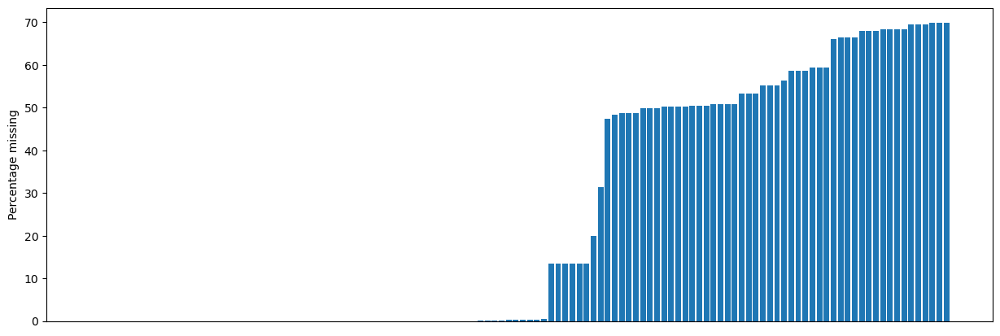

In [301]:
# Plotting Missing values count for each column
fig, ax = plt.subplots(figsize=(15,5))

missing = application_data.isna().sum().div(application_data.shape[0]).mul(100).to_frame().sort_values(by=0, ascending = True)
ax.bar(missing.index, missing.values.T[0])
plt.xticks([])
plt.ylabel("Percentage missing")
plt.show()


Drop columns which has more than 50% of missing values because we cannot go for filling these kind of columns because it might affect the final decision as our solutions are data driven.
We are also having outliers in our data sametime we are not removing any datapoints so it is better to impute the missing values with mode(),using mode() doesnot affect our decision.

In [302]:

dropcols = missing[missing[0]>50]
dropcols

,0
HOUSETYPE_MODE,50.176091
LIVINGAREA_AVG,50.193326
LIVINGAREA_MODE,50.193326
LIVINGAREA_MEDI,50.193326
ENTRANCES_AVG,50.348768
ENTRANCES_MODE,50.348768
ENTRANCES_MEDI,50.348768
APARTMENTS_MEDI,50.749729
APARTMENTS_AVG,50.749729
APARTMENTS_MODE,50.749729


In [303]:
application_data.drop(list(dropcols.index), axis=1, inplace=True)

In [304]:
df_app = application_data

In [305]:
df_app.shape

(307511, 81)

In [306]:
df_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


###  3.2.1 More irrelavant columns

In [307]:
colmis_less_50 = df_app.isna().sum().div(df_app.shape[0]).mul(100).to_frame().sort_values(by=0, ascending = True)
print(colmis_less_50)

                                      0
SK_ID_CURR                     0.000000
WEEKDAY_APPR_PROCESS_START     0.000000
HOUR_APPR_PROCESS_START        0.000000
REG_REGION_NOT_LIVE_REGION     0.000000
REG_REGION_NOT_WORK_REGION     0.000000
LIVE_REGION_NOT_WORK_REGION    0.000000
REG_CITY_NOT_LIVE_CITY         0.000000
REG_CITY_NOT_WORK_CITY         0.000000
LIVE_CITY_NOT_WORK_CITY        0.000000
ORGANIZATION_TYPE              0.000000
FLAG_DOCUMENT_19               0.000000
FLAG_DOCUMENT_18               0.000000
FLAG_DOCUMENT_17               0.000000
FLAG_DOCUMENT_16               0.000000
FLAG_DOCUMENT_15               0.000000
FLAG_DOCUMENT_14               0.000000
FLAG_DOCUMENT_13               0.000000
FLAG_DOCUMENT_12               0.000000
FLAG_DOCUMENT_11               0.000000
FLAG_DOCUMENT_10               0.000000
FLAG_DOCUMENT_9                0.000000
FLAG_DOCUMENT_8                0.000000
FLAG_DOCUMENT_7                0.000000
FLAG_DOCUMENT_6                0.000000


There are still more columns which is not related in target and majority of its data is irrelavent so remmoving those irrelavant data is good

In [308]:
# list of columns to be dropped
drop_columns = ['FLAG_CONT_MOBILE',
                'FLAG_MOBIL',
                'FLAG_EMP_PHONE',
                'FLAG_WORK_PHONE',
                'FLAG_PHONE',
                'FLAG_EMAIL',
                'HOUR_APPR_PROCESS_START',
                'WEEKDAY_APPR_PROCESS_START',
                'FLOORSMAX_AVG',
                'EXT_SOURCE_2',
                'EXT_SOURCE_3',
                'FLOORSMAX_AVG',
                'FLOORSMAX_MODE',
                'FLOORSMAX_MEDI',
                'TOTALAREA_MODE',
                'EMERGENCYSTATE_MODE',
                'REGION_POPULATION_RELATIVE',
                'YEARS_BEGINEXPLUATATION_AVG',
                'YEARS_BEGINEXPLUATATION_MEDI',
                'YEARS_BEGINEXPLUATATION_MODE',
                'REG_REGION_NOT_LIVE_REGION',
                'REG_REGION_NOT_WORK_REGION',
                'LIVE_REGION_NOT_WORK_REGION',
                'REG_CITY_NOT_LIVE_CITY',
                'REG_CITY_NOT_WORK_CITY',
                'LIVE_CITY_NOT_WORK_CITY',
                'FLAG_DOCUMENT_2',
                'FLAG_DOCUMENT_3',
                'FLAG_DOCUMENT_4',
                'FLAG_DOCUMENT_5',
                'FLAG_DOCUMENT_6',
                'FLAG_DOCUMENT_7',
                'FLAG_DOCUMENT_8',
                'FLAG_DOCUMENT_9',
                'FLAG_DOCUMENT_10',
                'FLAG_DOCUMENT_11',
                'FLAG_DOCUMENT_12',
                'FLAG_DOCUMENT_13',
                'FLAG_DOCUMENT_14',
                'FLAG_DOCUMENT_15',
                'FLAG_DOCUMENT_16',
                'FLAG_DOCUMENT_17',
                'FLAG_DOCUMENT_18',
                'FLAG_DOCUMENT_19',
                'FLAG_DOCUMENT_20',
                'FLAG_DOCUMENT_21'
               ]

In [309]:
app_data = df_app.drop(columns = drop_columns,axis=1)

In [310]:
app_data.shape

(307511, 36)

In [311]:
remaining_cols = app_data.isna().sum().div(application_data.shape[0]).mul(100).to_frame().sort_values(by=0, ascending = True)
print(remaining_cols)

                                     0
SK_ID_CURR                    0.000000
ORGANIZATION_TYPE             0.000000
REGION_RATING_CLIENT_W_CITY   0.000000
REGION_RATING_CLIENT          0.000000
DAYS_ID_PUBLISH               0.000000
DAYS_REGISTRATION             0.000000
DAYS_BIRTH                    0.000000
NAME_HOUSING_TYPE             0.000000
NAME_FAMILY_STATUS            0.000000
NAME_EDUCATION_TYPE           0.000000
NAME_INCOME_TYPE              0.000000
DAYS_EMPLOYED                 0.000000
NAME_CONTRACT_TYPE            0.000000
AMT_CREDIT                    0.000000
AMT_INCOME_TOTAL              0.000000
CNT_CHILDREN                  0.000000
FLAG_OWN_REALTY               0.000000
FLAG_OWN_CAR                  0.000000
TARGET                        0.000000
CODE_GENDER                   0.000000
DAYS_LAST_PHONE_CHANGE        0.000325
CNT_FAM_MEMBERS               0.000650
AMT_ANNUITY                   0.003902
AMT_GOODS_PRICE               0.090403
OBS_30_CNT_SOCIAL_CIRCLE 

## *3.3 Outliers Detection and performing imputation*



Decide whether to drop, fill, or impute missing values:
We could find there are outliers in some columns in which there are missing values.
we have calculated IQR values for those numeric columns and upper_IQR value is far different from max value of the same column.
so we can consider those max values as outlier because it is extended beyong Upper IQR values.
Now impute the null values with mode() because it is feasible and outlier doesnot affect our predictions



In [312]:
# list of all continuous numerical column
numerical_columns= ['AMT_GOODS_PRICE',
                    'DAYS_LAST_PHONE_CHANGE',
                    'DAYS_ID_PUBLISH',
                    'AMT_INCOME_TOTAL',
                    'DAYS_EMPLOYED',
                    'DAYS_REGISTRATION',
                    'DAYS_BIRTH',
                    'AMT_CREDIT',
                    'AMT_ANNUITY'
                   ]

<AxesSubplot:>

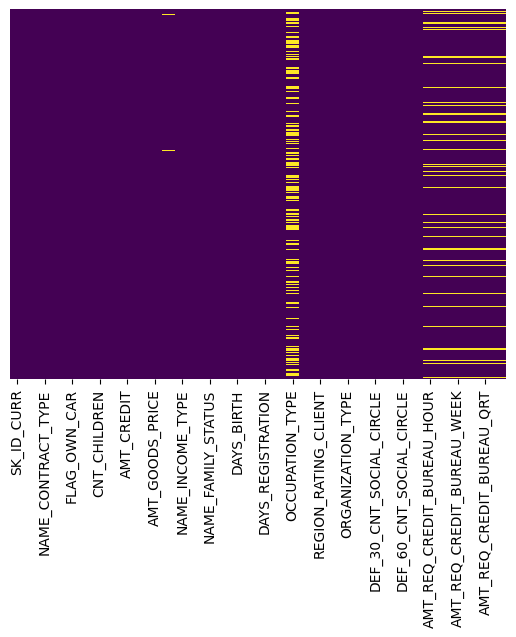

In [313]:
sns.heatmap(app_data.isnull(),yticklabels=False,cbar=False,cmap='viridis')

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_MON'>

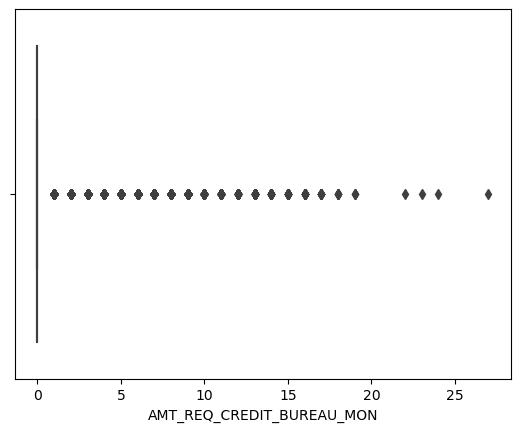

In [314]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_MON'])

In [315]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_MON = (app_data['AMT_REQ_CREDIT_BUREAU_MON']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_MON']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON = (app_data['AMT_REQ_CREDIT_BUREAU_MON']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_MON*1.5
lower_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON = (app_data['AMT_REQ_CREDIT_BUREAU_MON']).quantile(0.75) - IQR_AMT_REQ_CREDIT_BUREAU_MON*1.5

In [316]:
upper_outlier = (app_data['AMT_REQ_CREDIT_BUREAU_MON'].max()) - Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON
lower_outlier = (app_data['AMT_REQ_CREDIT_BUREAU_MON'].min()) - (lower_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON)
mean = app_data['AMT_REQ_CREDIT_BUREAU_MON'].mean()
print("upper value :",upper_outlier,"\n" ,"mean:", mean ,"\n","lower_value:", lower_outlier )


upper value : 27.0 
 mean: 0.26739526000781977 
 lower_value: 0.0


Value which is far different from mean is an outlier so in AMT_REQ_CREDIT_BUREAU_MON we have outlier

In [317]:
#Number of missing values in AMT_REQ_CREDIT_BUREAU_MON
app_data['AMT_REQ_CREDIT_BUREAU_MON'].isnull().sum()

41519

Imputing all these 41519 values with mode is feasible because we are having outlier

In [318]:
app_data['AMT_REQ_CREDIT_BUREAU_MON'] = app_data['AMT_REQ_CREDIT_BUREAU_MON'].fillna(app_data['AMT_REQ_CREDIT_BUREAU_MON'].mode)

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_WEEK'>

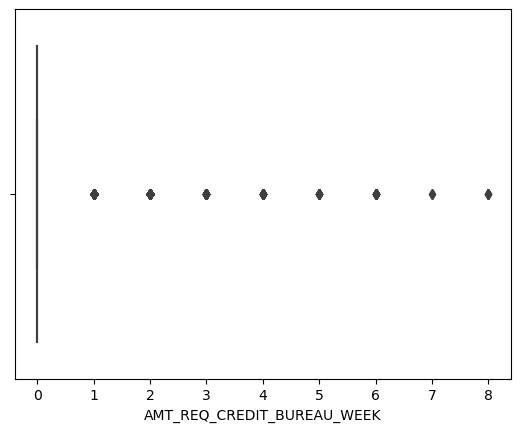

In [319]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_WEEK'])

In [320]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_WEEK = (app_data['AMT_REQ_CREDIT_BUREAU_WEEK']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_WEEK']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_WEEK = (app_data['AMT_REQ_CREDIT_BUREAU_WEEK']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_WEEK*1.5
lower_limit_IQR_AMT_REQ_CREDIT_BUREAU_WEEK = (app_data['AMT_REQ_CREDIT_BUREAU_WEEK']).quantile(0.75) - IQR_AMT_REQ_CREDIT_BUREAU_WEEK*1.5

In [321]:
upper_outlier = (app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].max()) - Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON
lower_outlier = (app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].min()) - (lower_limit_IQR_AMT_REQ_CREDIT_BUREAU_MON)
mean = app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].mean()
print("upper value :",upper_outlier,"\n" ,"mean:", mean ,"\n","lower_value:", lower_outlier )

upper value : 8.0 
 mean: 0.0343619356973142 
 lower_value: 0.0


In [322]:
#Number of missing values in AMT_REQ_CREDIT_BUREAU_MON
app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].isnull().sum()

41519

we find suspected outlier in AMT_REQ_CREDIT_BUREAU_WEEK so we can impute the respective column with mode

In [323]:
app_data['AMT_REQ_CREDIT_BUREAU_WEEK'] = app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].fillna(app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].mode)

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_DAY'>

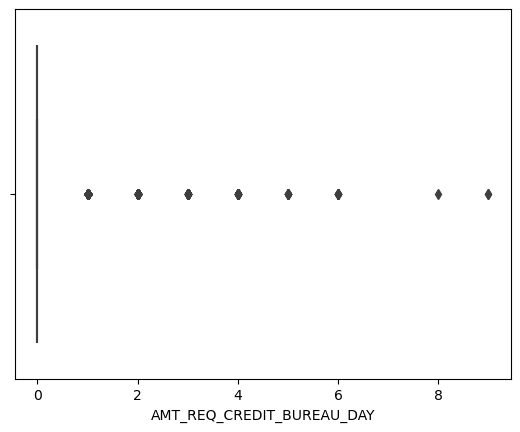

In [324]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_DAY'])

In [325]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_DAY = (app_data['AMT_REQ_CREDIT_BUREAU_DAY']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_DAY']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_DAY = (app_data['AMT_REQ_CREDIT_BUREAU_DAY']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_DAY*1.5
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_DAY

0.0

In [326]:
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].isnull().sum()

41519

In [327]:
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].describe()

count    265992.000000
mean          0.007000
std           0.110757
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           9.000000
Name: AMT_REQ_CREDIT_BUREAU_DAY, dtype: float64

we find suspected outlier in AMT_REQ_CREDIT_BUREAU_DAY so we can impute the respective column with mode

In [328]:
app_data['AMT_REQ_CREDIT_BUREAU_DAY'] = app_data['AMT_REQ_CREDIT_BUREAU_DAY'].fillna(app_data['AMT_REQ_CREDIT_BUREAU_DAY'].mode)

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_HOUR'>

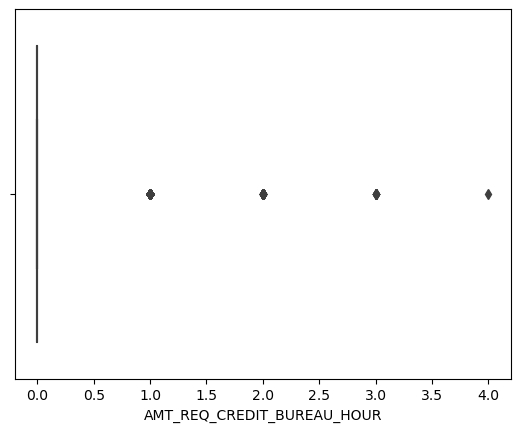

In [329]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_HOUR'])

In [330]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_HOUR = (app_data['AMT_REQ_CREDIT_BUREAU_HOUR']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_HOUR']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_HOUR = (app_data['AMT_REQ_CREDIT_BUREAU_HOUR']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_HOUR*1.5
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_HOUR

0.0

In [331]:
app_data['AMT_REQ_CREDIT_BUREAU_HOUR'].isnull().sum()

41519

In [332]:
app_data['AMT_REQ_CREDIT_BUREAU_HOUR'].describe()

count    265992.000000
mean          0.006402
std           0.083849
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           4.000000
Name: AMT_REQ_CREDIT_BUREAU_HOUR, dtype: float64

we find suspected outlier in AMT_REQ_CREDIT_BUREAU_HOUR so we can impute the respective column with mode

In [333]:
app_data['AMT_REQ_CREDIT_BUREAU_HOUR'] = app_data['AMT_REQ_CREDIT_BUREAU_HOUR'].fillna(app_data['AMT_REQ_CREDIT_BUREAU_HOUR'].mode)

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_QRT'>

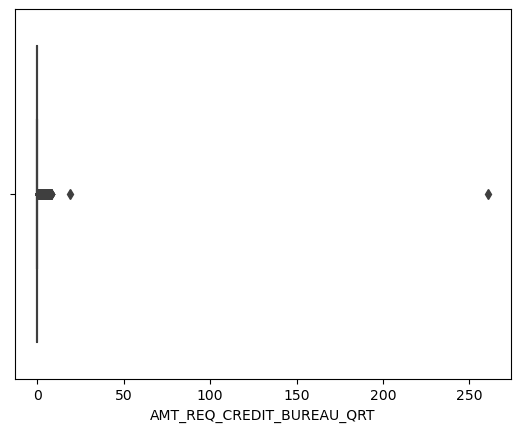

In [334]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_QRT'])

In [335]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_QRT = (app_data['AMT_REQ_CREDIT_BUREAU_QRT']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_QRT']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_QRT = (app_data['AMT_REQ_CREDIT_BUREAU_QRT']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_QRT*1.5
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_QRT

0.0

In [336]:
app_data['AMT_REQ_CREDIT_BUREAU_QRT'].isnull().sum()

41519

In [337]:
app_data['AMT_REQ_CREDIT_BUREAU_QRT'].describe()

count    265992.000000
mean          0.265474
std           0.794056
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         261.000000
Name: AMT_REQ_CREDIT_BUREAU_QRT, dtype: float64

we find suspected outlier in AMT_REQ_CREDIT_BUREAU_QRT so we can impute the respective column with mode

In [338]:
app_data['AMT_REQ_CREDIT_BUREAU_QRT'] = app_data['AMT_REQ_CREDIT_BUREAU_QRT'].fillna( app_data['AMT_REQ_CREDIT_BUREAU_QRT'].mode)

<AxesSubplot:xlabel='AMT_REQ_CREDIT_BUREAU_YEAR'>

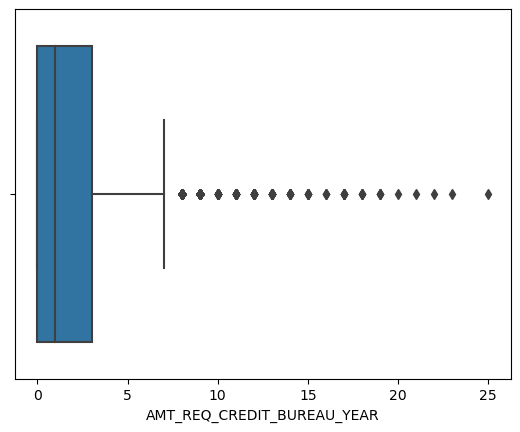

In [339]:
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_YEAR'])

In [340]:
# finding suspected outlier
IQR_AMT_REQ_CREDIT_BUREAU_YEAR = (app_data['AMT_REQ_CREDIT_BUREAU_YEAR']).quantile(0.75) - (app_data['AMT_REQ_CREDIT_BUREAU_YEAR']).quantile(0.25)
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_YEAR = (app_data['AMT_REQ_CREDIT_BUREAU_YEAR']).quantile(0.75) + IQR_AMT_REQ_CREDIT_BUREAU_YEAR*1.5
Upper_limit_IQR_AMT_REQ_CREDIT_BUREAU_YEAR

7.5

In [341]:
app_data['AMT_REQ_CREDIT_BUREAU_YEAR'].isnull().sum()

41519

In [342]:
app_data['AMT_REQ_CREDIT_BUREAU_YEAR'].describe()

count    265992.000000
mean          1.899974
std           1.869295
min           0.000000
25%           0.000000
50%           1.000000
75%           3.000000
max          25.000000
Name: AMT_REQ_CREDIT_BUREAU_YEAR, dtype: float64

We find suspected outlier in AMT_REQ_CREDIT_BUREAU_YEAR BUt we can impute the respective column with mode

In [343]:
app_data['AMT_REQ_CREDIT_BUREAU_YEAR'] = app_data['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(app_data['AMT_REQ_CREDIT_BUREAU_YEAR'].mode)

<AxesSubplot:>

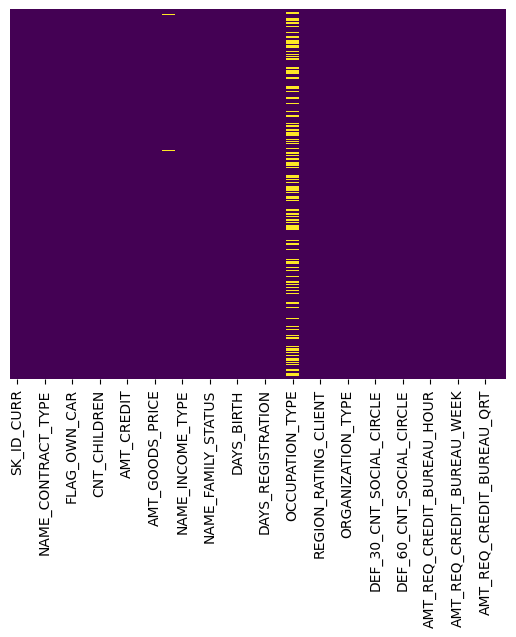

In [344]:
sns.heatmap(app_data.isnull(),yticklabels=False,cbar=False,cmap='viridis')

we have performed imputation in the following columns with the respective column's
maximum percentage of data value i.e., '0'
AMT_REQ_CREDIT_BUREAU_MON

AMT_REQ_CREDIT_BUREAU_WEEK

AMT_REQ_CREDIT_BUREAU_DAY

AMT_REQ_CREDIT_BUREAU_HOUR

AMT_REQ_CREDIT_BUREAU_QRT

AMT_REQ_CREDIT_BUREAU_YEAR

now we require to do the same imputation method on 'OCCUPATION TYPE'

In [345]:
app_data['OCCUPATION_TYPE'].describe

<bound method NDFrame.describe of 0            Laborers
1          Core staff
2            Laborers
3            Laborers
4          Core staff
             ...     
307506    Sales staff
307507            NaN
307508       Managers
307509       Laborers
307510       Laborers
Name: OCCUPATION_TYPE, Length: 307511, dtype: object>

In [346]:
app_data['OCCUPATION_TYPE'].unique()

array(['Laborers', 'Core staff', 'Accountants', 'Managers', nan,
       'Drivers', 'Sales staff', 'Cleaning staff', 'Cooking staff',
       'Private service staff', 'Medicine staff', 'Security staff',
       'High skill tech staff', 'Waiters/barmen staff',
       'Low-skill Laborers', 'Realty agents', 'Secretaries', 'IT staff',
       'HR staff'], dtype=object)

In [347]:
app_data['OCCUPATION_TYPE'].isnull().sum()

96391

<AxesSubplot:xlabel='OCCUPATION_TYPE', ylabel='count'>

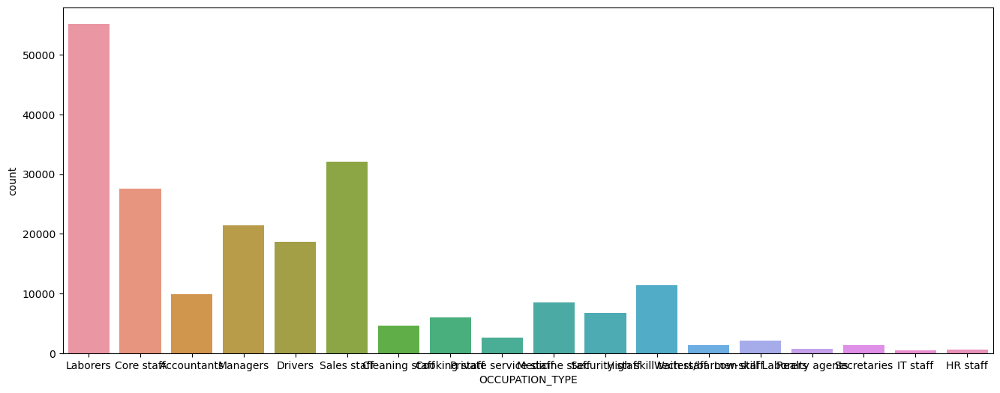

In [348]:
plt.figure(figsize=(16, 6))
sns.countplot(data = app_data,x='OCCUPATION_TYPE')

In [349]:
app_data['OCCUPATION_TYPE'] = app_data['OCCUPATION_TYPE'].fillna("unknown")

In [350]:
app_data.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
FLAG_OWN_REALTY                   0
CNT_CHILDREN                      0
AMT_INCOME_TOTAL                  0
AMT_CREDIT                        0
AMT_ANNUITY                      12
AMT_GOODS_PRICE                 278
NAME_TYPE_SUITE                1292
NAME_INCOME_TYPE                  0
NAME_EDUCATION_TYPE               0
NAME_FAMILY_STATUS                0
NAME_HOUSING_TYPE                 0
DAYS_BIRTH                        0
DAYS_EMPLOYED                     0
DAYS_REGISTRATION                 0
DAYS_ID_PUBLISH                   0
OCCUPATION_TYPE                   0
CNT_FAM_MEMBERS                   2
REGION_RATING_CLIENT              0
REGION_RATING_CLIENT_W_CITY       0
ORGANIZATION_TYPE                 0
OBS_30_CNT_SOCIAL_CIRCLE       1021
DEF_30_CNT_SOCIAL_CIRCLE       1021
OBS_60_CNT_SOCIAL_CIRCLE    

still we have these columns remaining missing values

AMT_ANNUITY                      12

AMT_GOODS_PRICE                 278

NAME_TYPE_SUITE                1292

CNT_FAM_MEMBERS                   2

OBS_30_CNT_SOCIAL_CIRCLE       1021

DEF_30_CNT_SOCIAL_CIRCLE       1021

OBS_60_CNT_SOCIAL_CIRCLE       1021

DEF_60_CNT_SOCIAL_CIRCLE       1021

DAYS_LAST_PHONE_CHANGE            1

<AxesSubplot:xlabel='AMT_ANNUITY'>

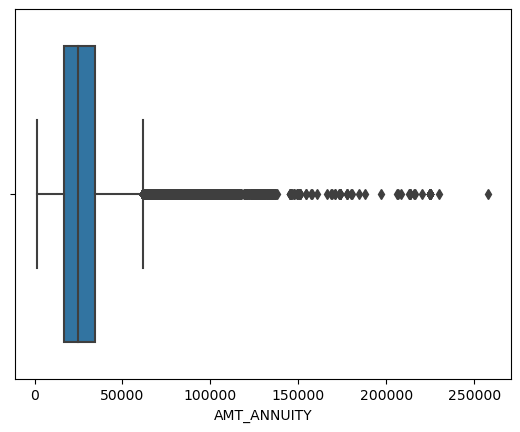

In [351]:
sns.boxplot(app_data['AMT_ANNUITY'])

In [352]:
# finding suspected outlier
IQR_AMT_ANNUITY = (app_data['AMT_ANNUITY']).quantile(0.75) - (app_data['AMT_ANNUITY']).quantile(0.25)
Upper_limit_IQR_AMT_ANNUITY = (app_data['AMT_ANNUITY']).quantile(0.75) + IQR_AMT_ANNUITY*1.5
Upper_limit_IQR_AMT_ANNUITY

61704.0

In [353]:
app_data['AMT_ANNUITY'].describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

In [354]:
app_data['AMT_ANNUITY'].isnull().sum()

12

In [355]:
app_data['AMT_ANNUITY'] = app_data['AMT_ANNUITY'].fillna(app_data['AMT_ANNUITY'].mode)

<AxesSubplot:xlabel='AMT_GOODS_PRICE'>

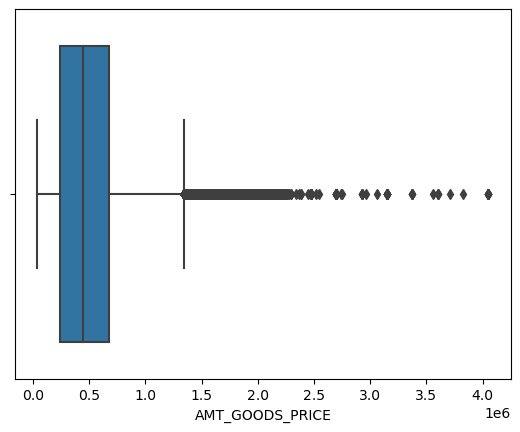

In [356]:
sns.boxplot(app_data['AMT_GOODS_PRICE'])

In [357]:
# finding suspected outlier
IQR_AMT_GOODS_PRICE= (app_data['AMT_GOODS_PRICE']).quantile(0.75) - (app_data['AMT_GOODS_PRICE']).quantile(0.25)
Upper_limit_IQR_AMT_GOODS_PRICE = (app_data['AMT_GOODS_PRICE']).quantile(0.75) + IQR_AMT_GOODS_PRICE*1.5
Upper_limit_IQR_AMT_GOODS_PRICE

1341000.0

In [358]:
app_data['AMT_GOODS_PRICE'].describe()

count    3.072330e+05
mean     5.383962e+05
std      3.694465e+05
min      4.050000e+04
25%      2.385000e+05
50%      4.500000e+05
75%      6.795000e+05
max      4.050000e+06
Name: AMT_GOODS_PRICE, dtype: float64

In [359]:
app_data['AMT_GOODS_PRICE'].isnull().sum()

278

In [360]:
app_data['AMT_GOODS_PRICE'] = app_data['AMT_GOODS_PRICE'].fillna(app_data['AMT_GOODS_PRICE'].mode)

<AxesSubplot:xlabel='NAME_TYPE_SUITE', ylabel='count'>

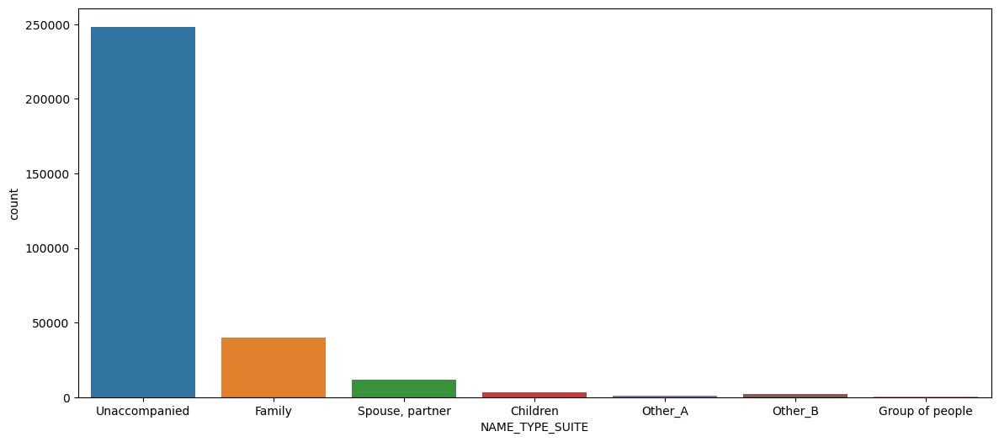

In [361]:
plt.figure(figsize=(14, 6))
sns.countplot(data = app_data,x='NAME_TYPE_SUITE')

In [362]:
# # finding suspected outlier
# IQR_NAME_TYPE_SUITE= (application_data['NAME_TYPE_SUITE']).quantile(0.75) - (application_data['NAME_TYPE_SUITE']).quantile(0.25)
# Upper_limit_IQR_NAME_TYPE_SUITE = (application_data['NAME_TYPE_SUITE']).quantile(0.75) + IQR_NAME_TYPE_SUITE*1.5
# Upper_limit_IQR_NAME_TYPE_SUITE

In [363]:
app_data['NAME_TYPE_SUITE'].unique()

array(['Unaccompanied', 'Family', 'Spouse, partner', 'Children',
       'Other_A', nan, 'Other_B', 'Group of people'], dtype=object)

In [364]:
app_data['NAME_TYPE_SUITE']= app_data['NAME_TYPE_SUITE'].replace('Unaccompanied','Single')
app_data['NAME_TYPE_SUITE']= app_data['NAME_TYPE_SUITE'].replace('Spouse, partner','Partner')

In [365]:
app_data['NAME_TYPE_SUITE'].describe()

count     306219
unique         7
top       Single
freq      248526
Name: NAME_TYPE_SUITE, dtype: object

In [366]:
app_data['NAME_TYPE_SUITE'].isnull().sum()

1292

In [367]:
app_data['NAME_TYPE_SUITE'] = app_data['NAME_TYPE_SUITE'].fillna(app_data['NAME_TYPE_SUITE'].mode)

<AxesSubplot:xlabel='CNT_FAM_MEMBERS'>

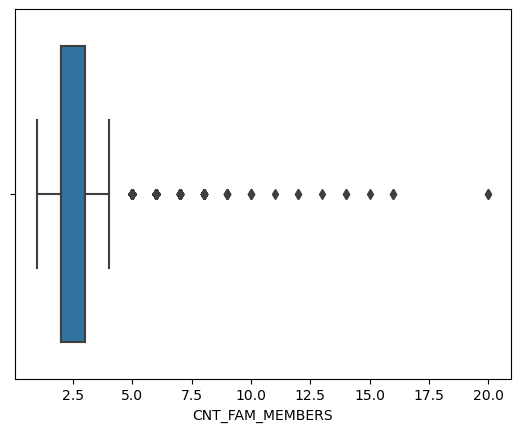

In [368]:
sns.boxplot(app_data['CNT_FAM_MEMBERS'])

In [369]:
# finding suspected outlier
IQR_CNT_FAM_MEMBERS= (app_data['CNT_FAM_MEMBERS']).quantile(0.75) - (app_data['CNT_FAM_MEMBERS']).quantile(0.25)
Upper_limit_IQR_CNT_FAM_MEMBERS = (app_data['CNT_FAM_MEMBERS']).quantile(0.75) + IQR_CNT_FAM_MEMBERS*1.5
Upper_limit_IQR_CNT_FAM_MEMBERS

4.5

In [370]:
app_data['CNT_FAM_MEMBERS'].describe()

count    307509.000000
mean          2.152665
std           0.910682
min           1.000000
25%           2.000000
50%           2.000000
75%           3.000000
max          20.000000
Name: CNT_FAM_MEMBERS, dtype: float64

In [371]:
application_data['CNT_FAM_MEMBERS'].isnull().sum()

2

In [372]:
app_data['CNT_FAM_MEMBERS'] = app_data['CNT_FAM_MEMBERS'].fillna(app_data['CNT_FAM_MEMBERS'].mode)

<AxesSubplot:xlabel='OBS_30_CNT_SOCIAL_CIRCLE'>

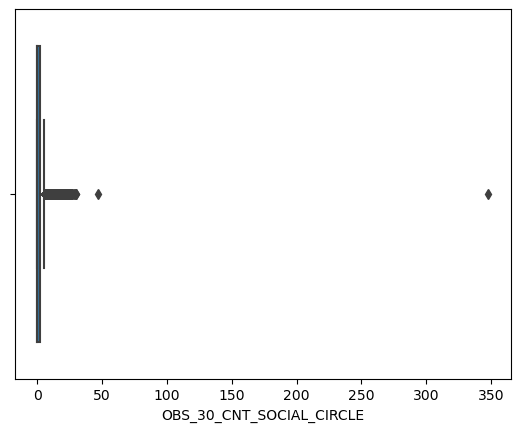

In [373]:
sns.boxplot(app_data['OBS_30_CNT_SOCIAL_CIRCLE'])

In [374]:
# finding suspected outlier
IQR_OBS_30_CNT_SOCIAL_CIRCLE= (app_data['OBS_30_CNT_SOCIAL_CIRCLE']).quantile(0.75) - (app_data['OBS_30_CNT_SOCIAL_CIRCLE']).quantile(0.25)
Upper_limit_IQR_OBS_30_CNT_SOCIAL_CIRCLE = (app_data['OBS_30_CNT_SOCIAL_CIRCLE']).quantile(0.75) + IQR_OBS_30_CNT_SOCIAL_CIRCLE*1.5
Upper_limit_IQR_OBS_30_CNT_SOCIAL_CIRCLE

5.0

In [375]:
app_data['OBS_30_CNT_SOCIAL_CIRCLE'].describe()

count    306490.000000
mean          1.422245
std           2.400989
min           0.000000
25%           0.000000
50%           0.000000
75%           2.000000
max         348.000000
Name: OBS_30_CNT_SOCIAL_CIRCLE, dtype: float64

In [376]:
app_data['OBS_30_CNT_SOCIAL_CIRCLE'].isnull().sum()

1021

In [377]:
app_data['OBS_30_CNT_SOCIAL_CIRCLE'] = app_data['OBS_30_CNT_SOCIAL_CIRCLE'].fillna(app_data['OBS_30_CNT_SOCIAL_CIRCLE'].mode)

<AxesSubplot:xlabel='DEF_30_CNT_SOCIAL_CIRCLE'>

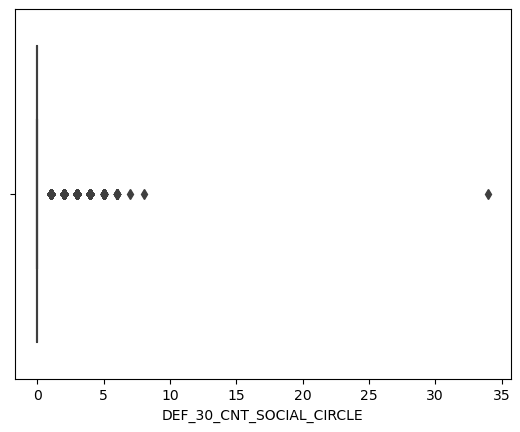

In [378]:
sns.boxplot(app_data['DEF_30_CNT_SOCIAL_CIRCLE'])

In [379]:
# finding suspected outlier
IQR_DEF_30_CNT_SOCIAL_CIRCLE = (app_data['DEF_30_CNT_SOCIAL_CIRCLE']).quantile(0.75) - (app_data['DEF_30_CNT_SOCIAL_CIRCLE']).quantile(0.25)
Upper_limit_IQR_DEF_30_CNT_SOCIAL_CIRCLE = (app_data['DEF_30_CNT_SOCIAL_CIRCLE']).quantile(0.75) + IQR_DEF_30_CNT_SOCIAL_CIRCLE*1.5
Upper_limit_IQR_DEF_30_CNT_SOCIAL_CIRCLE

0.0

In [380]:
app_data['DEF_30_CNT_SOCIAL_CIRCLE'].describe()

count    306490.000000
mean          0.143421
std           0.446698
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          34.000000
Name: DEF_30_CNT_SOCIAL_CIRCLE, dtype: float64

In [381]:
app_data['DEF_30_CNT_SOCIAL_CIRCLE'].isnull().sum()

1021

In [382]:
app_data['DEF_30_CNT_SOCIAL_CIRCLE'] = app_data['DEF_30_CNT_SOCIAL_CIRCLE'].fillna(app_data['DEF_30_CNT_SOCIAL_CIRCLE'].mode)

<AxesSubplot:xlabel='OBS_60_CNT_SOCIAL_CIRCLE'>

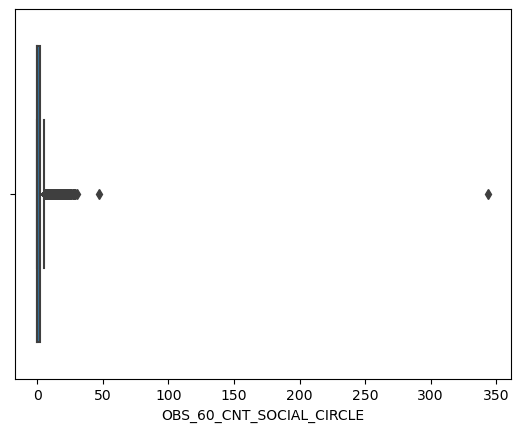

In [383]:
sns.boxplot(app_data['OBS_60_CNT_SOCIAL_CIRCLE'])

In [384]:
# finding suspected outlier
IQR_OBS_60_CNT_SOCIAL_CIRCLE= (app_data['OBS_60_CNT_SOCIAL_CIRCLE']).quantile(0.75) - (app_data['OBS_60_CNT_SOCIAL_CIRCLE']).quantile(0.25)
Upper_limit_IQR_OBS_60_CNT_SOCIAL_CIRCLE = (app_data['OBS_60_CNT_SOCIAL_CIRCLE']).quantile(0.75) + IQR_OBS_60_CNT_SOCIAL_CIRCLE*1.5
Upper_limit_IQR_OBS_60_CNT_SOCIAL_CIRCLE

5.0

In [385]:
app_data['OBS_60_CNT_SOCIAL_CIRCLE'].describe()

count    306490.000000
mean          1.405292
std           2.379803
min           0.000000
25%           0.000000
50%           0.000000
75%           2.000000
max         344.000000
Name: OBS_60_CNT_SOCIAL_CIRCLE, dtype: float64

In [386]:
app_data['OBS_60_CNT_SOCIAL_CIRCLE'].isnull().sum()

1021

In [387]:
app_data['OBS_60_CNT_SOCIAL_CIRCLE'] = app_data['OBS_60_CNT_SOCIAL_CIRCLE'].fillna(app_data['OBS_60_CNT_SOCIAL_CIRCLE'].mode)

<AxesSubplot:xlabel='DEF_60_CNT_SOCIAL_CIRCLE'>

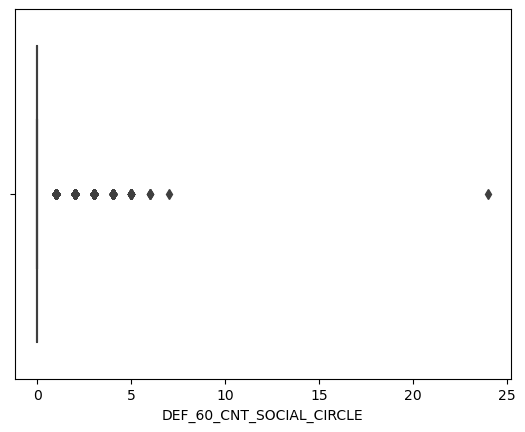

In [388]:
sns.boxplot(app_data['DEF_60_CNT_SOCIAL_CIRCLE'])

In [389]:
# finding suspected outlier
IQR_DEF_60_CNT_SOCIAL_CIRCLE= (app_data['DEF_60_CNT_SOCIAL_CIRCLE']).quantile(0.75) - (app_data['DEF_60_CNT_SOCIAL_CIRCLE']).quantile(0.25)
Upper_limit_IQR_DEF_60_CNT_SOCIAL_CIRCLE = (app_data['DEF_60_CNT_SOCIAL_CIRCLE']).quantile(0.75) + IQR_DEF_60_CNT_SOCIAL_CIRCLE*1.5
Upper_limit_IQR_DEF_60_CNT_SOCIAL_CIRCLE

0.0

In [390]:
app_data['DEF_60_CNT_SOCIAL_CIRCLE'].describe()

count    306490.000000
mean          0.100049
std           0.362291
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          24.000000
Name: DEF_60_CNT_SOCIAL_CIRCLE, dtype: float64

In [391]:
app_data['DEF_60_CNT_SOCIAL_CIRCLE'].isnull().sum()

1021

In [392]:
app_data['DEF_60_CNT_SOCIAL_CIRCLE'] = app_data['DEF_60_CNT_SOCIAL_CIRCLE'].fillna(app_data['DEF_60_CNT_SOCIAL_CIRCLE'].mode)

<AxesSubplot:xlabel='DAYS_LAST_PHONE_CHANGE'>

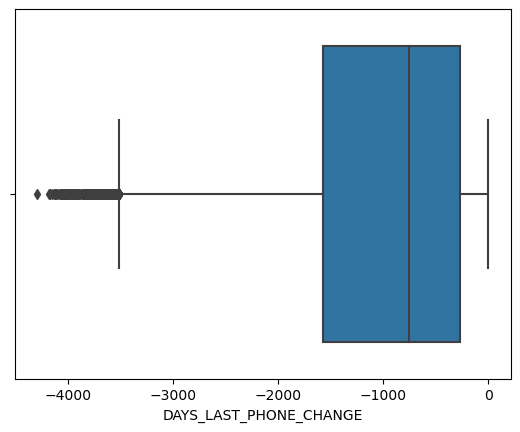

In [393]:
sns.boxplot(app_data['DAYS_LAST_PHONE_CHANGE'])

In [394]:
# finding suspected outlier
IQR_DAYS_LAST_PHONE_CHANGE= (app_data['DAYS_LAST_PHONE_CHANGE']).quantile(0.75) - (app_data['DAYS_LAST_PHONE_CHANGE']).quantile(0.25)
lower_limit_IQR_DAYS_LAST_PHONE_CHANGE = IQR_DAYS_LAST_PHONE_CHANGE*1.5 - (app_data['DAYS_LAST_PHONE_CHANGE']).quantile(0.75)
lower_limit_IQR_DAYS_LAST_PHONE_CHANGE

2218.0

In [395]:
app_data['DAYS_LAST_PHONE_CHANGE'].describe()

count    307510.000000
mean       -962.858788
std         826.808487
min       -4292.000000
25%       -1570.000000
50%        -757.000000
75%        -274.000000
max           0.000000
Name: DAYS_LAST_PHONE_CHANGE, dtype: float64

In [396]:
app_data['DAYS_LAST_PHONE_CHANGE'].isnull().sum()

1

In [397]:
app_data['DAYS_LAST_PHONE_CHANGE'] = app_data['DAYS_LAST_PHONE_CHANGE'].fillna(app_data['DAYS_LAST_PHONE_CHANGE'].mode)

In [398]:
app_data.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
ORGANIZATION_TYPE              0
OBS_30_CNT_SOCIAL_CIRCLE       0
DEF_30_CNT_SOCIAL_CIRCLE       0
OBS_60_CNT_SOCIAL_CIRCLE       0
DEF_60_CNT_SOCIAL_CIRCLE       0
DAYS_LAST_PHONE_CHANGE         0
AMT_REQ_CR

## *3.4 Checking imbalance in data*

### *Target Variable Analysis*

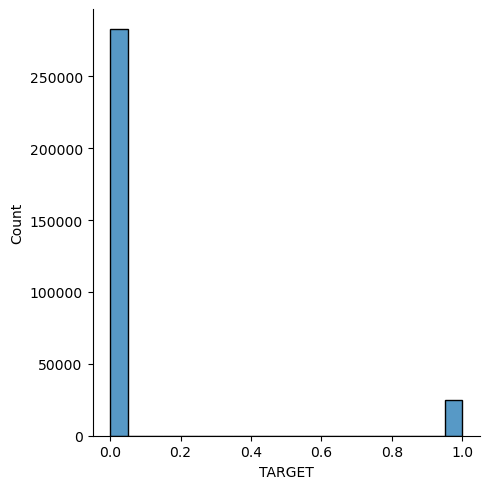

In [399]:
sns.displot(app_data['TARGET'])
# 0    282686
# 1     24825

<AxesSubplot:xlabel='TARGET', ylabel='Density'>

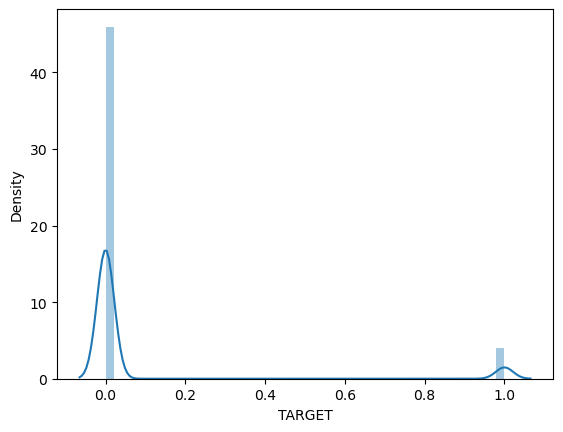

In [400]:
sns.distplot(app_data['TARGET'])

In [401]:
app_data['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

In [402]:
# Finding % of people with outstanding dues and no outstanding dues.
# 0    282686
# 1     24825

# Finding % of people with outstanding dues and no outstanding dues.

target_0_percentage = (round (len(app_data.query('TARGET==0'))/len(app_data),4)) * 100
print ("Target_0_percentage:", target_0_percentage,"%")

target_1_percentage = (round (len(app_data.query('TARGET==1'))/len(app_data),4)) * 100
print ("Target_1_percentage:", target_1_percentage,"%")

Target_0_percentage: 91.93 %
Target_1_percentage: 8.07 %


As the percentage of Target =0 and Target =1 are different, there is an imbalance

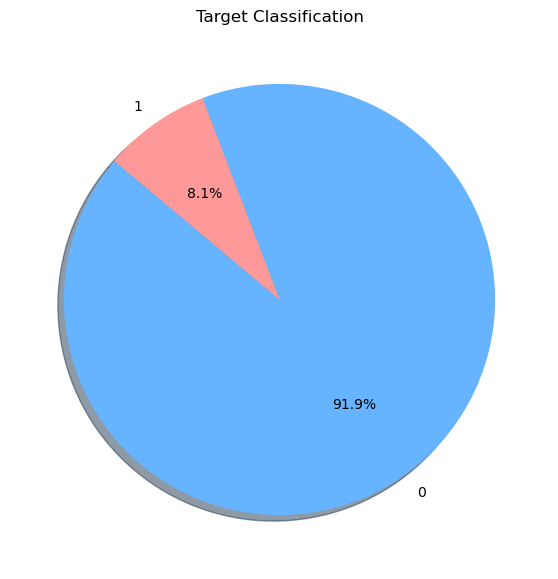

In [403]:
# target = application_data.TARGET.values
# target
labels = ['0', '1']

# Example data for two-class classification in percentages
labels = ['0', '1']
sizes = [target_0_percentage, target_1_percentage]  # Percentages for each class
colors = ['#66b3ff', '#ff9999']  # Optional: custom colors for the classes


plt.figure(figsize=(7, 7))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Target Classification')
plt.show()


In [404]:
# Creating Dataframe of the non-defaulters
target_0 = app_data.query('TARGET== 0')

# Creating Dataframe of the defaulters that is clients with payment difficulties
target_1 = app_data.query('TARGET== 1')

In [405]:
target_1.shape

(24825, 36)

In [406]:
target_0.shape

(282686, 36)

In [407]:
# Cheking column types
app_data.dtypes

SK_ID_CURR                       int64
TARGET                           int64
NAME_CONTRACT_TYPE              object
CODE_GENDER                     object
FLAG_OWN_CAR                    object
FLAG_OWN_REALTY                 object
CNT_CHILDREN                     int64
AMT_INCOME_TOTAL               float64
AMT_CREDIT                     float64
AMT_ANNUITY                     object
AMT_GOODS_PRICE                 object
NAME_TYPE_SUITE                 object
NAME_INCOME_TYPE                object
NAME_EDUCATION_TYPE             object
NAME_FAMILY_STATUS              object
NAME_HOUSING_TYPE               object
DAYS_BIRTH                       int64
DAYS_EMPLOYED                    int64
DAYS_REGISTRATION              float64
DAYS_ID_PUBLISH                  int64
OCCUPATION_TYPE                 object
CNT_FAM_MEMBERS                 object
REGION_RATING_CLIENT             int64
REGION_RATING_CLIENT_W_CITY      int64
ORGANIZATION_TYPE               object
OBS_30_CNT_SOCIAL_CIRCLE 

# **4.Univariate analysis**

## *4.1 Categorical Variables*

Column which is of object type is considered categorical

In [408]:
#list of all categorical columns
categorical_columns = ['NAME_CONTRACT_TYPE',
                       'FLAG_OWN_CAR',
                       'FLAG_OWN_REALTY',
                       'CODE_GENDER',
                       'NAME_EDUCATION_TYPE',

                       'NAME_FAMILY_STATUS',
                       'NAME_HOUSING_TYPE',
                       'NAME_TYPE_SUITE',
                       'NAME_INCOME_TYPE',
                       'OCCUPATION_TYPE',
                       'ORGANIZATION_TYPE',
                       'REGION_RATING_CLIENT_W_CITY',
                       'REGION_RATING_CLIENT',
                       'AMT_REQ_CREDIT_BUREAU_HOUR',
                       'DEF_60_CNT_SOCIAL_CIRCLE',
                       'AMT_REQ_CREDIT_BUREAU_WEEK',
                       'AMT_REQ_CREDIT_BUREAU_DAY',
                       'DEF_30_CNT_SOCIAL_CIRCLE',
                       'AMT_REQ_CREDIT_BUREAU_QRT',
                       'CNT_CHILDREN',
                       'CNT_FAM_MEMBERS',
                       'AMT_REQ_CREDIT_BUREAU_MON',
                       'AMT_REQ_CREDIT_BUREAU_YEAR',
                       'OBS_30_CNT_SOCIAL_CIRCLE',
                       'OBS_60_CNT_SOCIAL_CIRCLE',
                      ]

In [409]:
# list of all continuous numerical column
numerical_columns= ['AMT_GOODS_PRICE',
                    'DAYS_LAST_PHONE_CHANGE',
                    'DAYS_ID_PUBLISH',
                    'AMT_INCOME_TOTAL',
                    'DAYS_EMPLOYED',
                    'DAYS_REGISTRATION',
                    'DAYS_BIRTH',
                    'AMT_CREDIT',
                    'AMT_ANNUITY'
                   ]

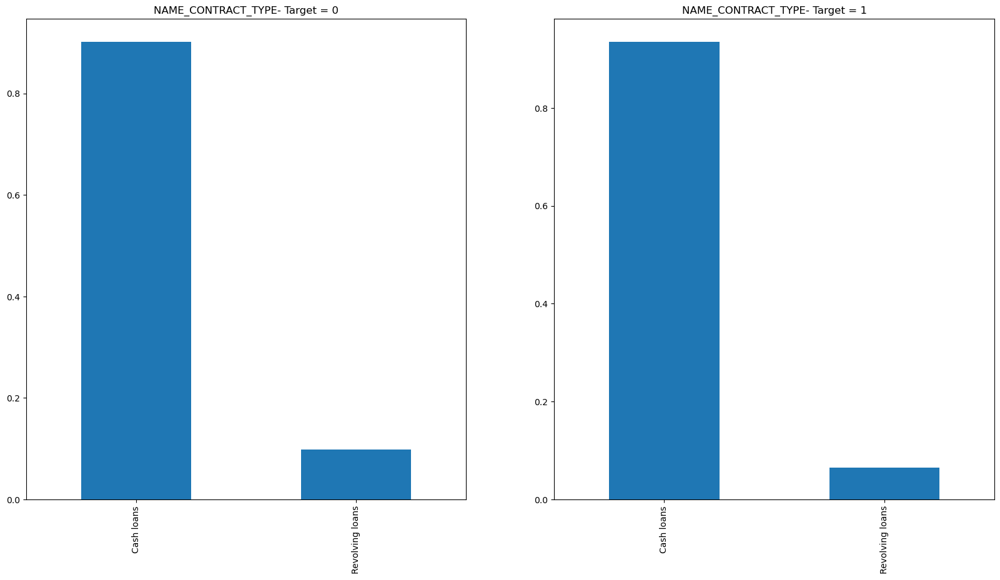

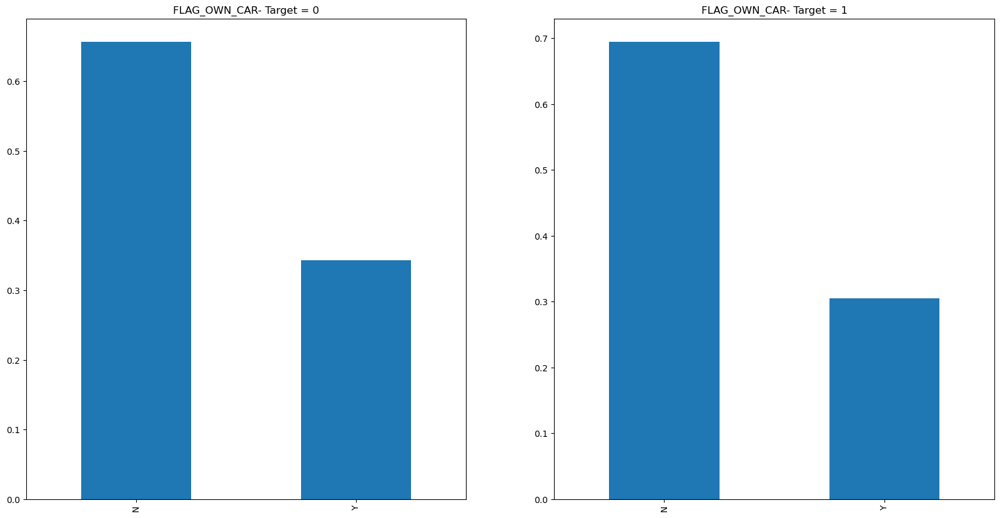

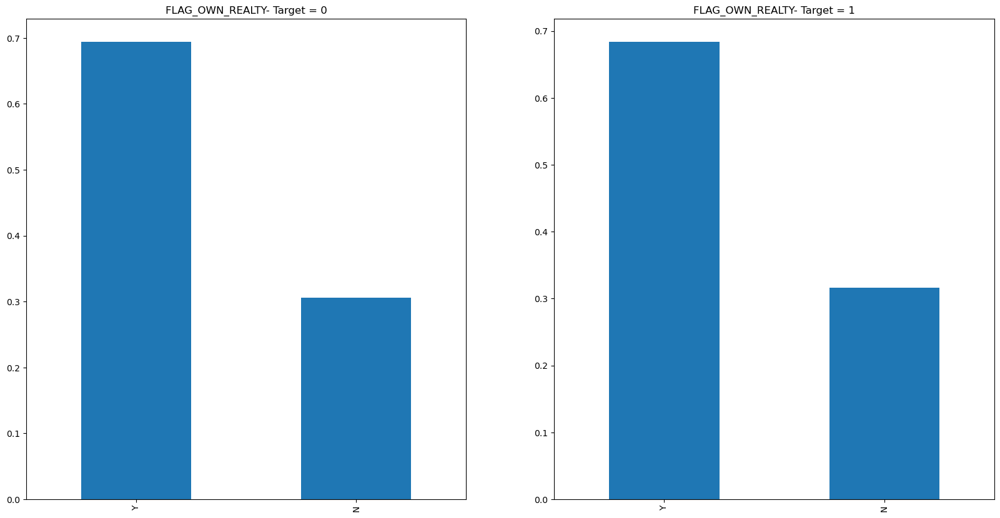

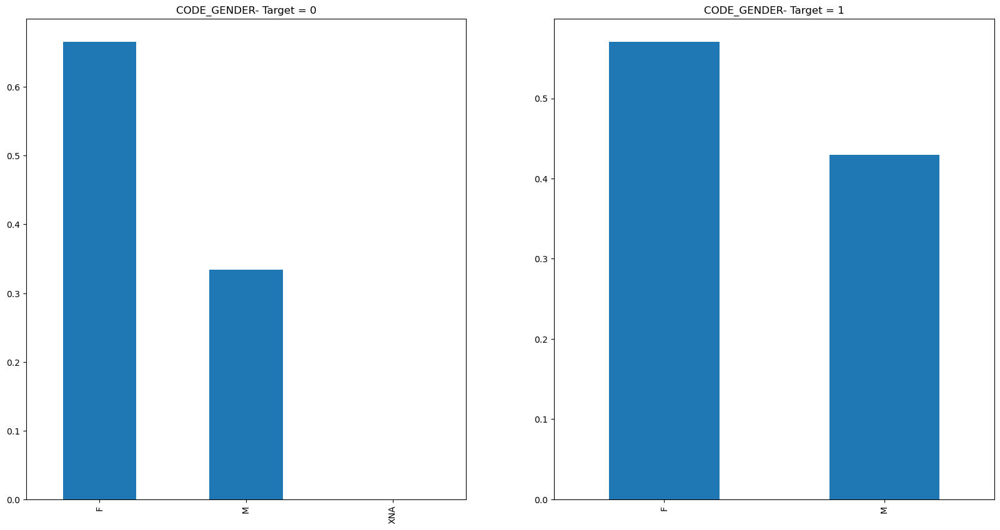

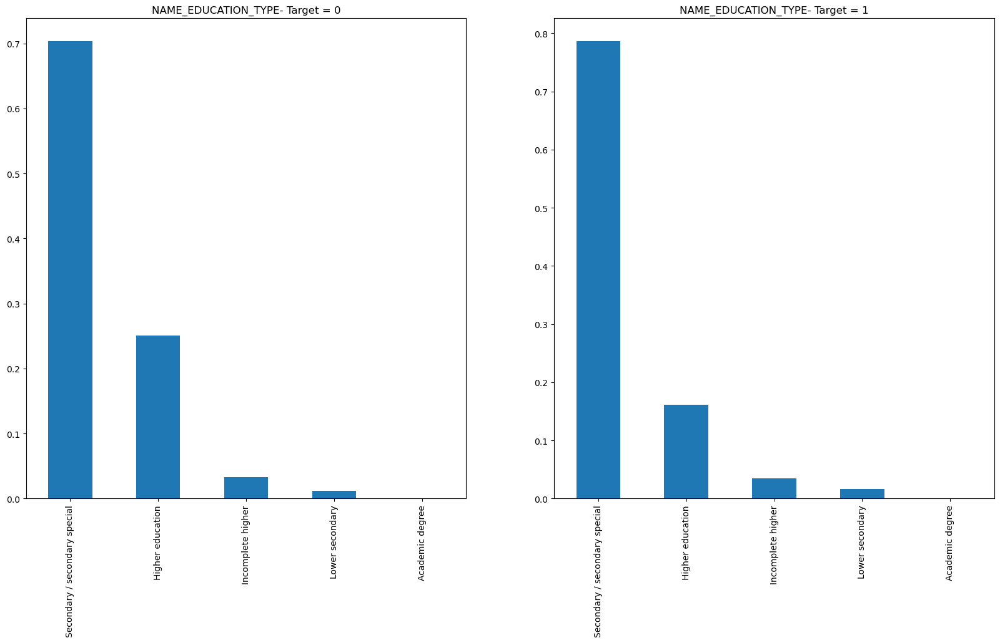

...

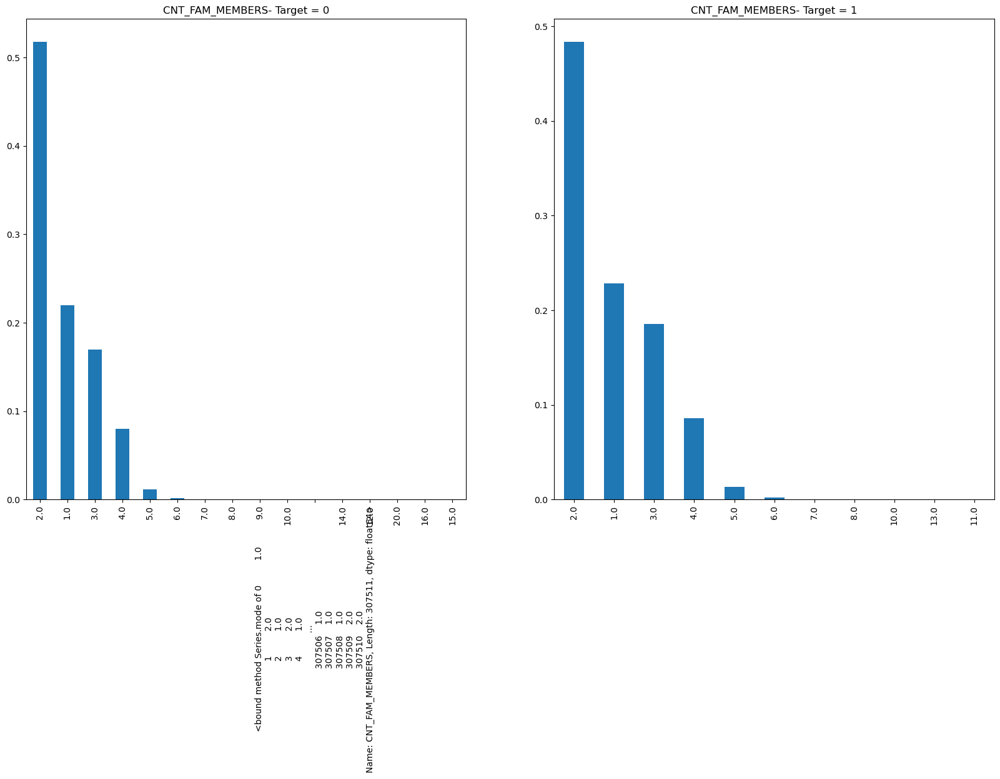

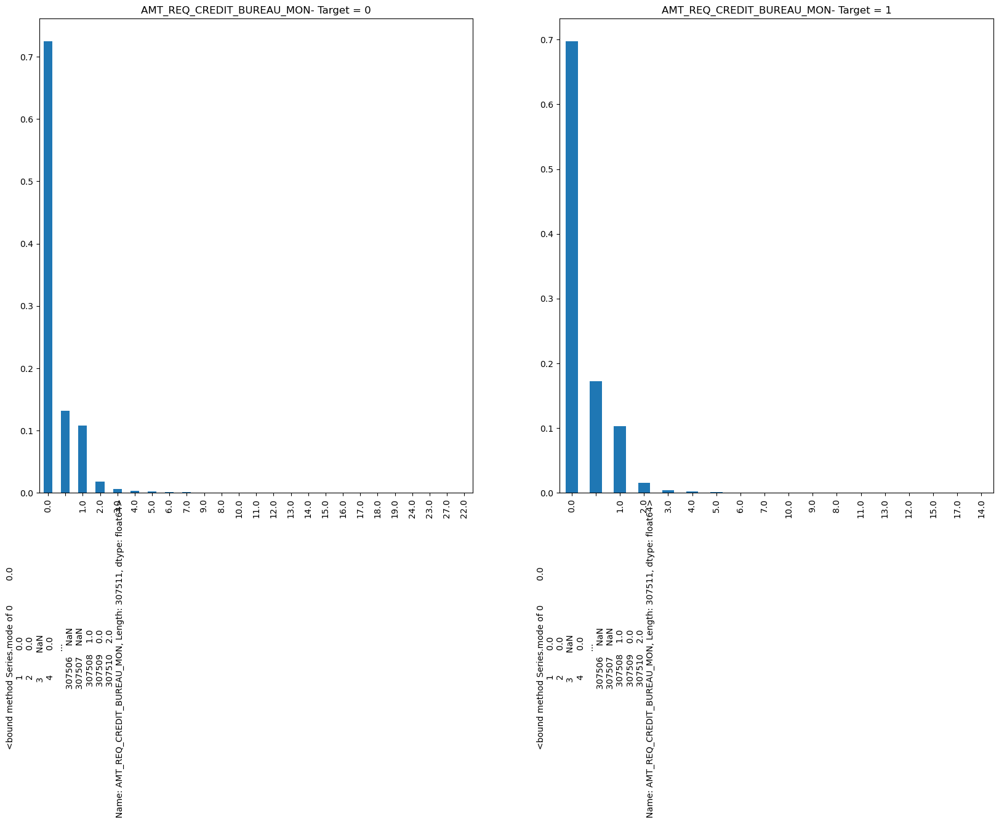

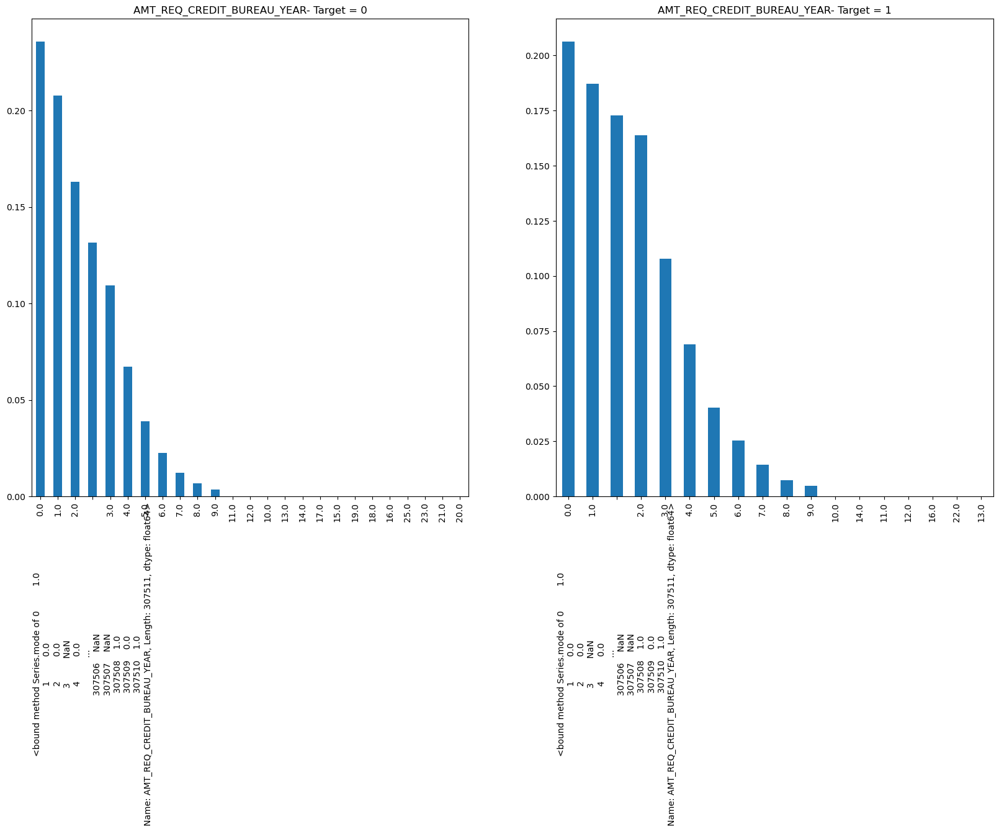

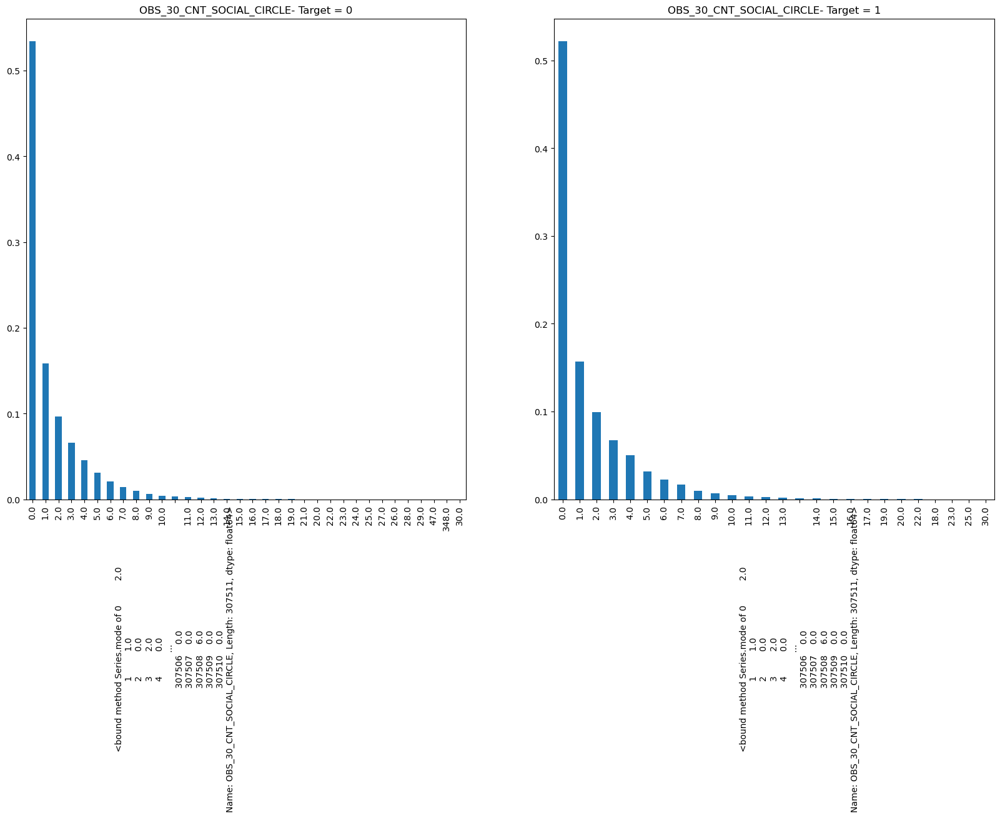

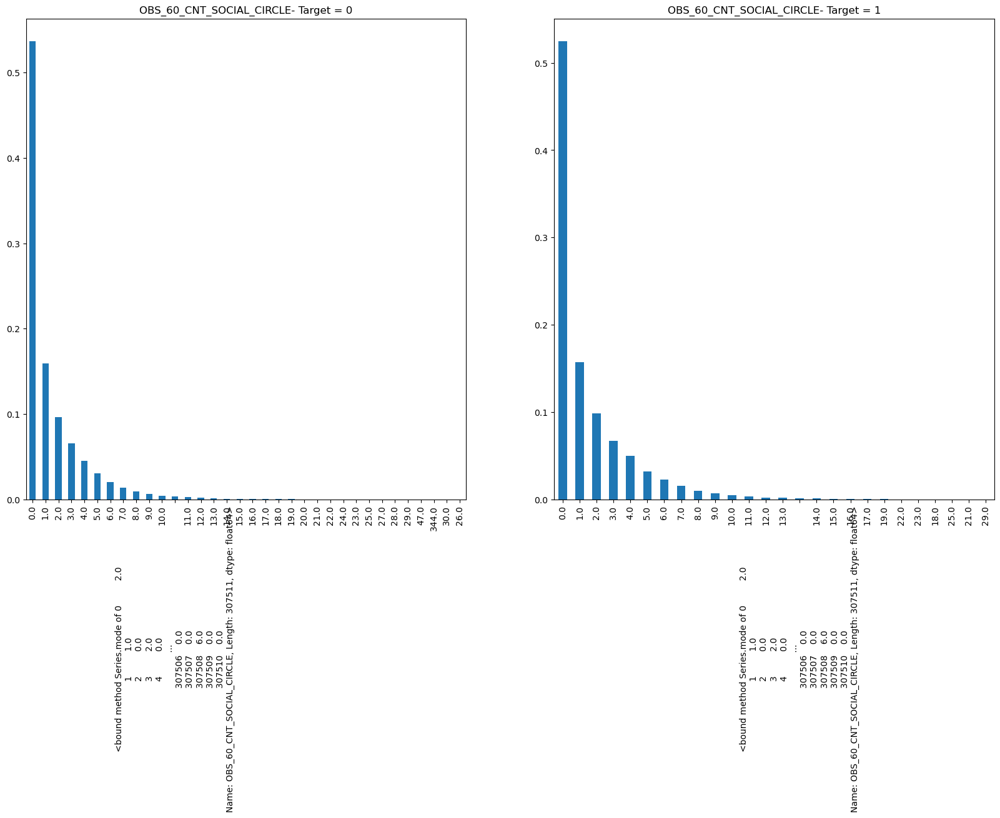

In [410]:
#loop for performing univariate analysis
for i in categorical_columns:
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,1)
    target_0[i].value_counts(normalize=True).plot.bar()
    plt.title(i+ '- Target = 0')
    plt.subplot(1,2,2)
    target_1[i].value_counts(normalize=True).plot.bar()
    plt.title(i+ '- Target = 1')

## *4.2 Numerical Variables*

Analysis how numerical variables behave between target 0 and 1
Univariate analysis for Numerical Values

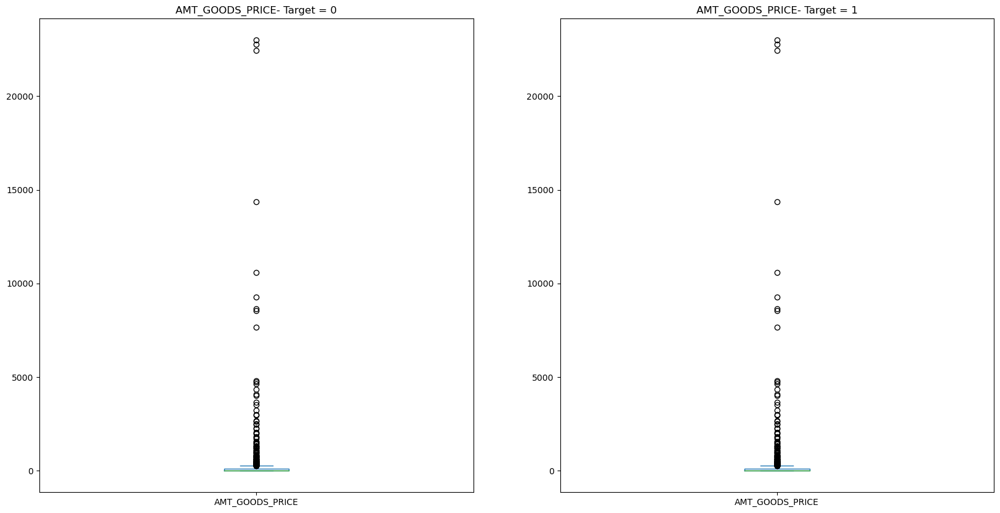

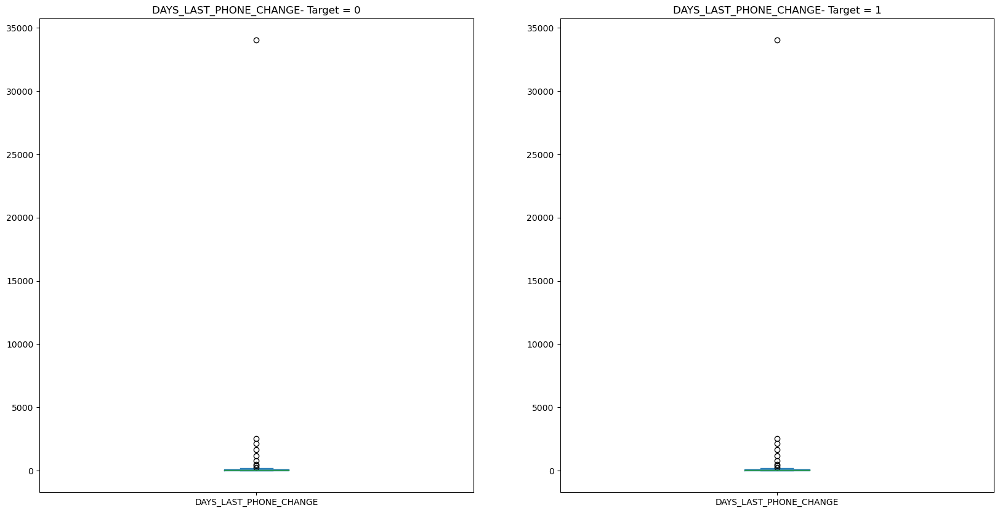

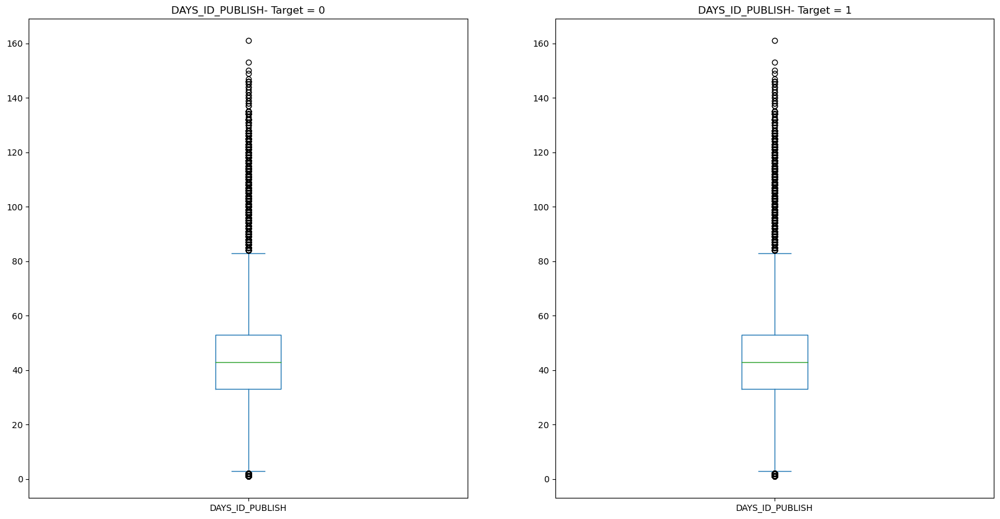

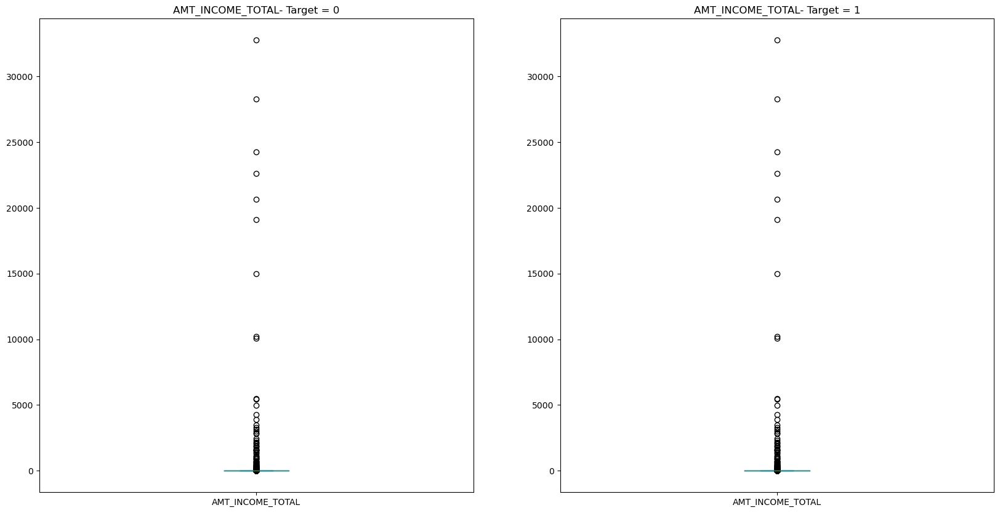

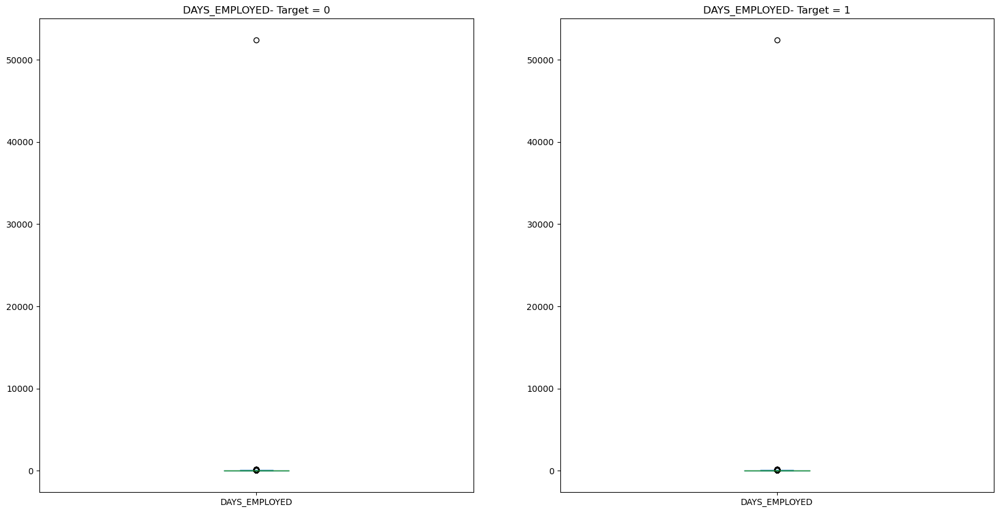

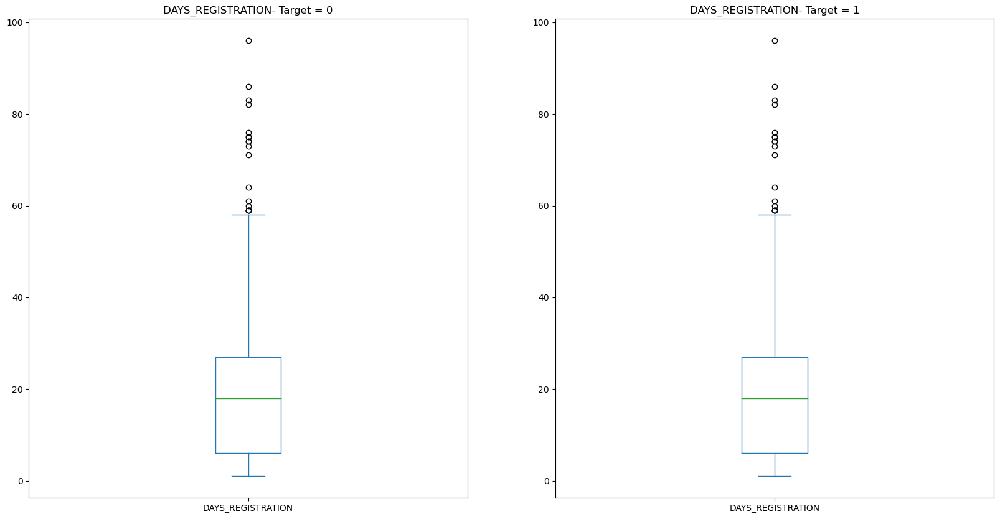

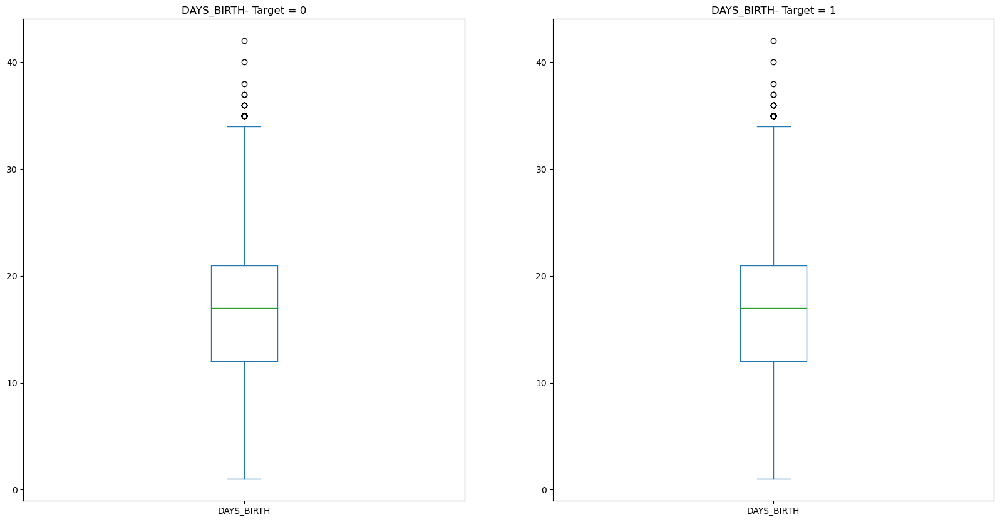

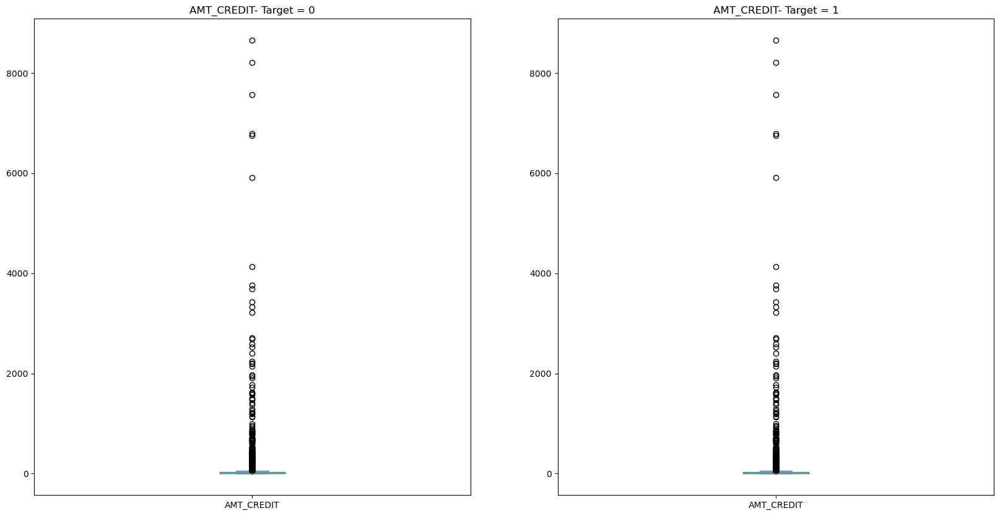

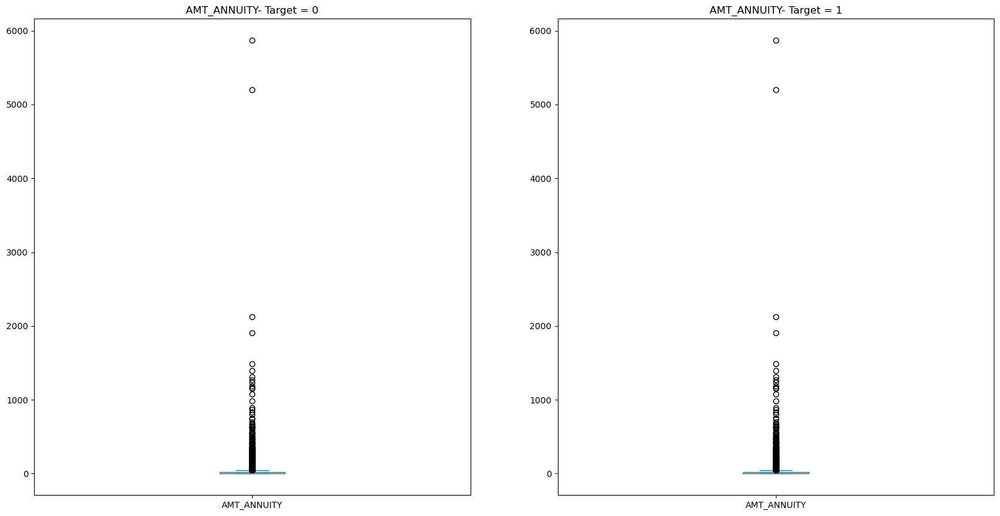

In [411]:
for i in numerical_columns:
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,1)
    #sns.scatterplot(X = target_0[i], color='green')
    #sns.boxplot(target_0[i])
    target_0[i].value_counts().plot.box()
    plt.title(i+ '- Target = 0')
    plt.subplot(1,2,2)
    #sns.boxplot(target_1[i])
    #sns.scatterplot(X = target_1[i], color='pink')
    target_0[i].value_counts().plot.box()
    plt.title(i + '- Target = 1')

    plt.show()

# **5.Bivariate Analysis**

## *5.1 Bivariate analysis on categorical vs categorical column*

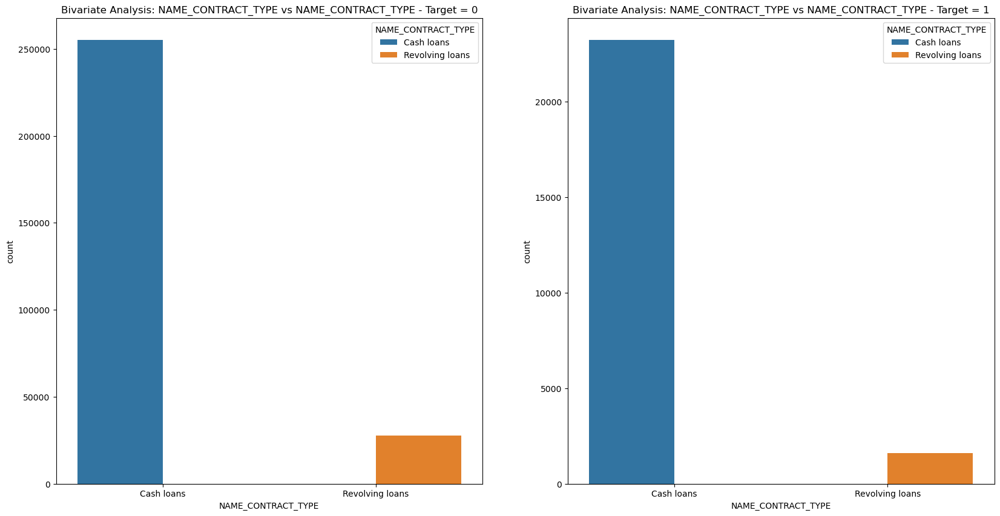

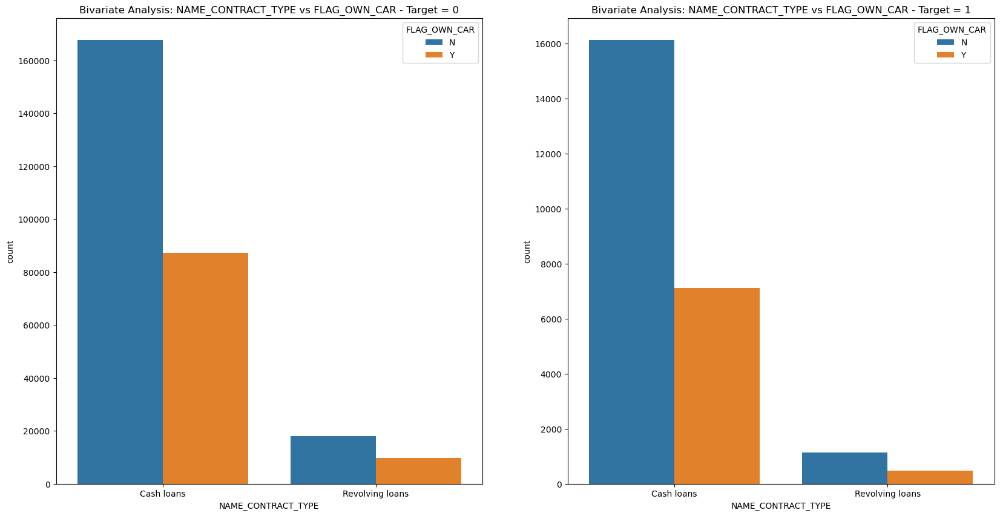

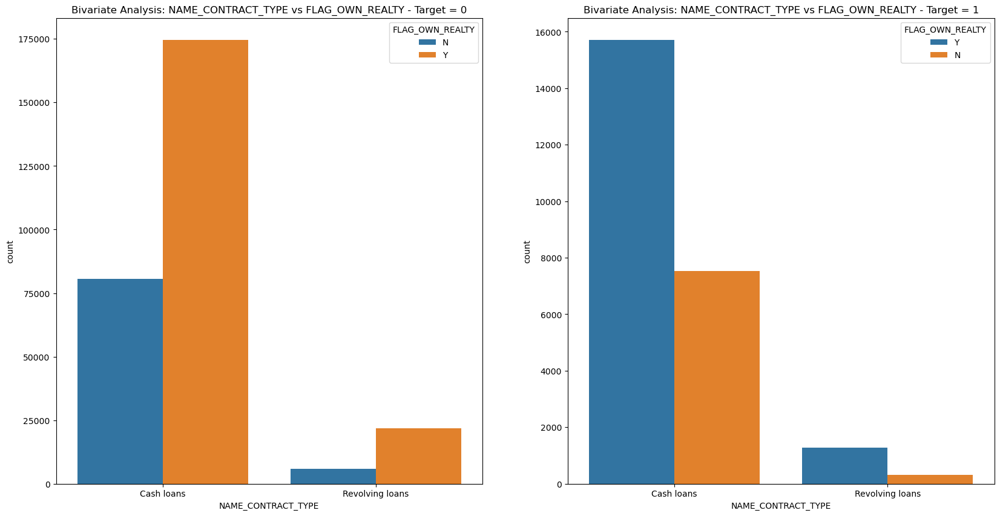

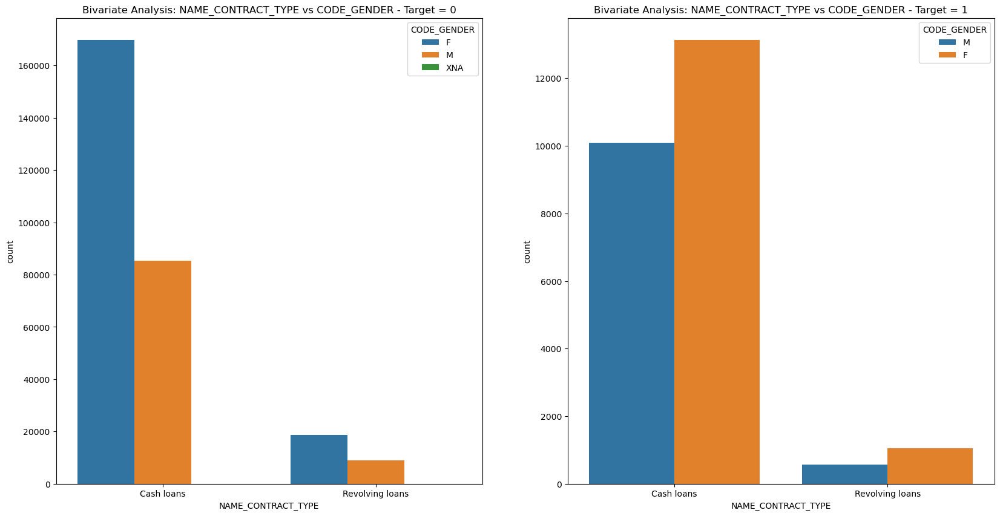

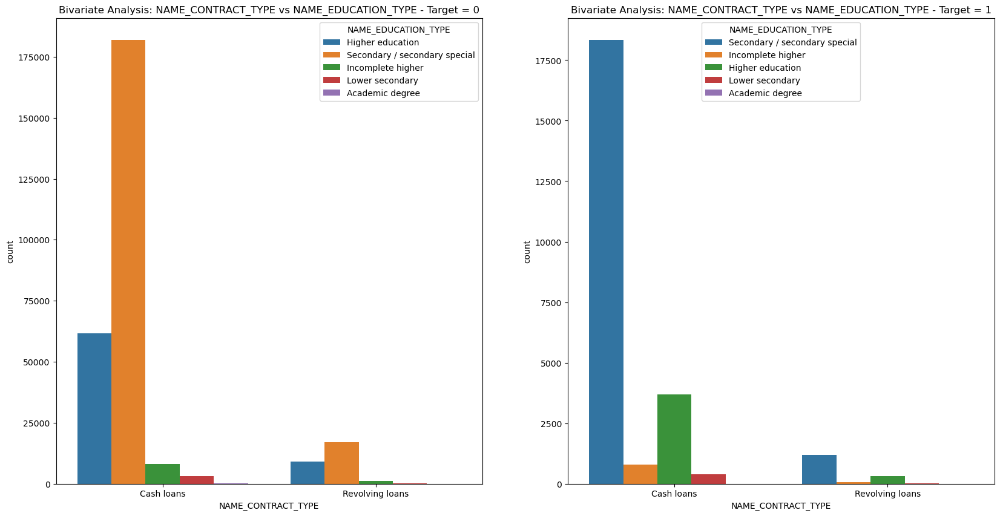

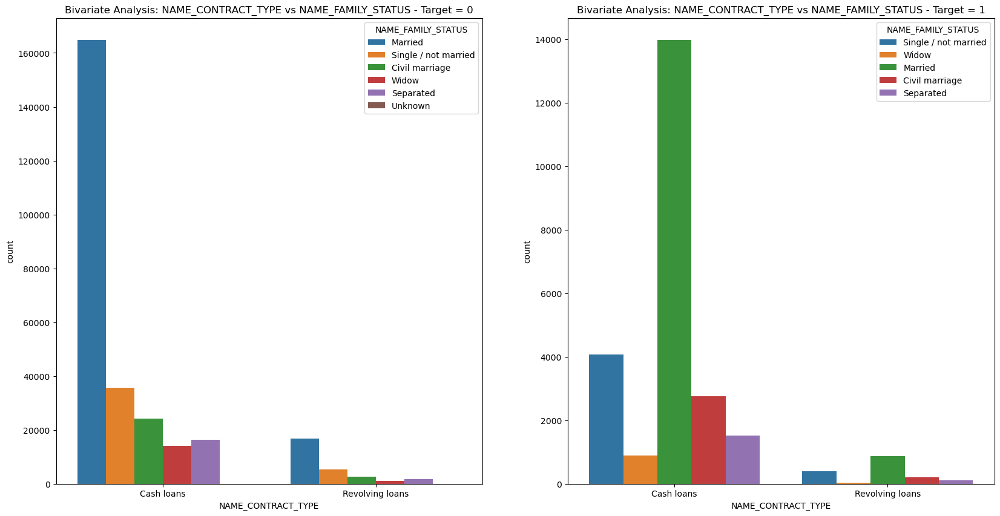

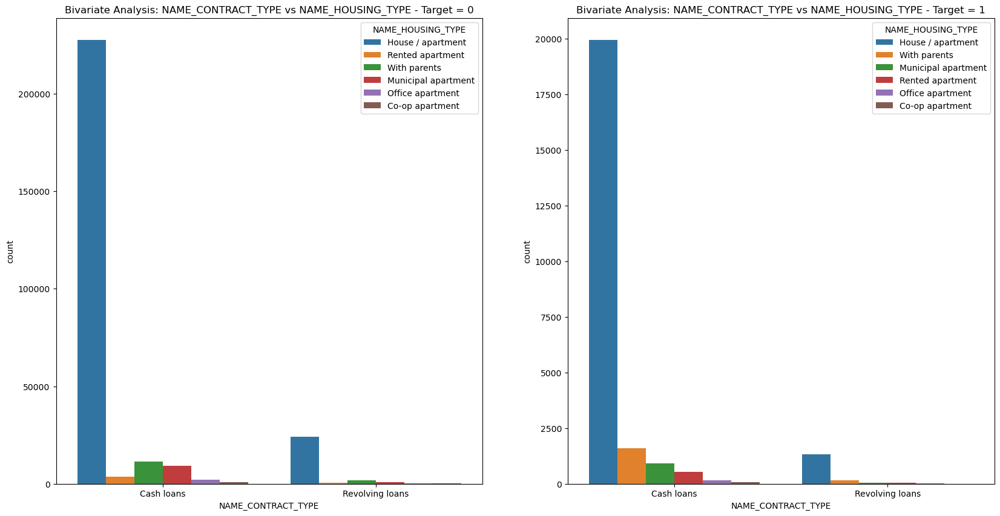

Skipping plot for NAME_CONTRACT_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


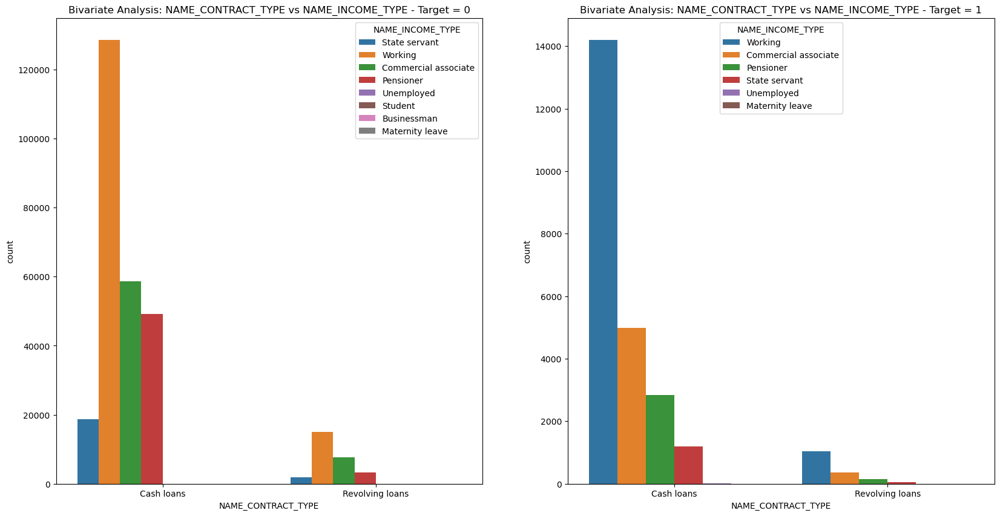

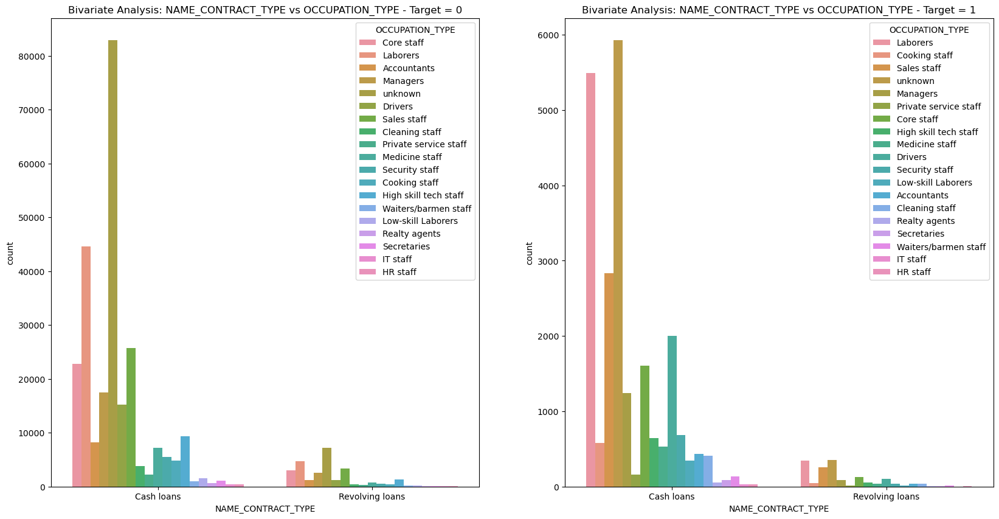

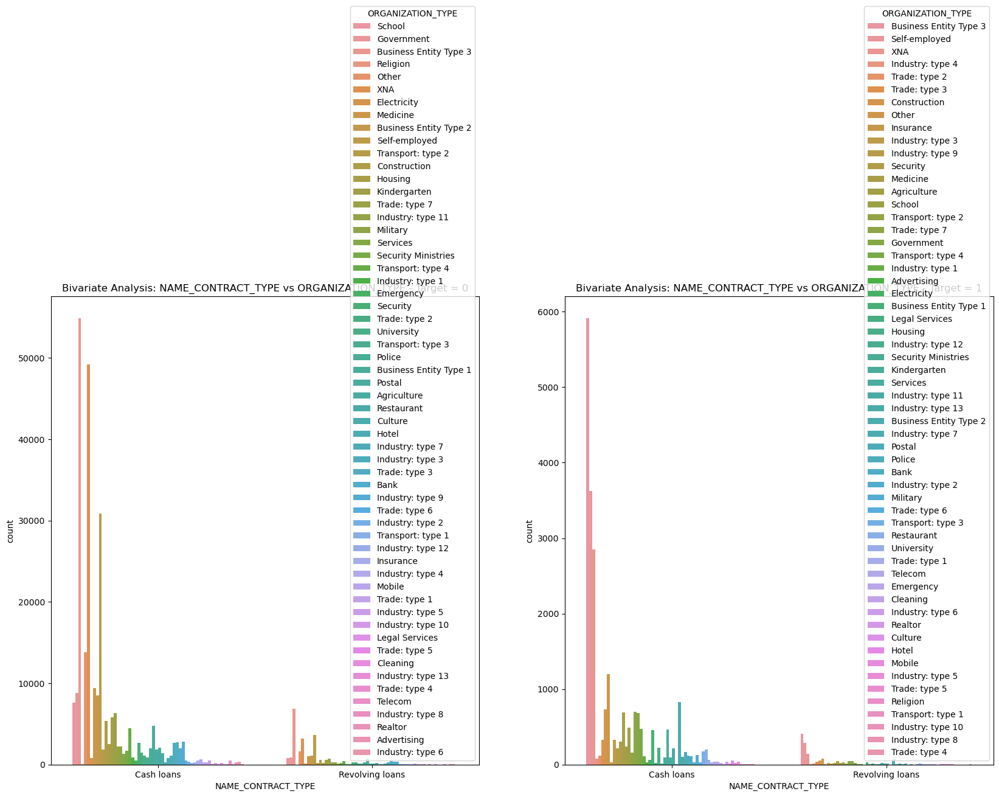

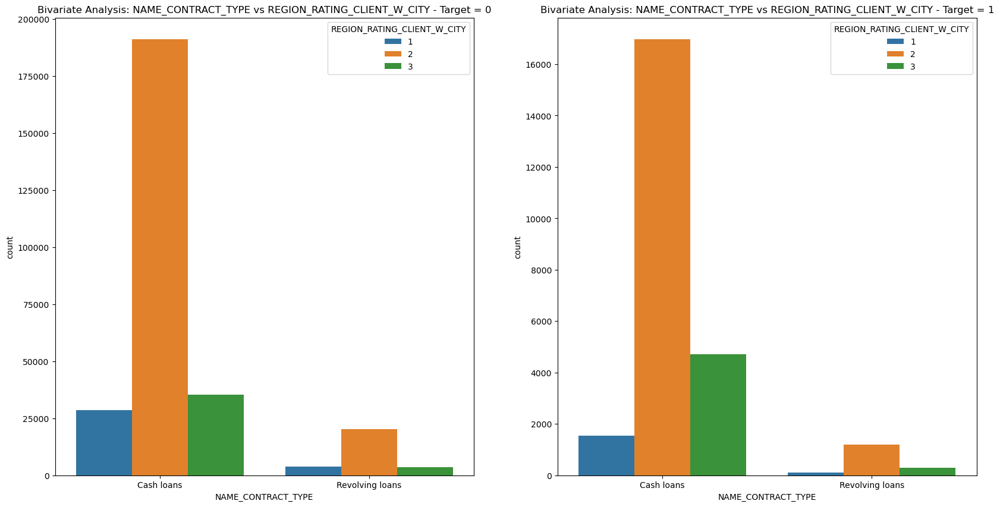

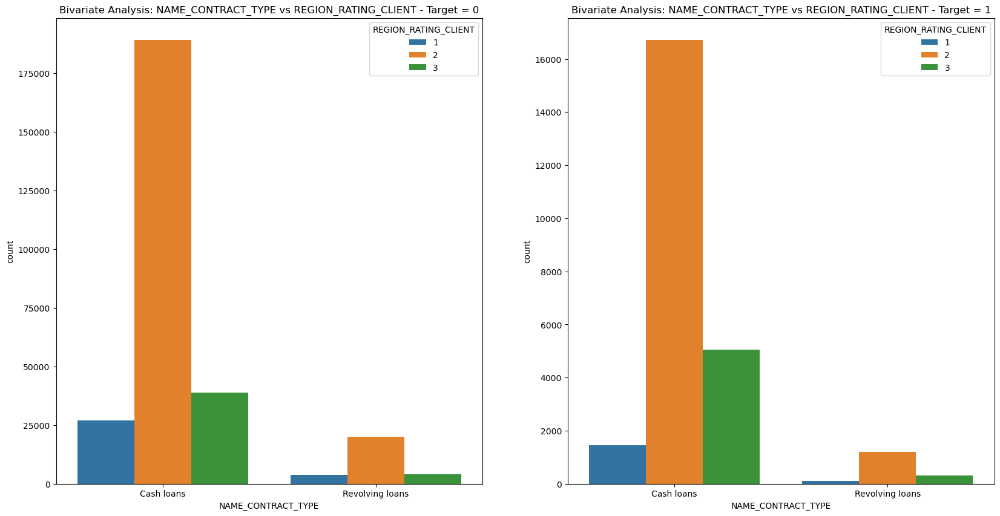

Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


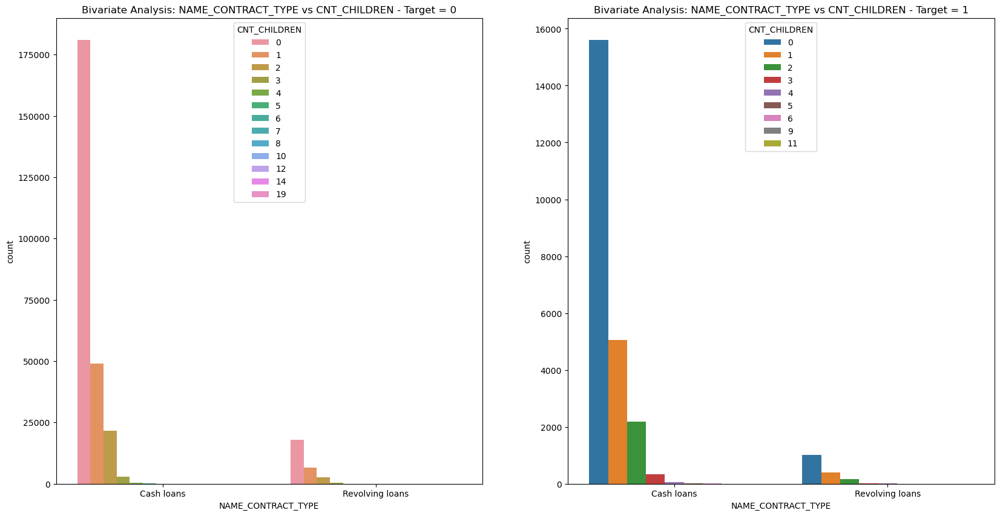

Skipping plot for NAME_CONTRACT_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_CONTRACT_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


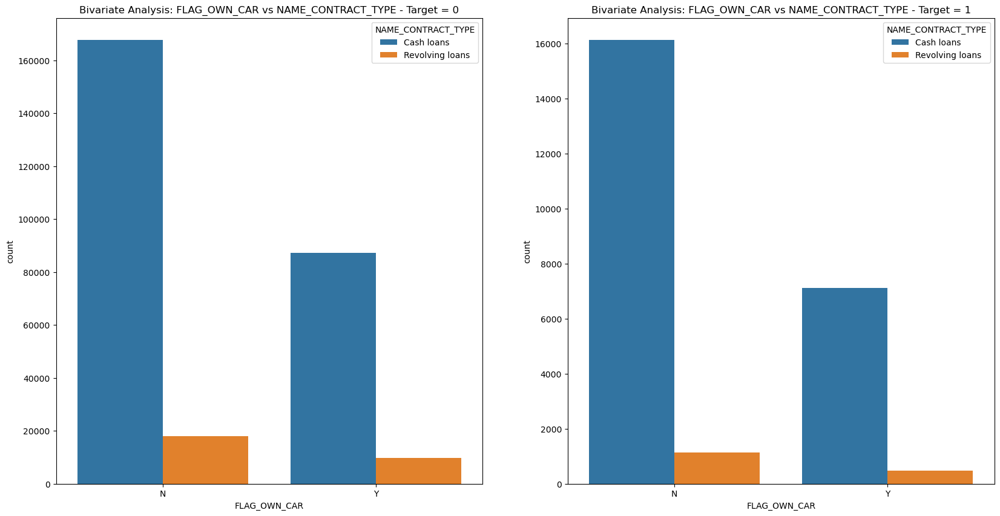

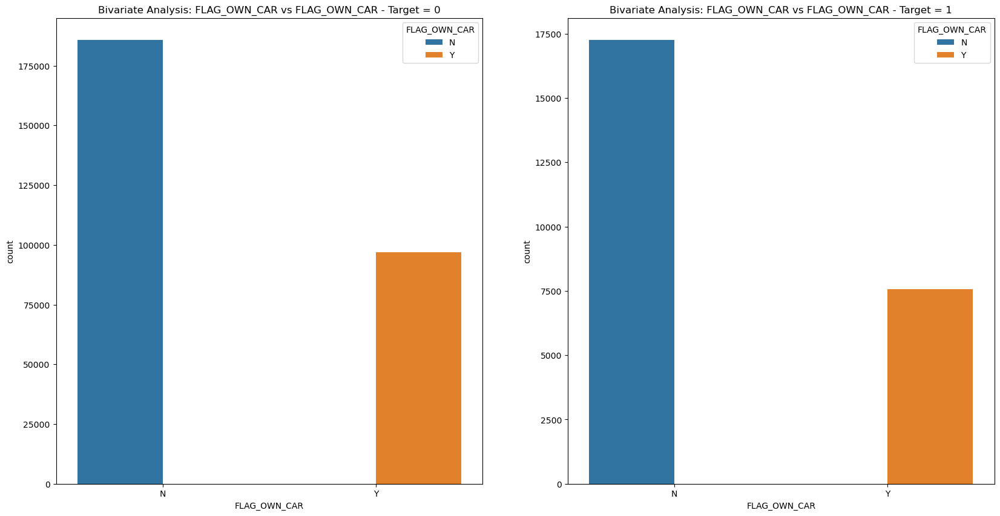

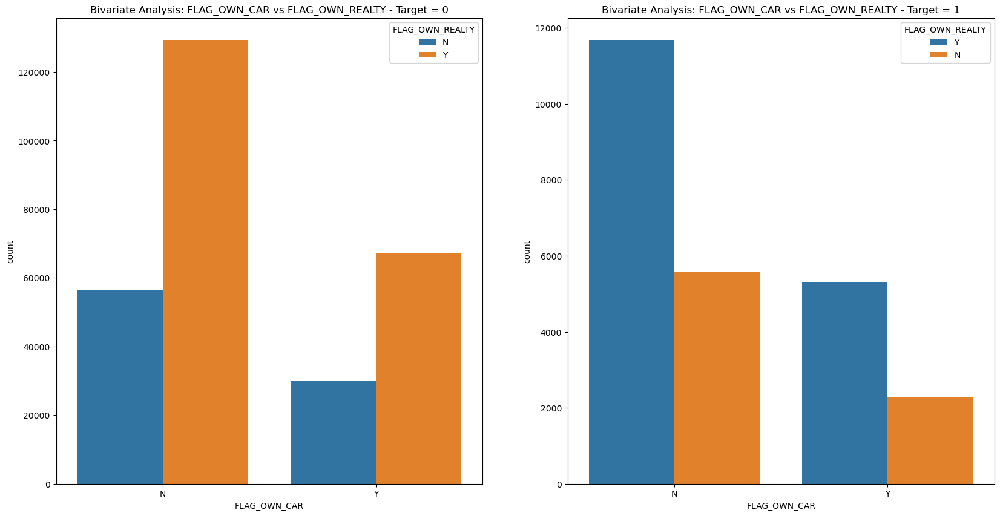

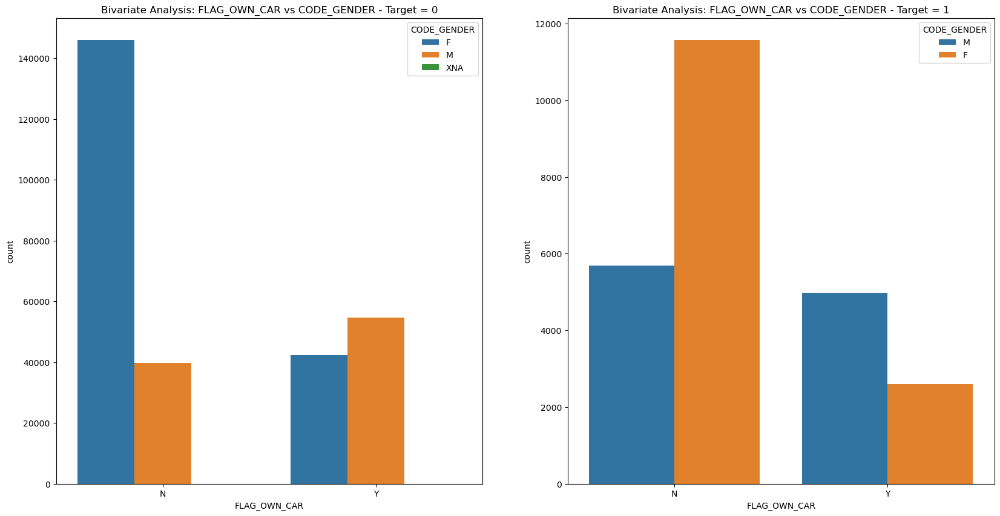

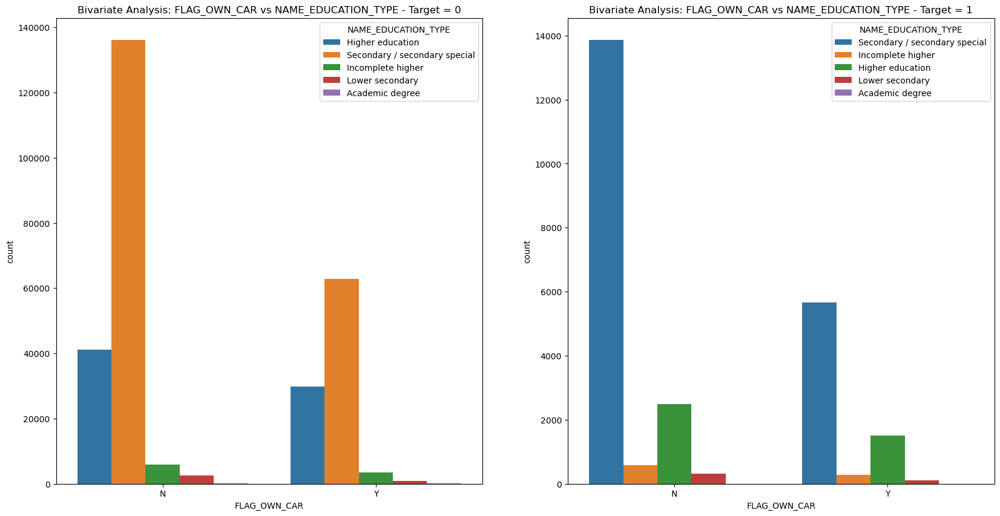

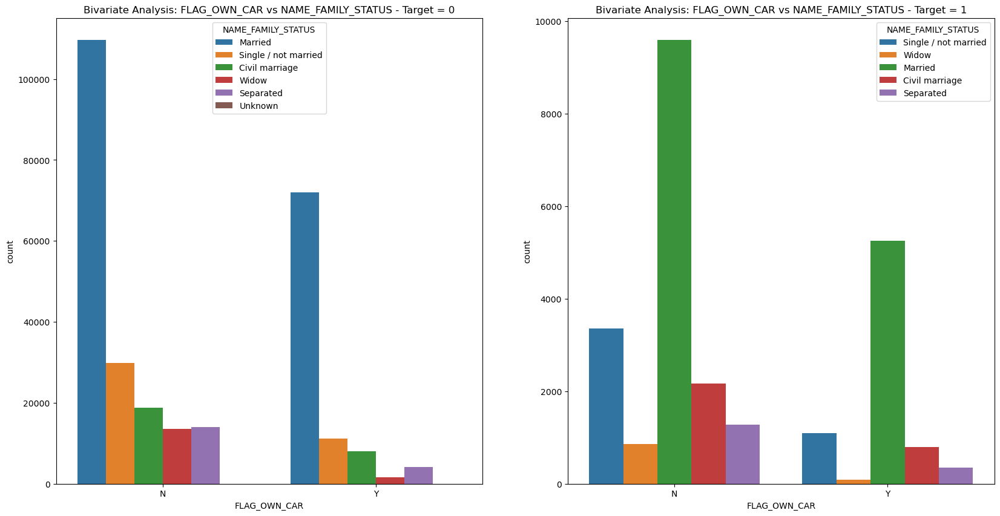

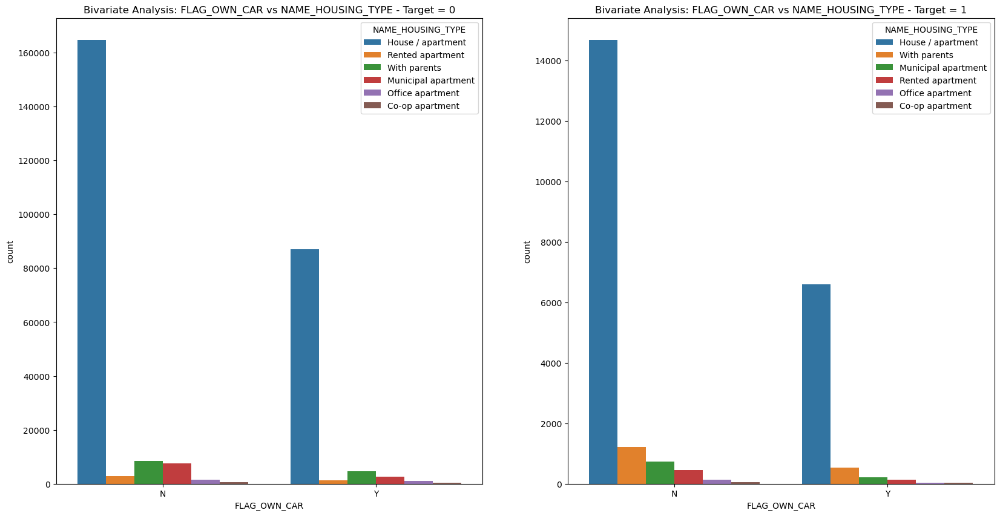

Skipping plot for FLAG_OWN_CAR vs NAME_TYPE_SUITE due to presence of methods in data.


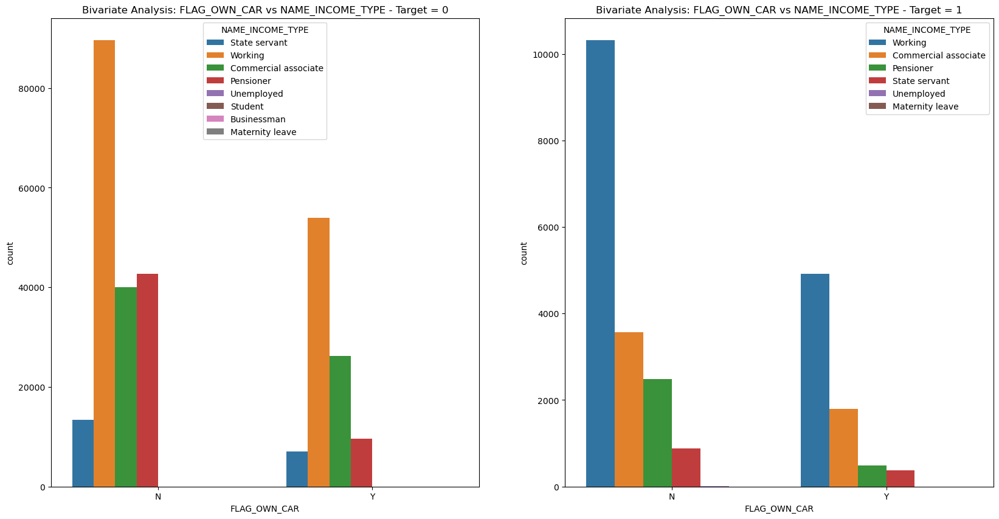

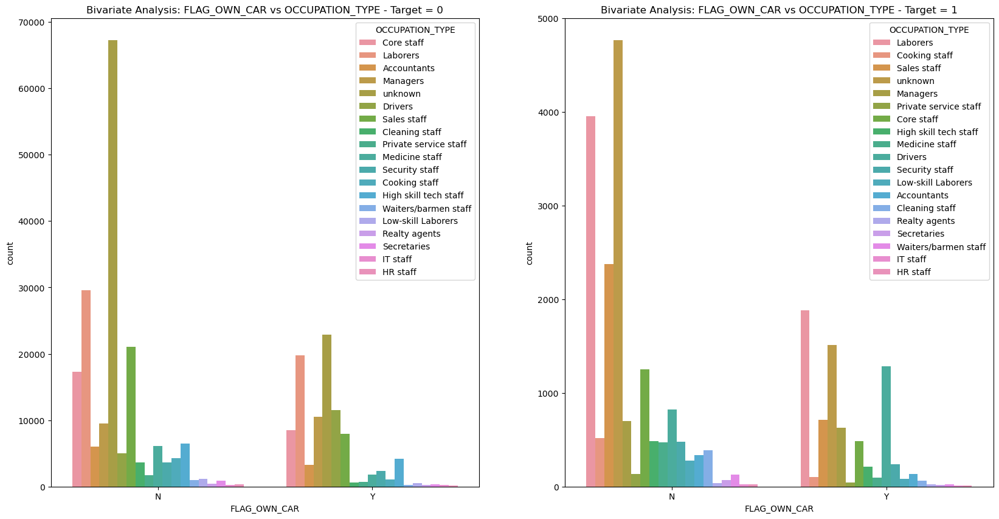

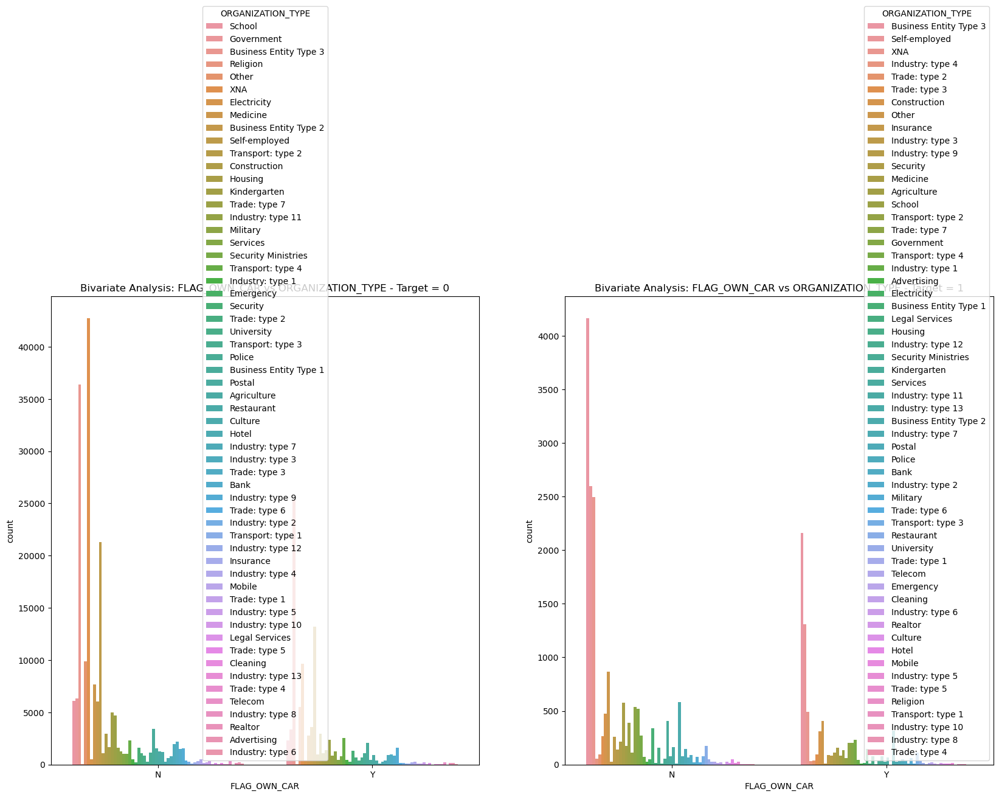

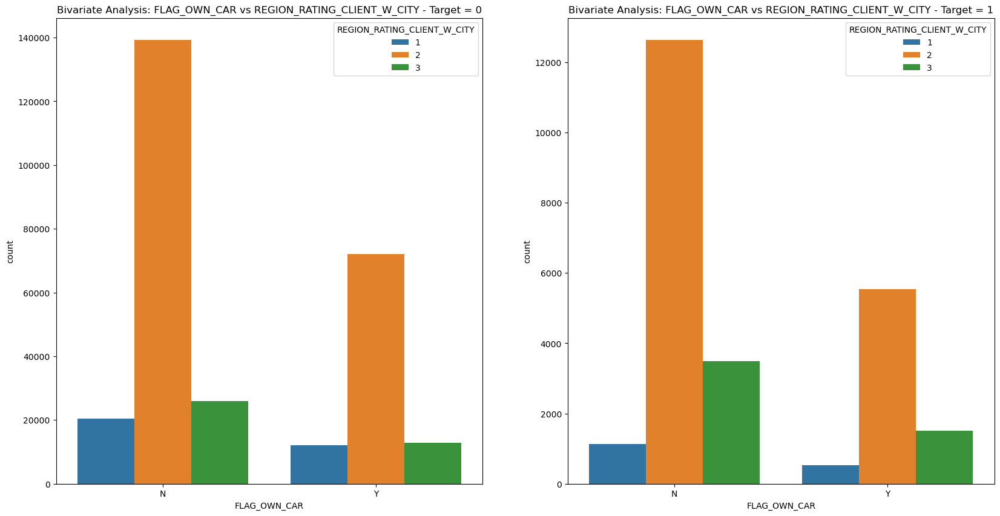

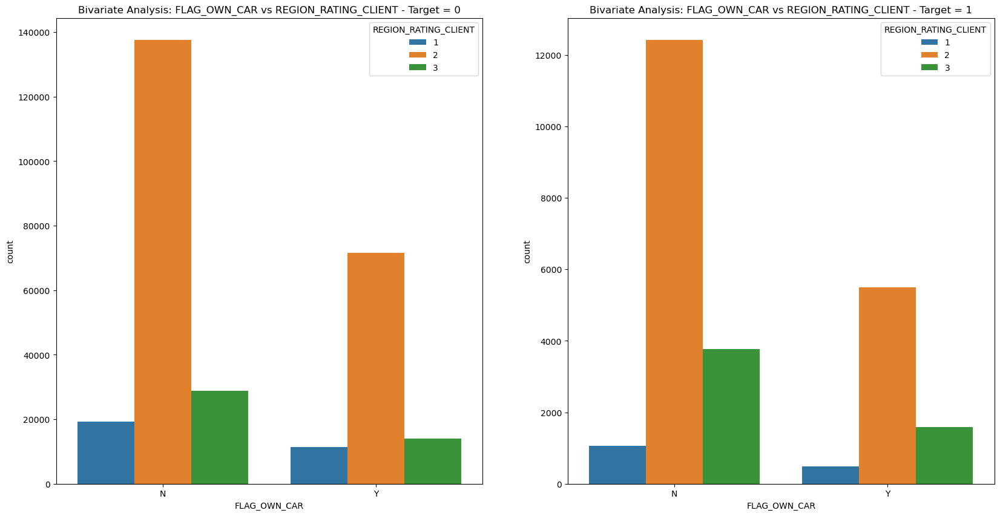

Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


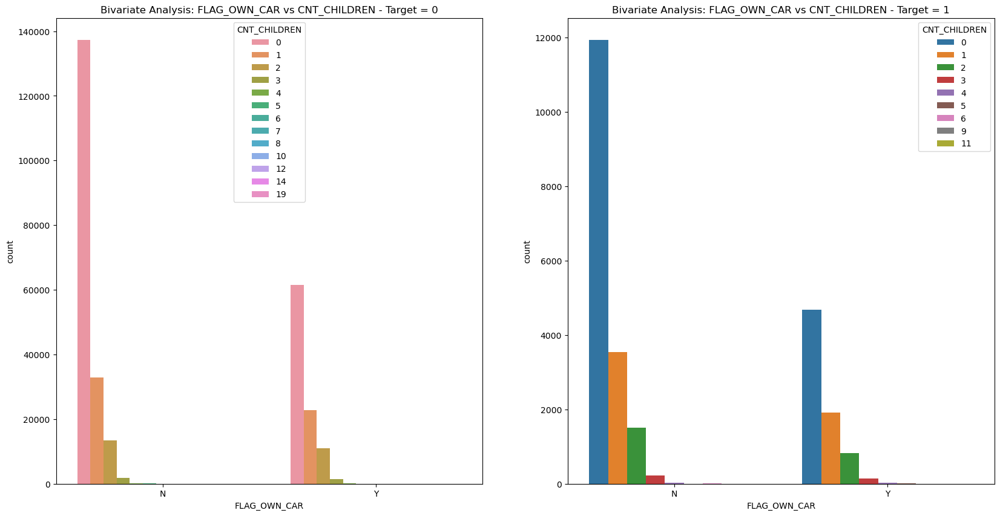

Skipping plot for FLAG_OWN_CAR vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_CAR vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


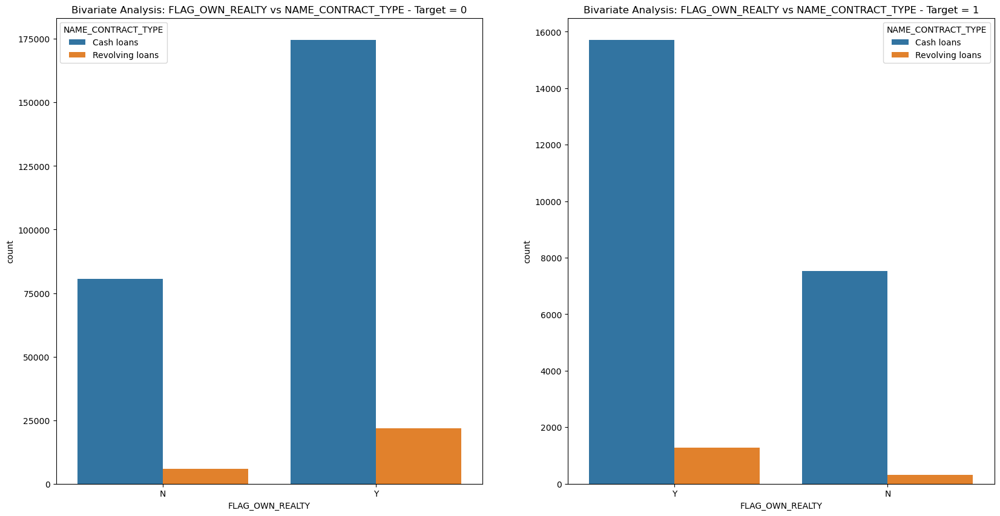

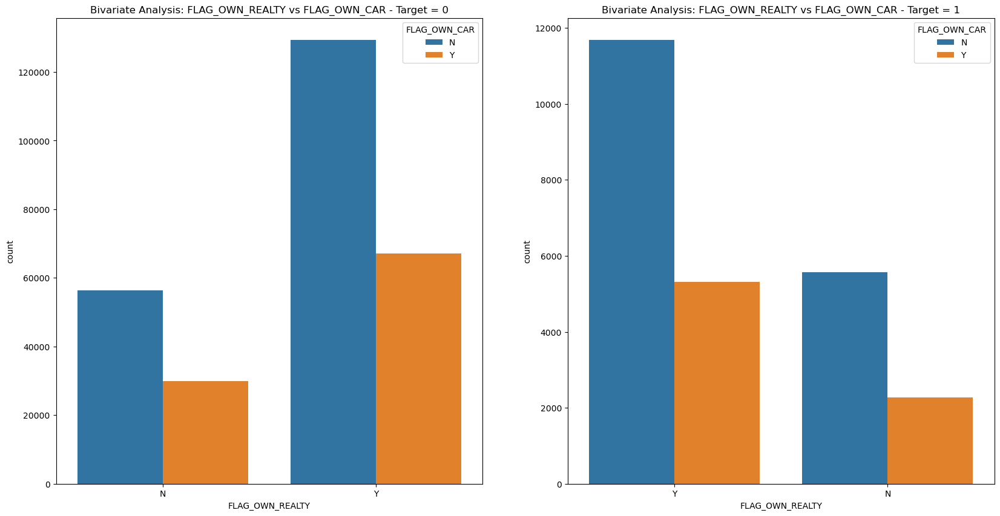

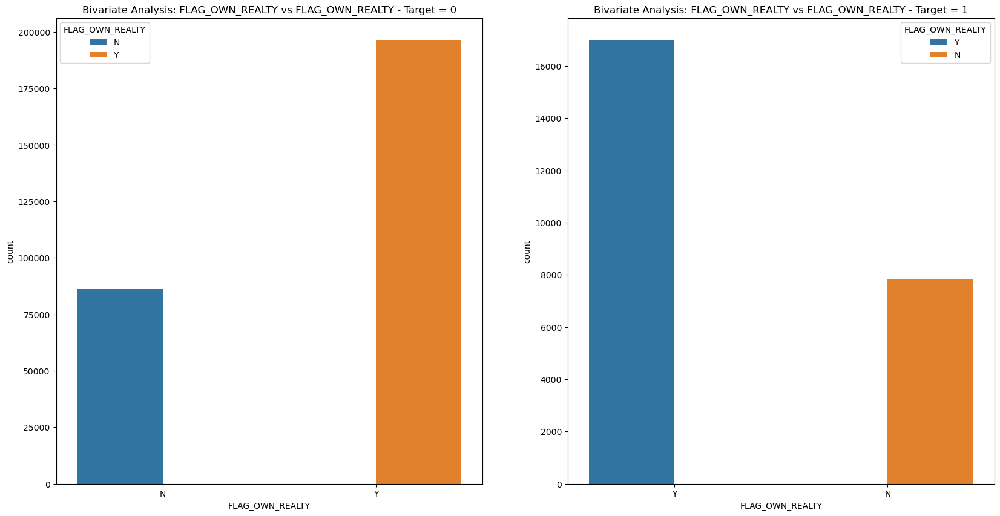

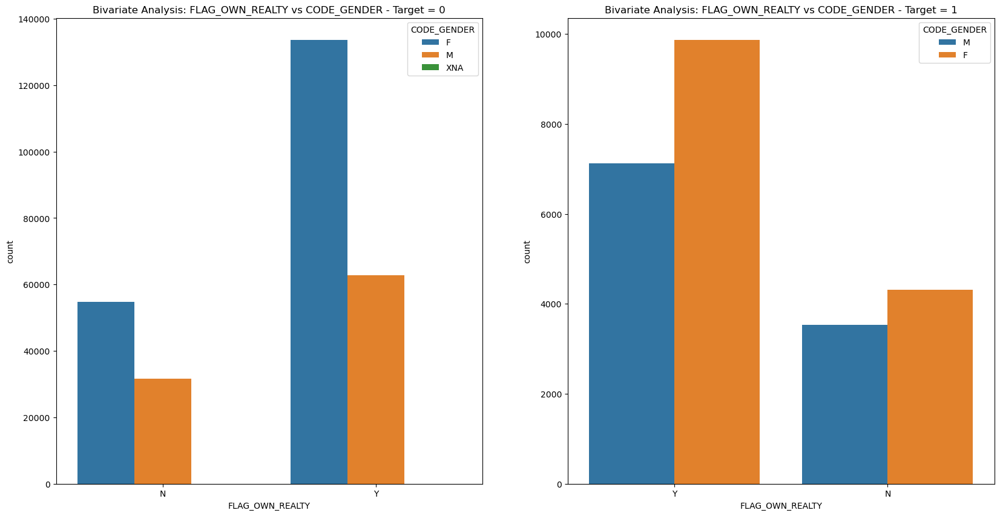

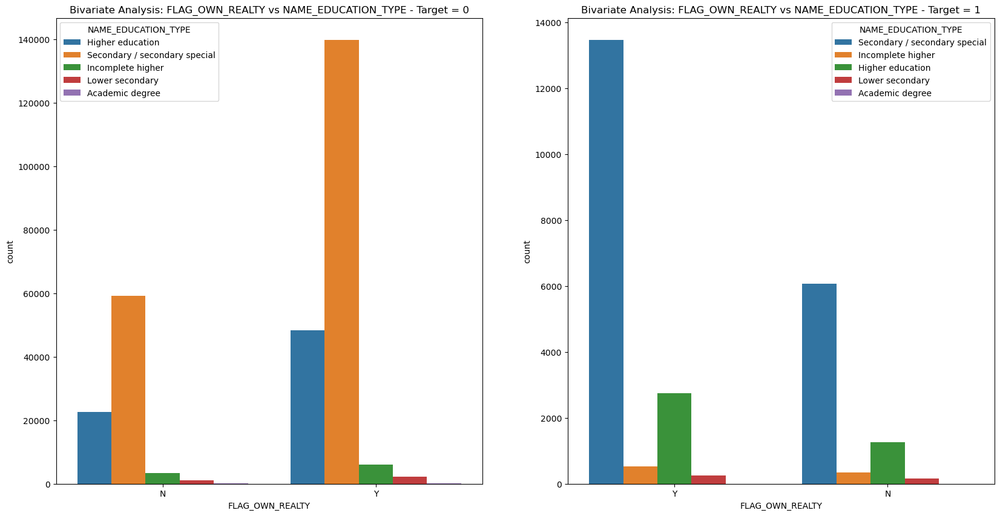

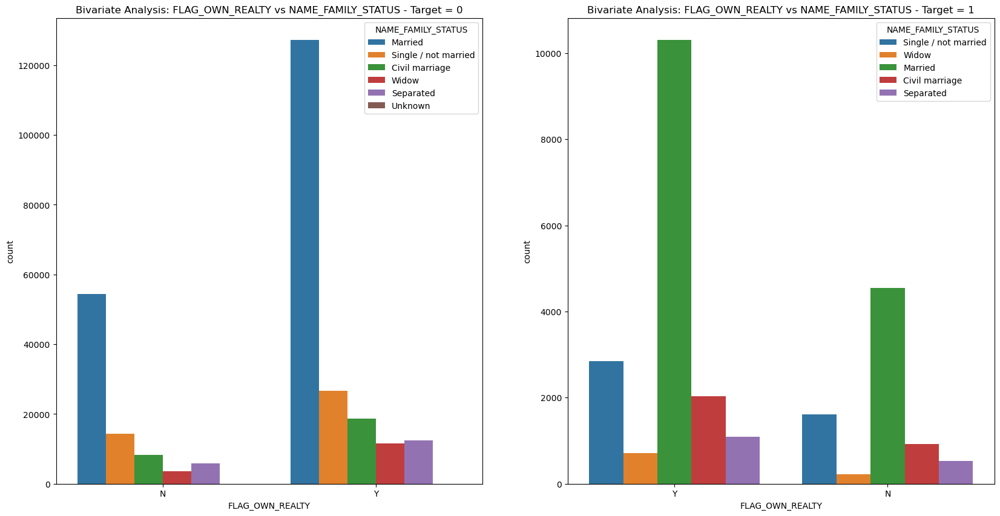

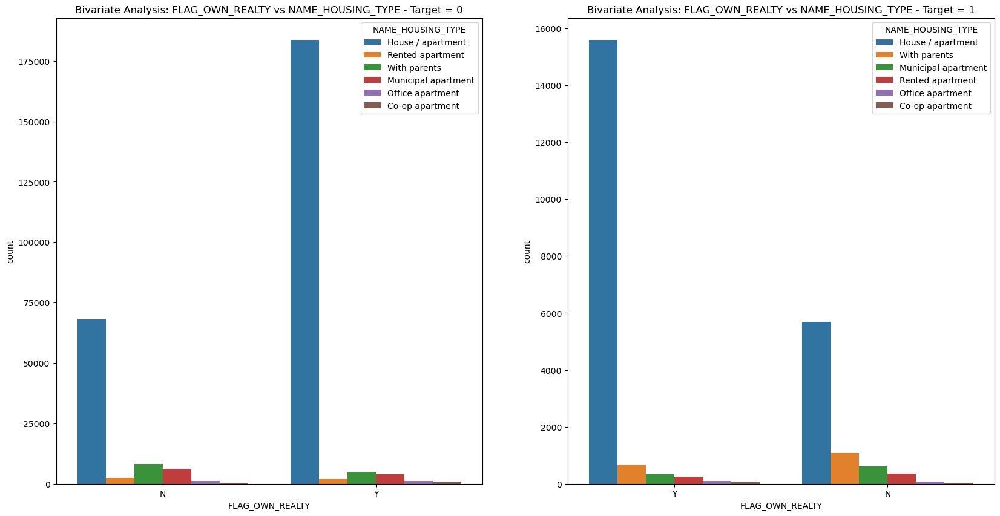

Skipping plot for FLAG_OWN_REALTY vs NAME_TYPE_SUITE due to presence of methods in data.


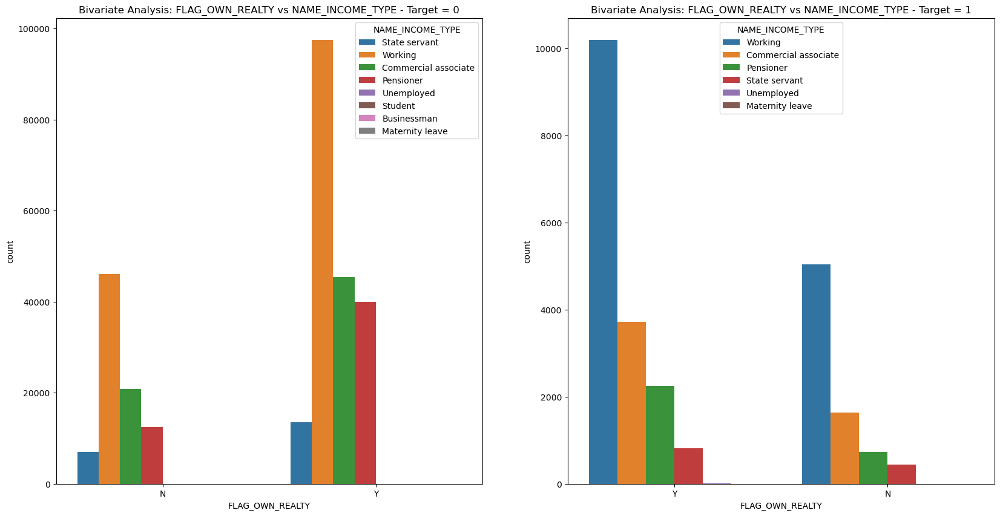

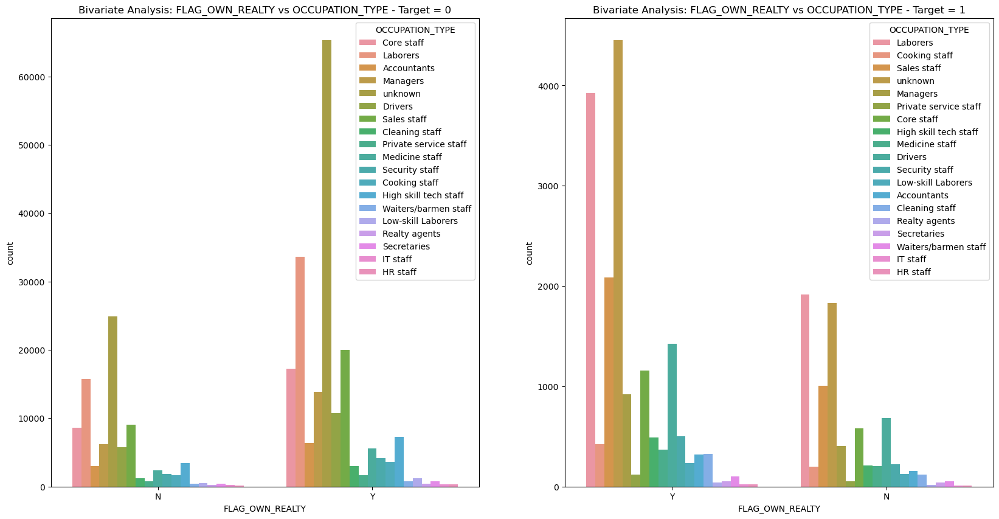

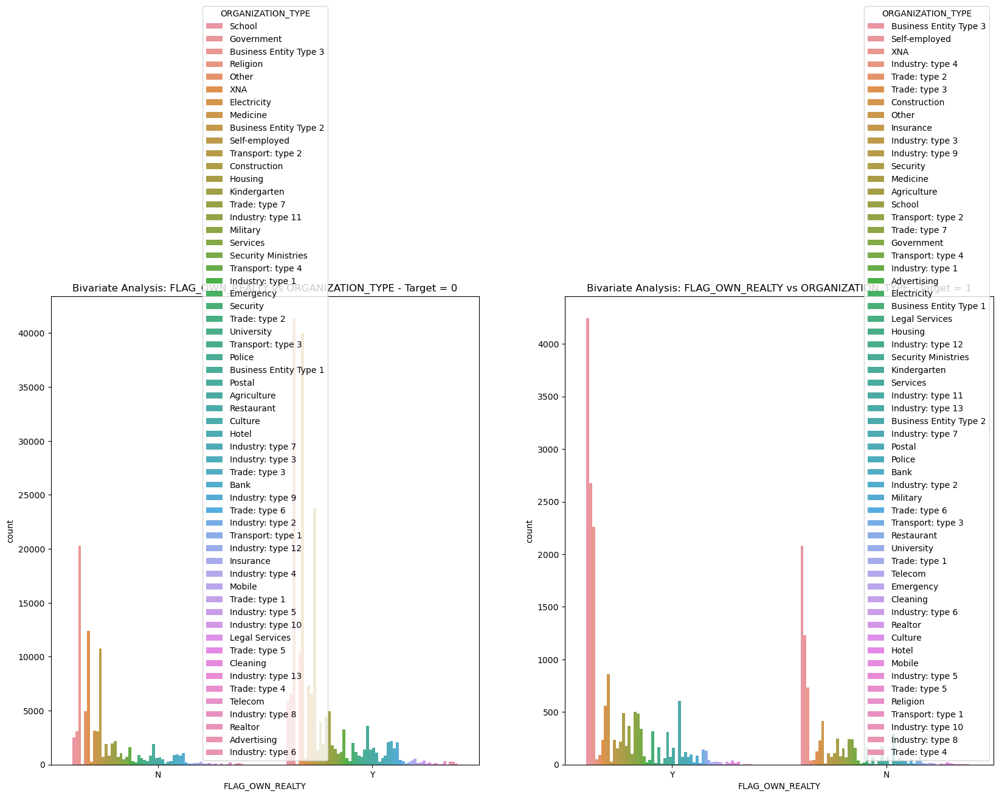

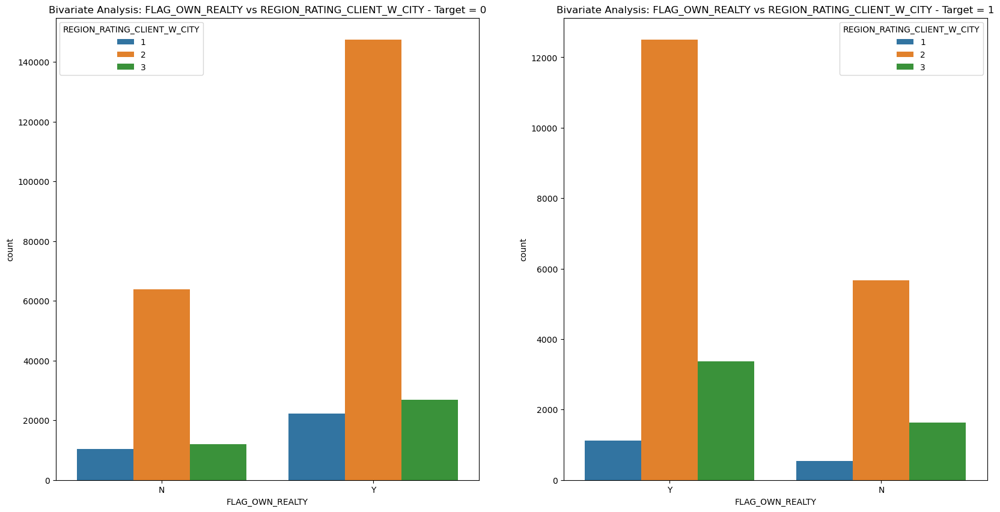

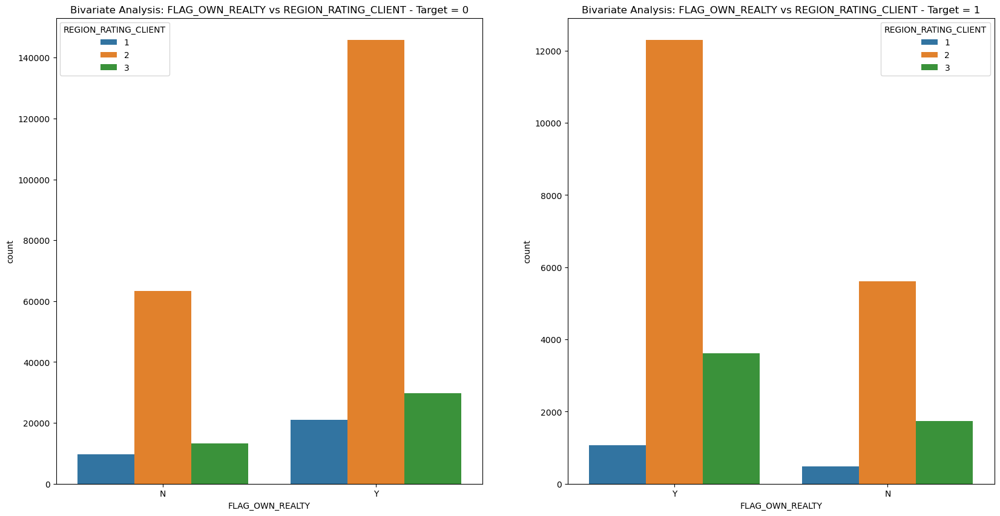

Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


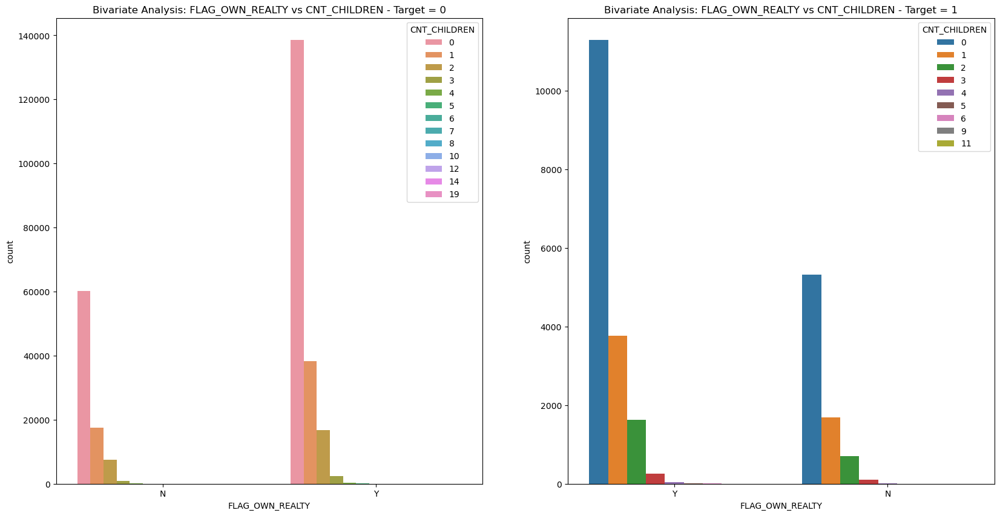

Skipping plot for FLAG_OWN_REALTY vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for FLAG_OWN_REALTY vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


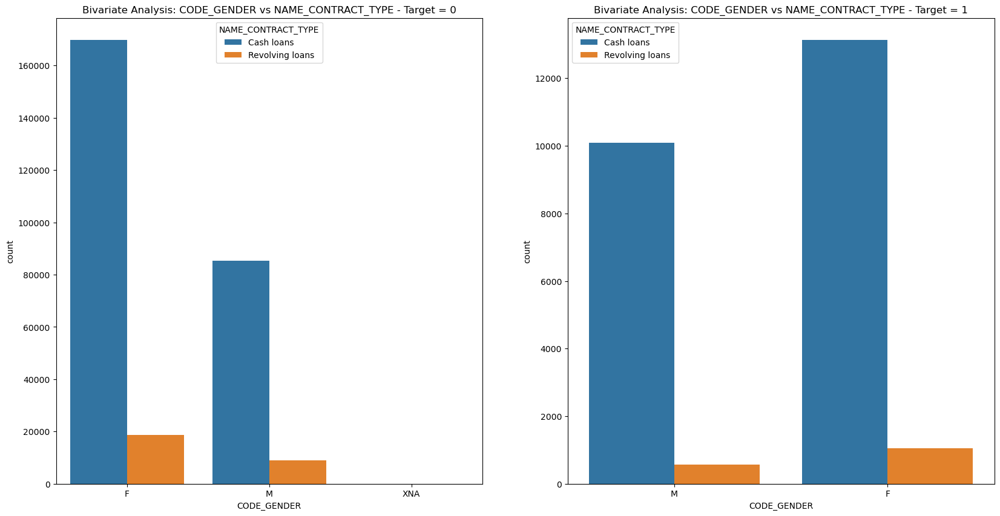

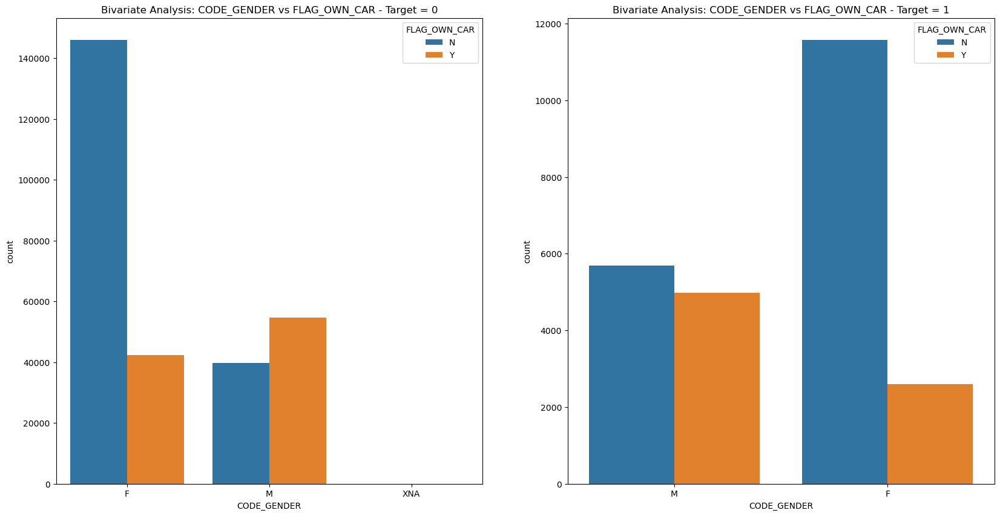

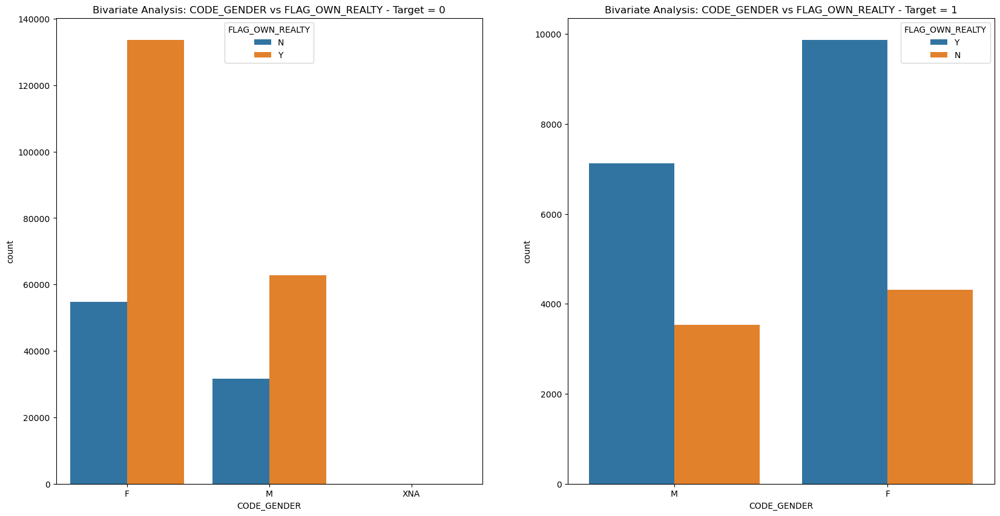

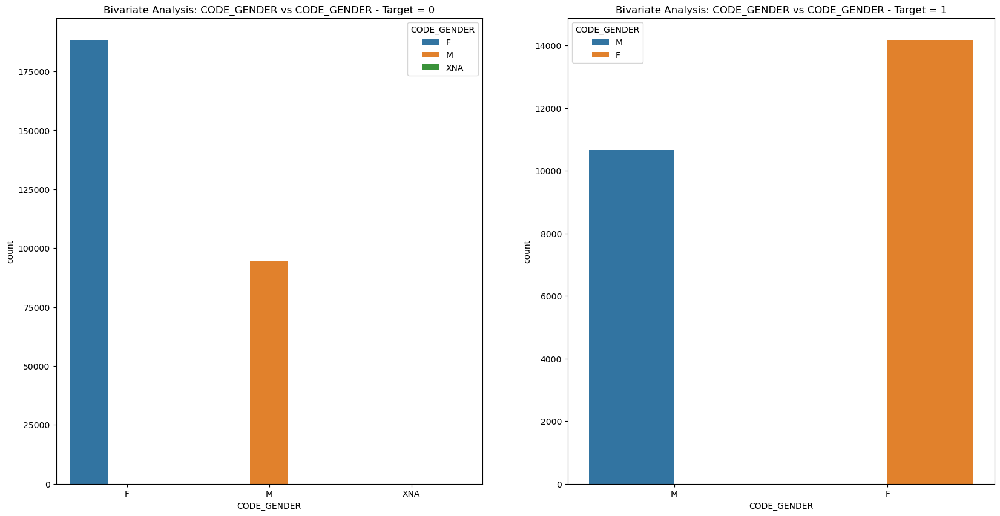

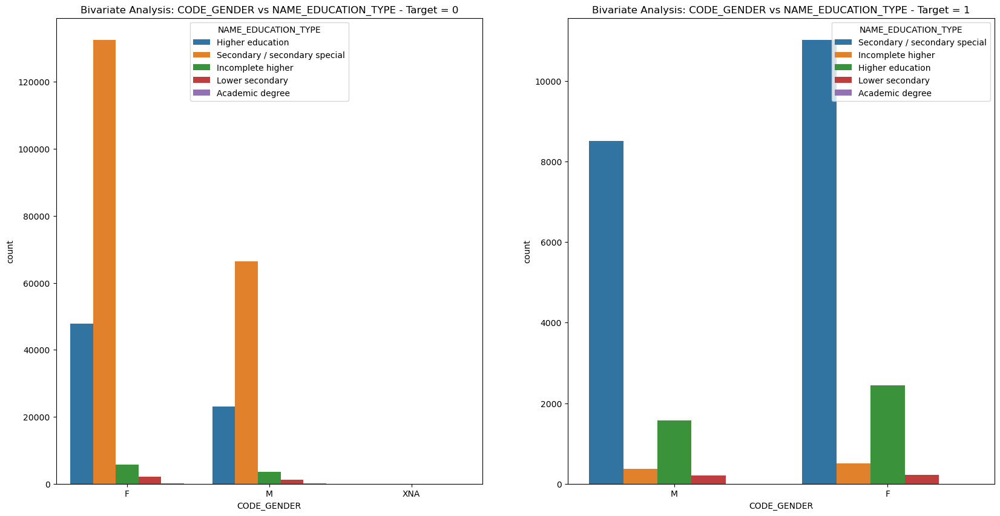

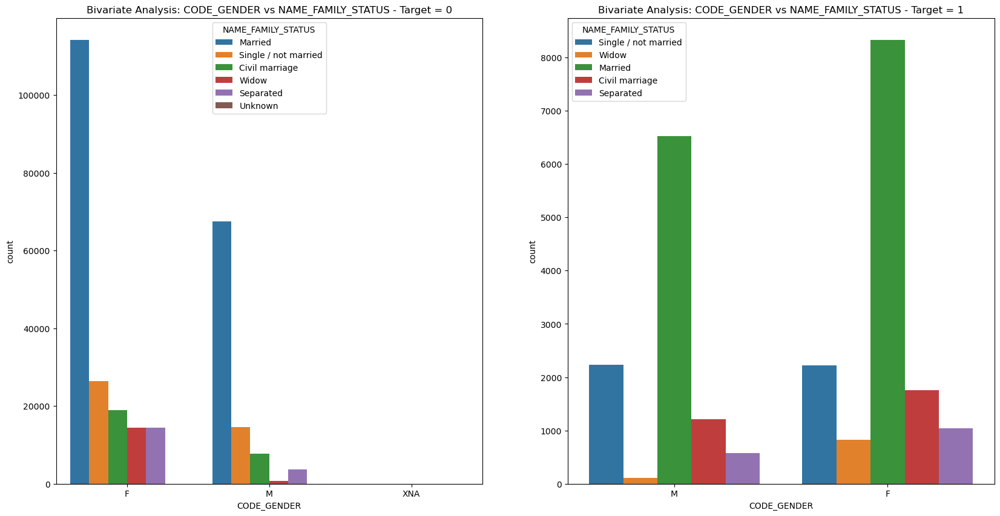

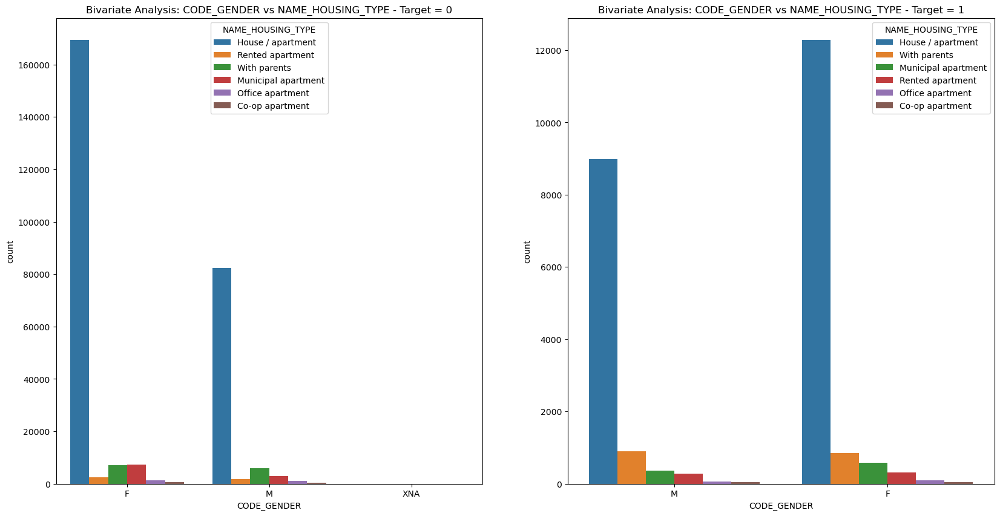

Skipping plot for CODE_GENDER vs NAME_TYPE_SUITE due to presence of methods in data.


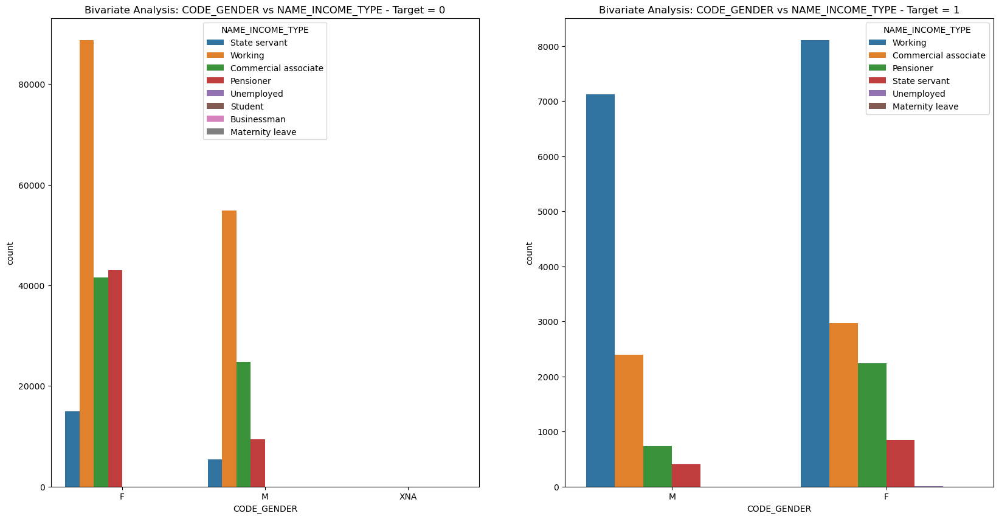

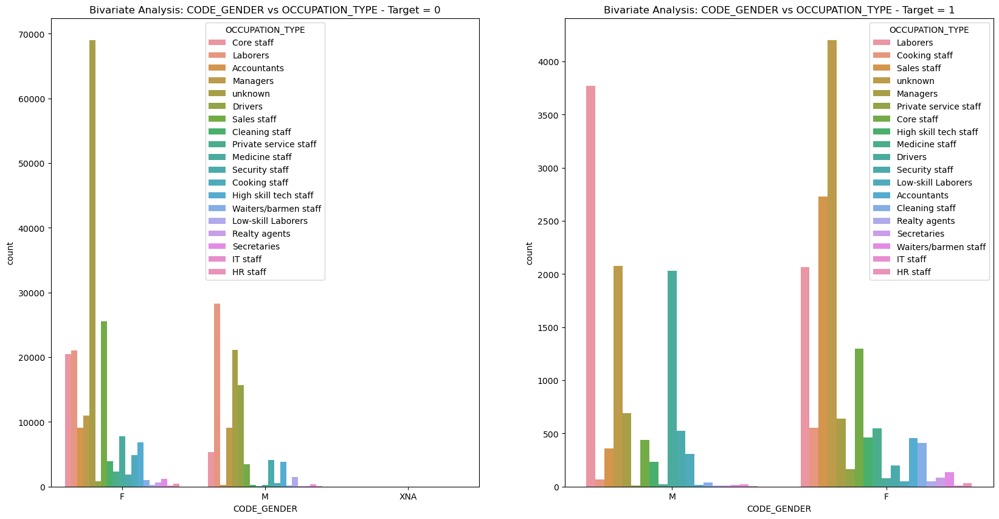

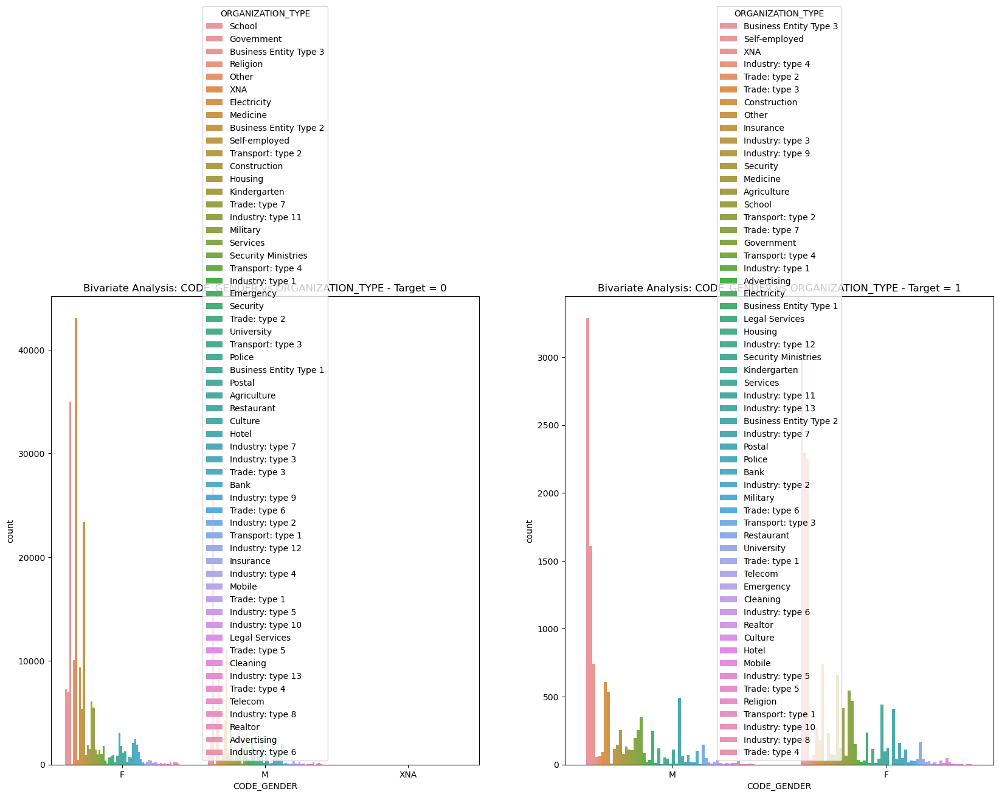

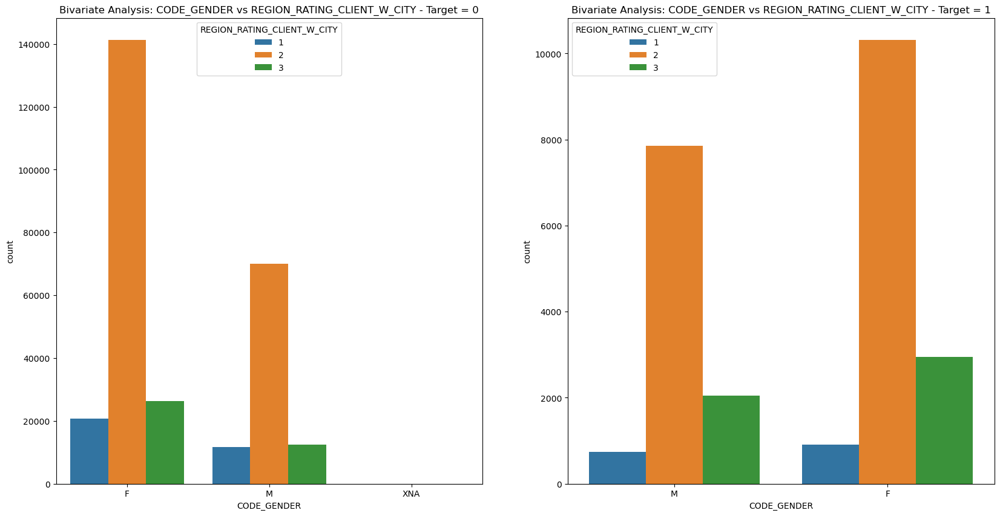

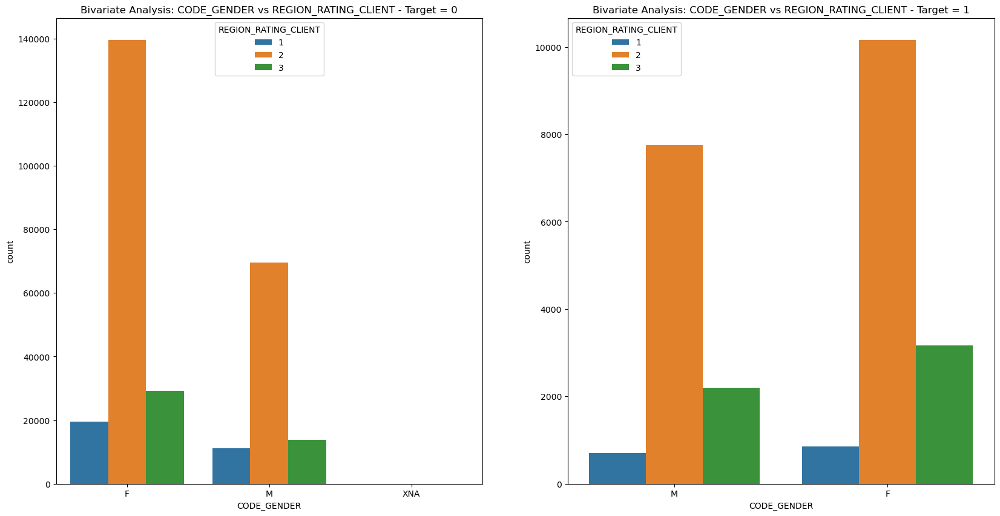

Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for CODE_GENDER vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for CODE_GENDER vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


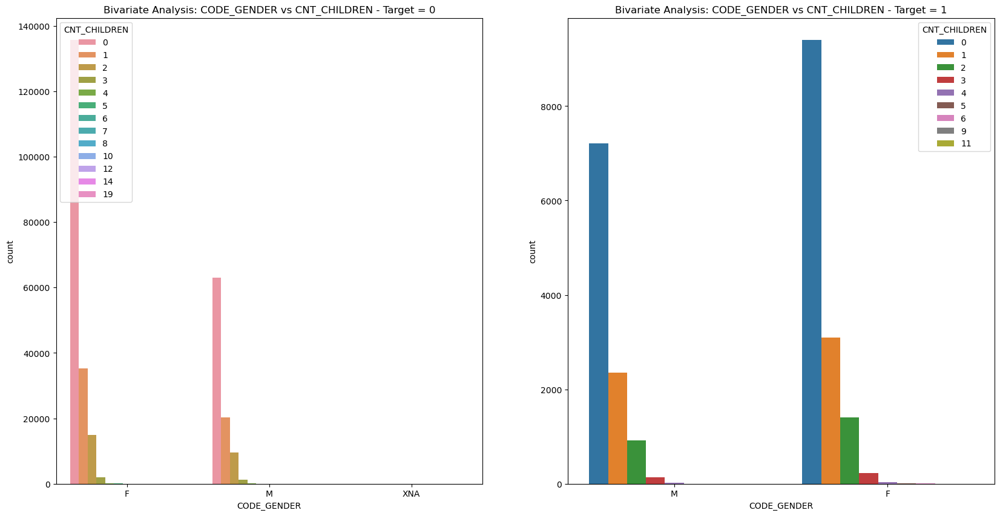

Skipping plot for CODE_GENDER vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for CODE_GENDER vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for CODE_GENDER vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CODE_GENDER vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


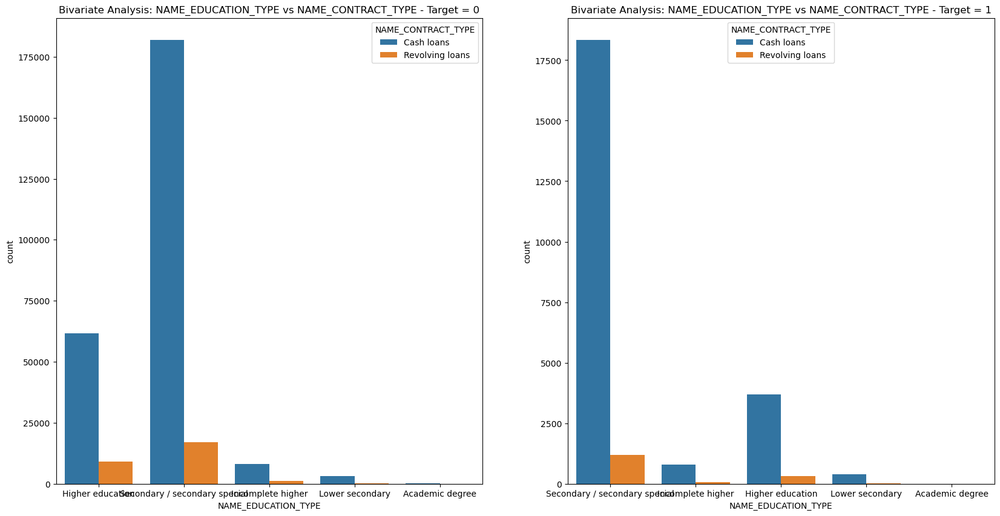

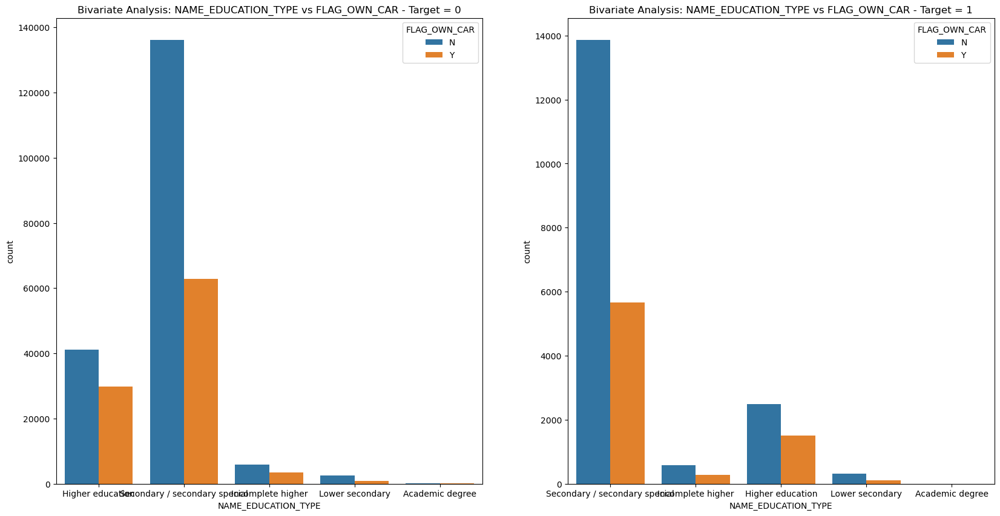

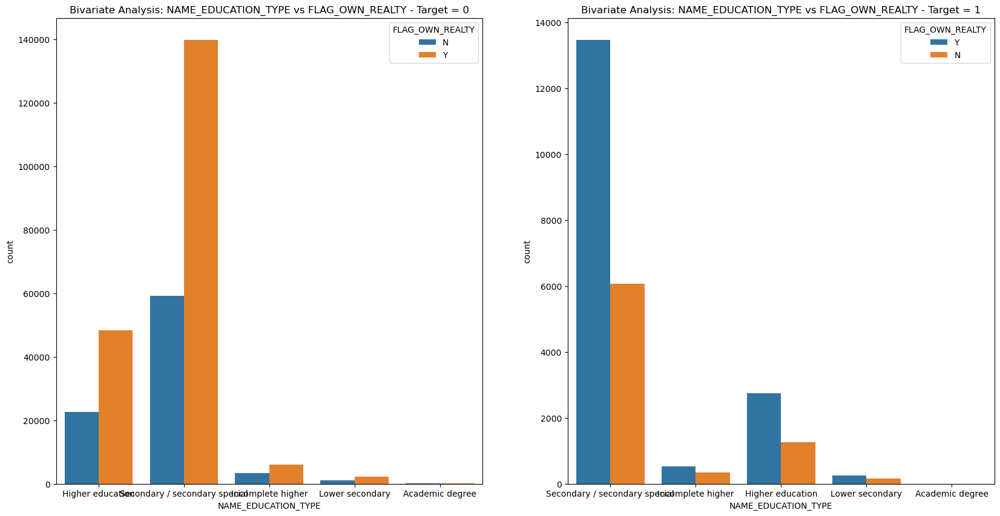

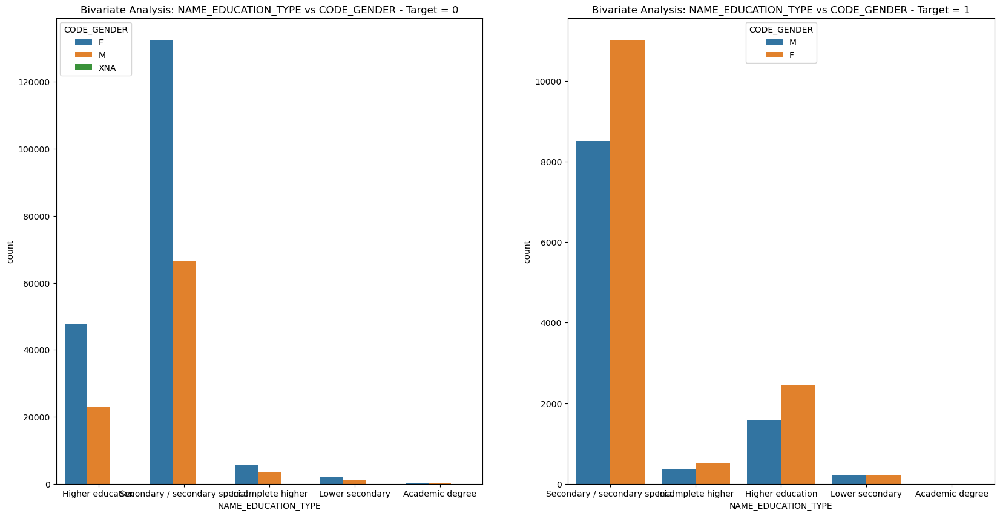

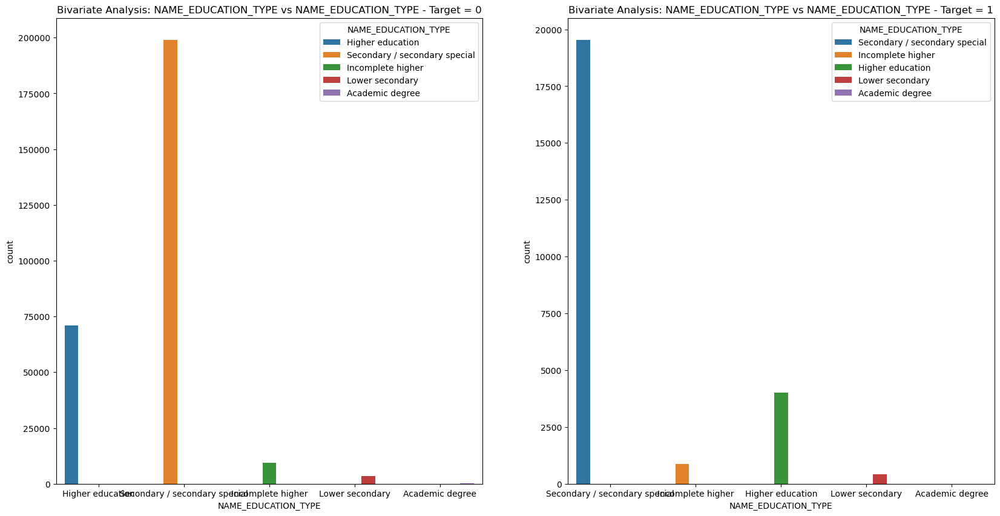

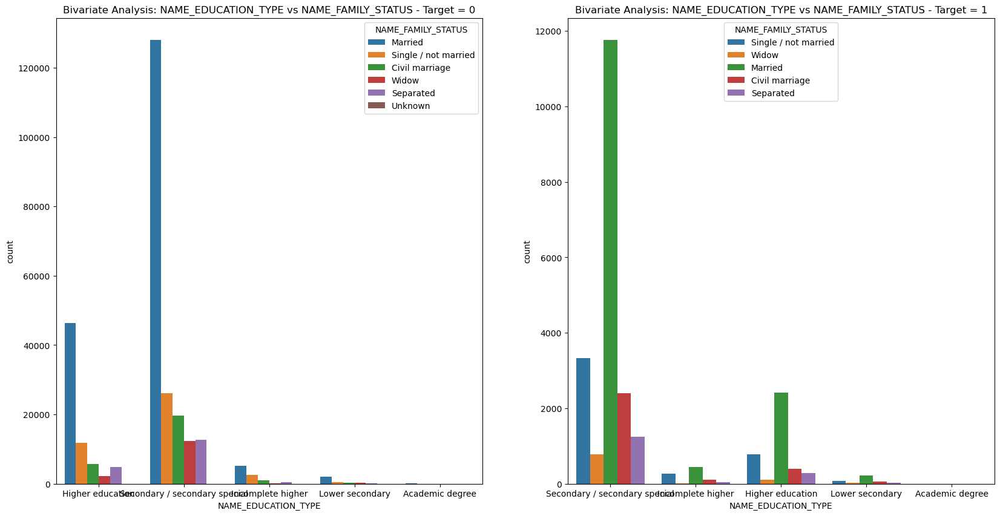

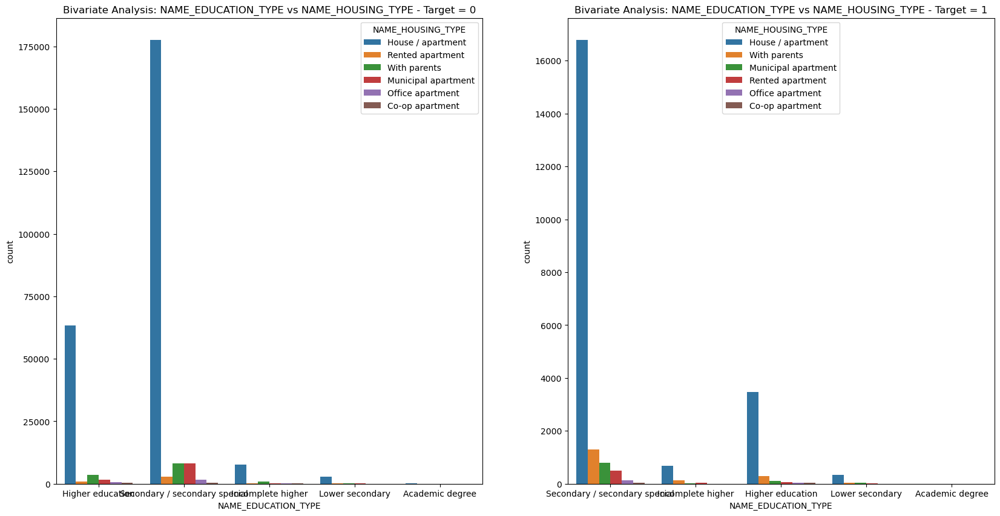

Skipping plot for NAME_EDUCATION_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


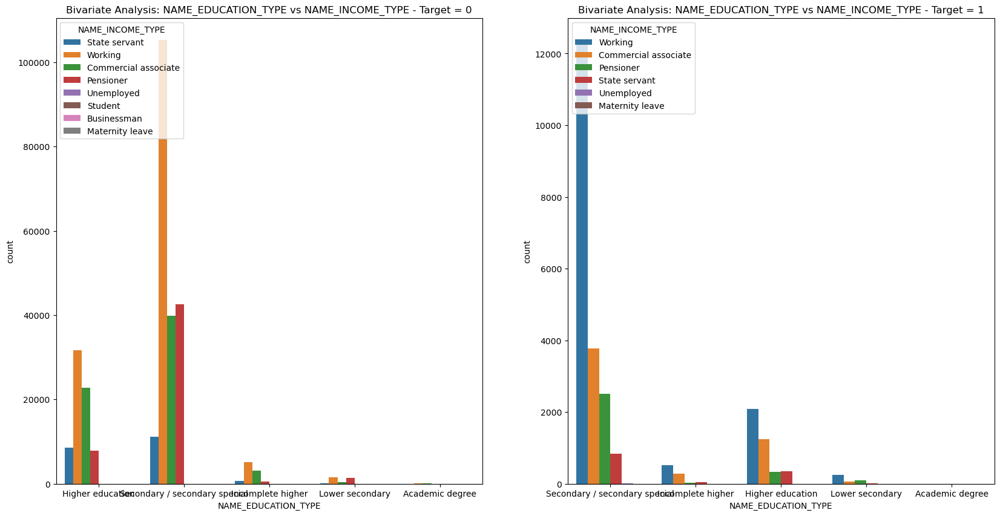

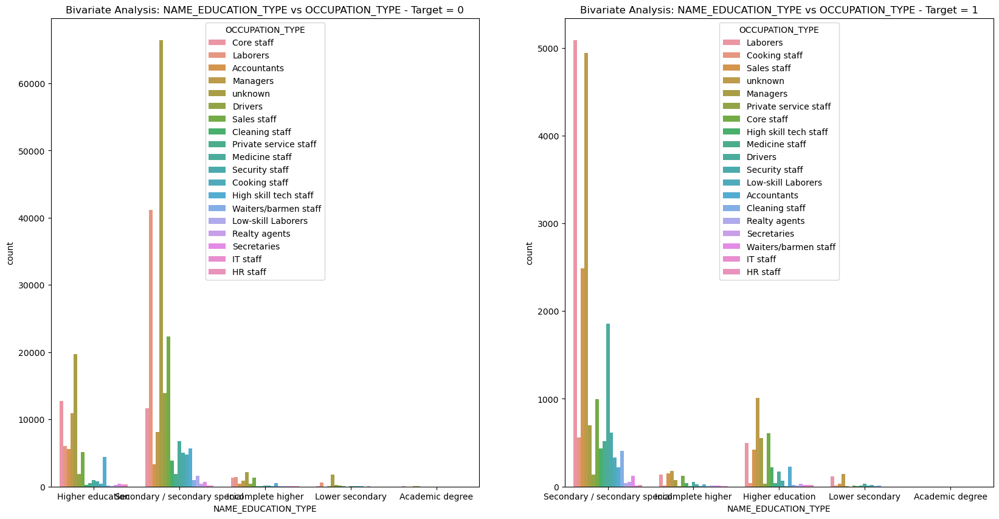

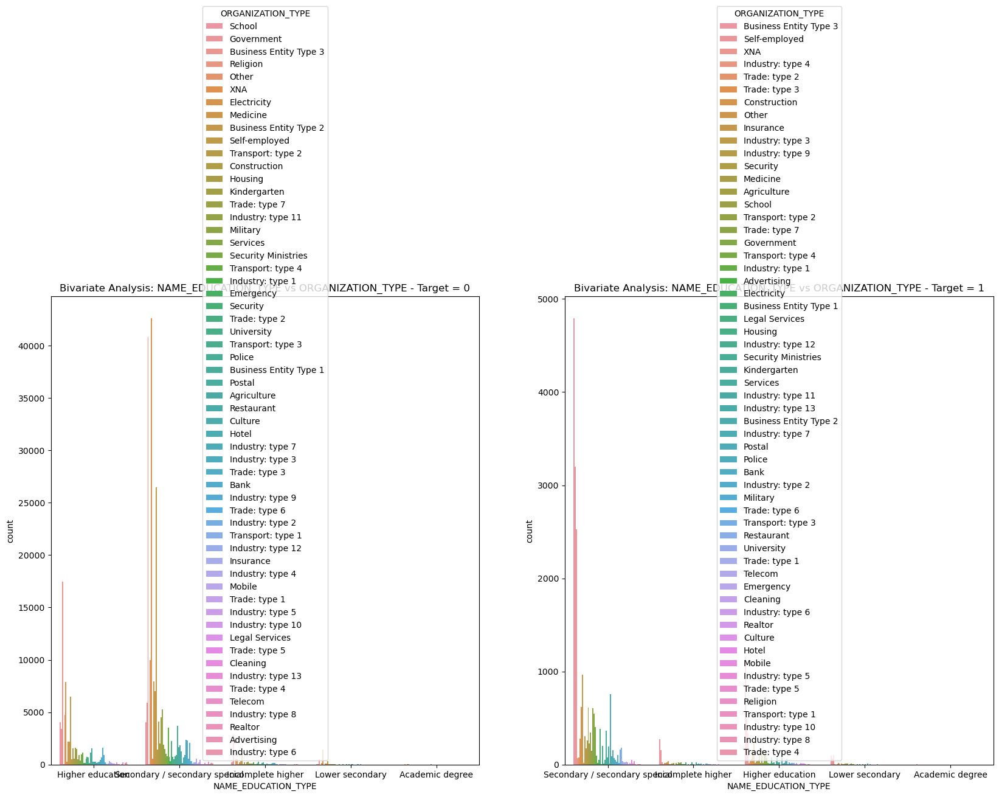

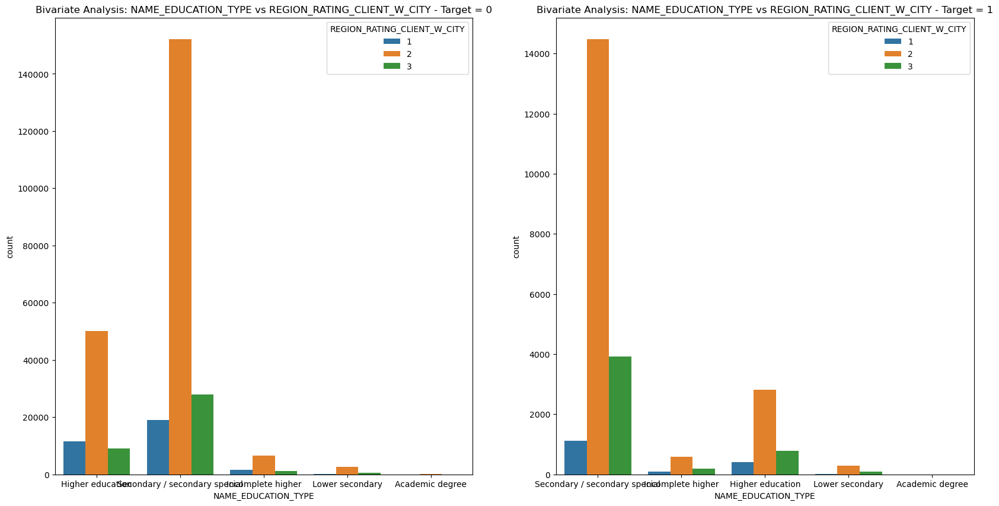

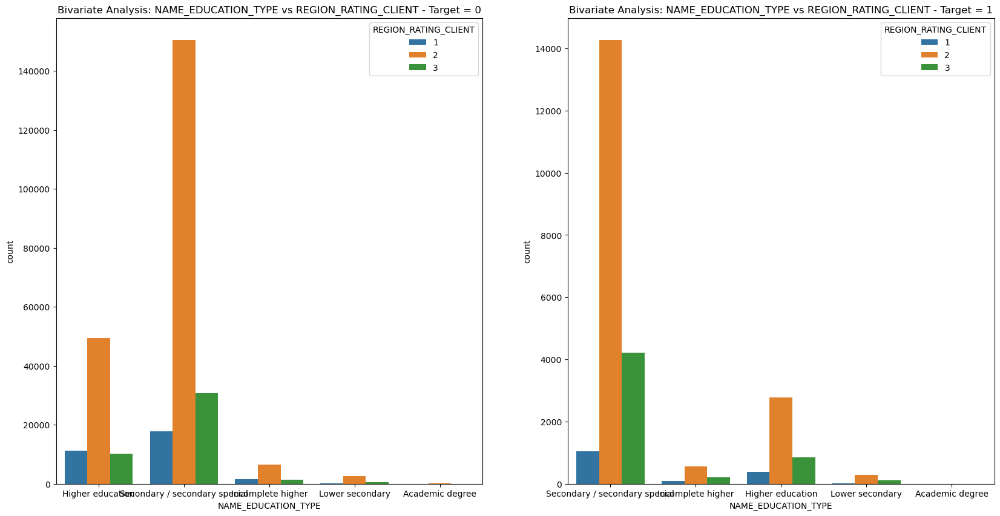

Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


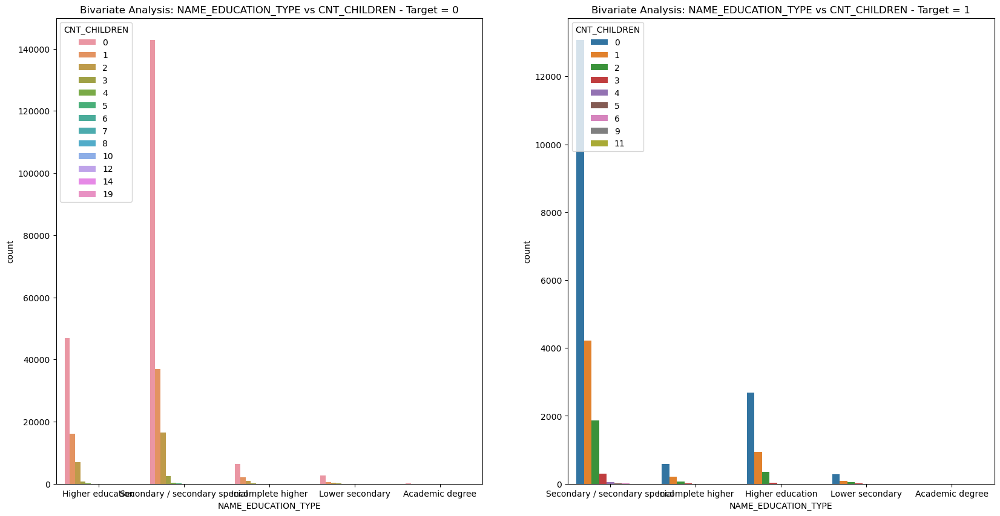

Skipping plot for NAME_EDUCATION_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_EDUCATION_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


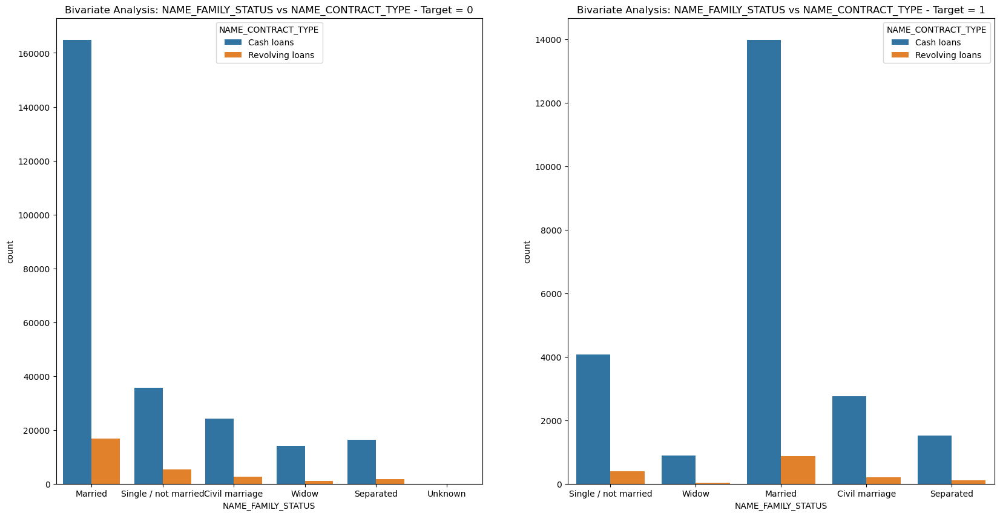

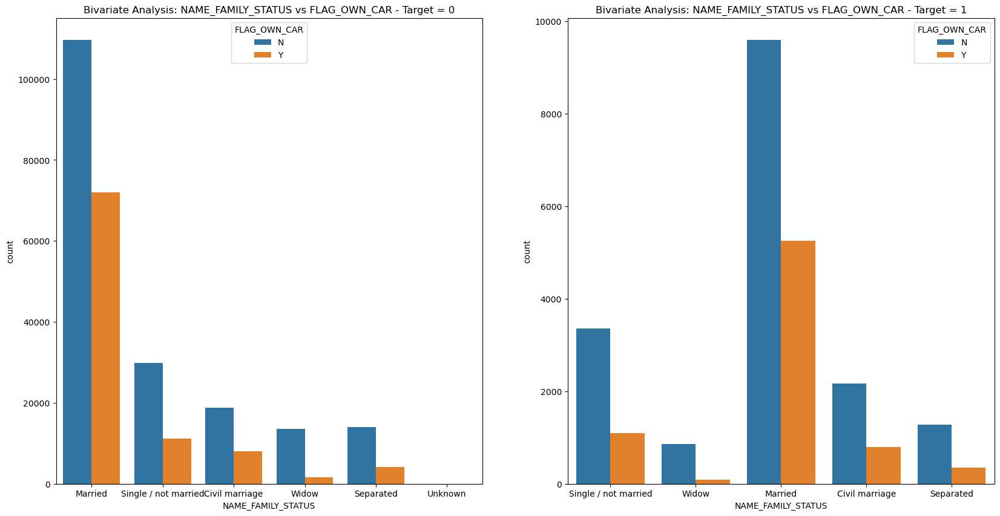

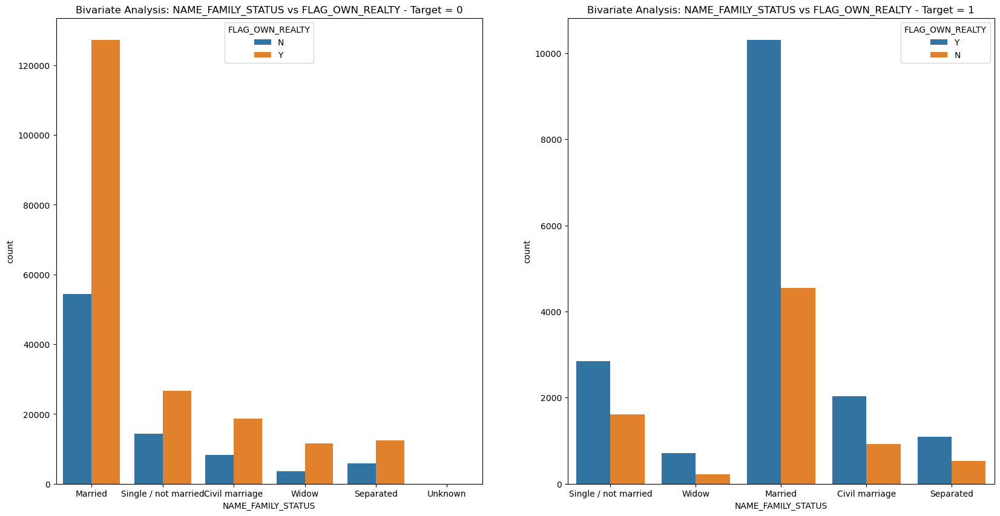

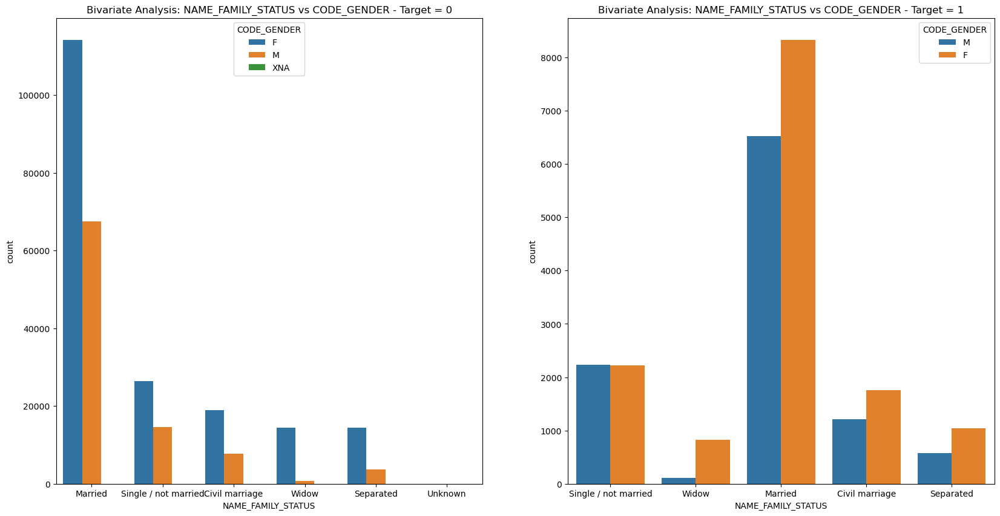

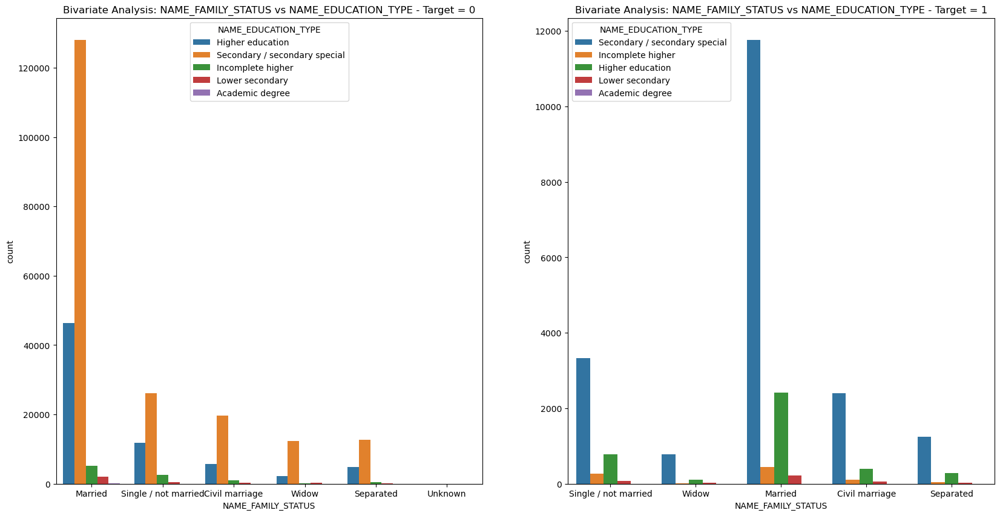

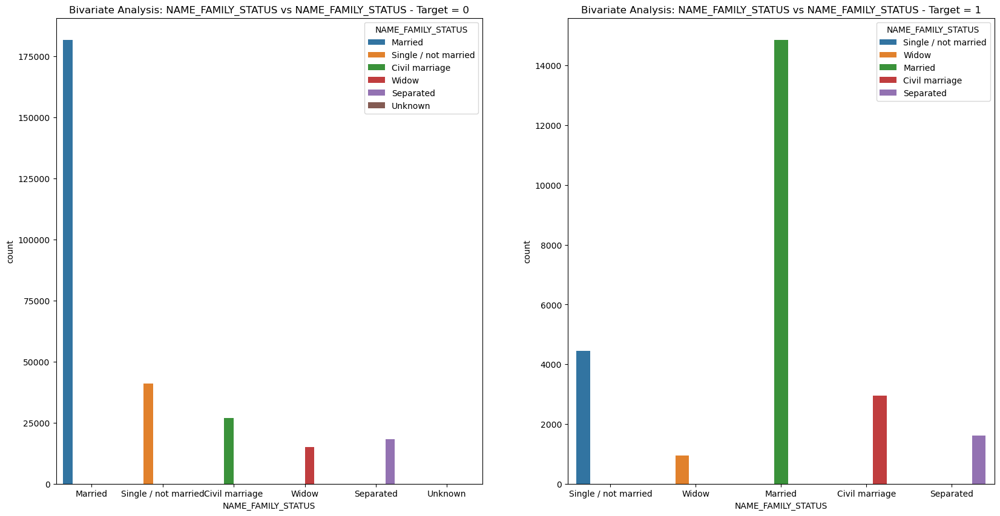

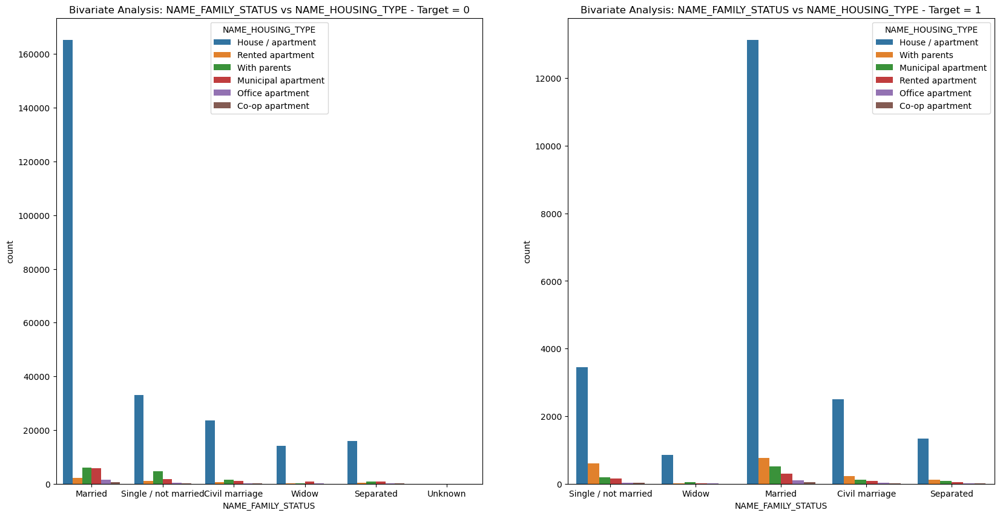

Skipping plot for NAME_FAMILY_STATUS vs NAME_TYPE_SUITE due to presence of methods in data.


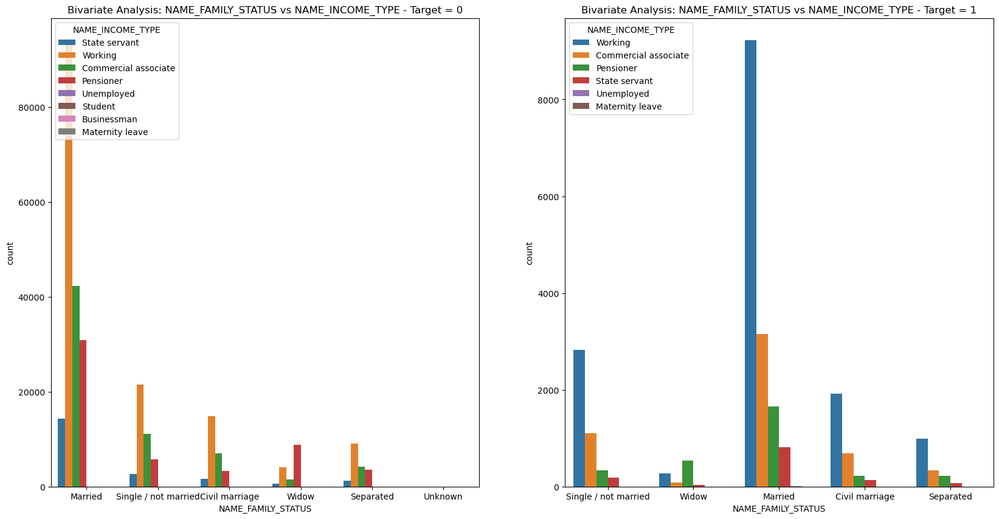

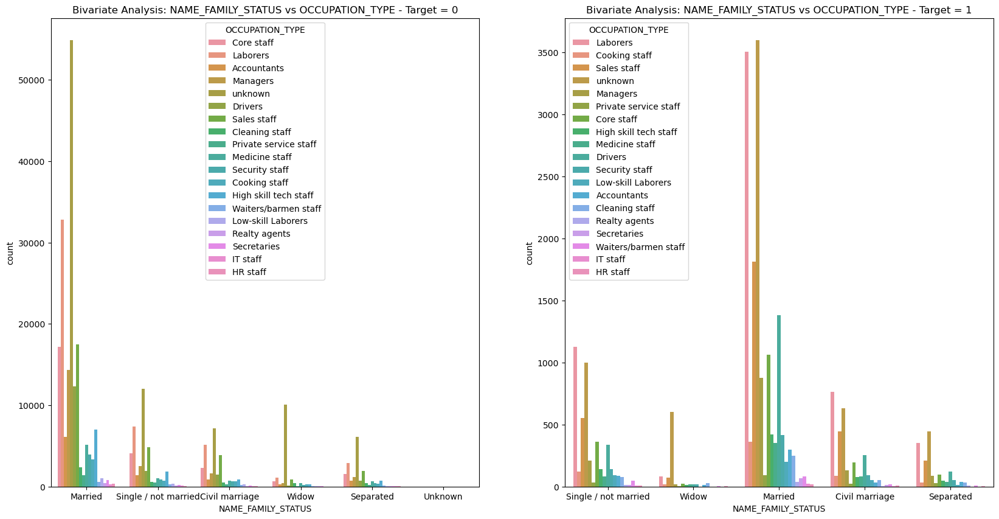

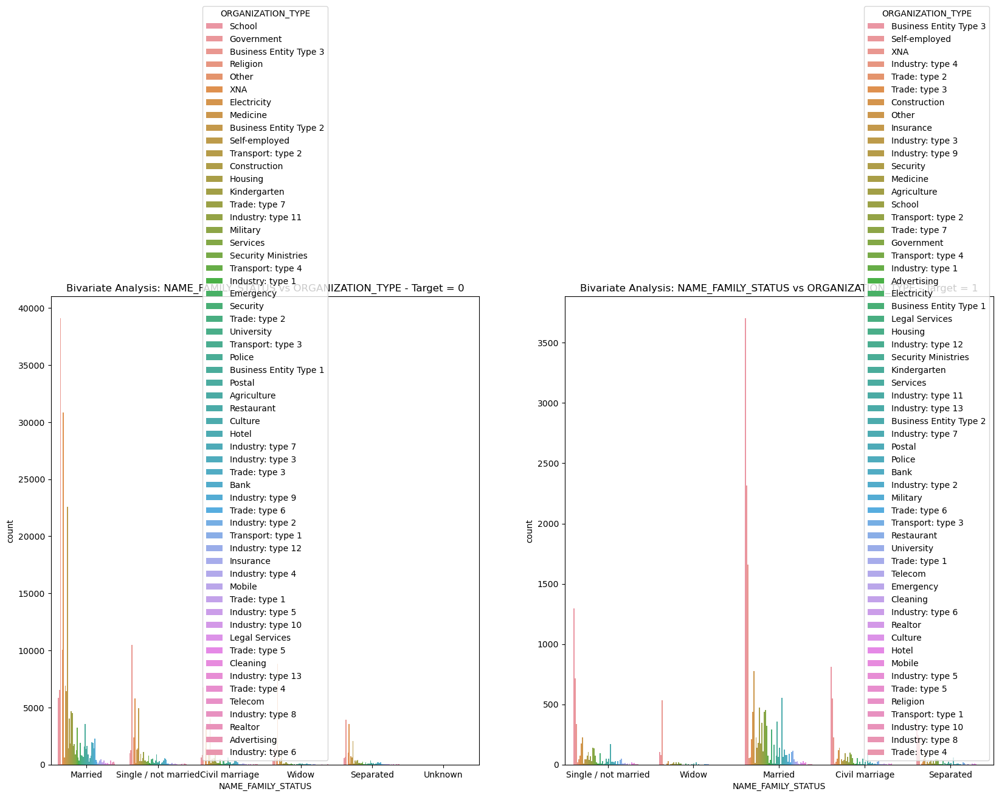

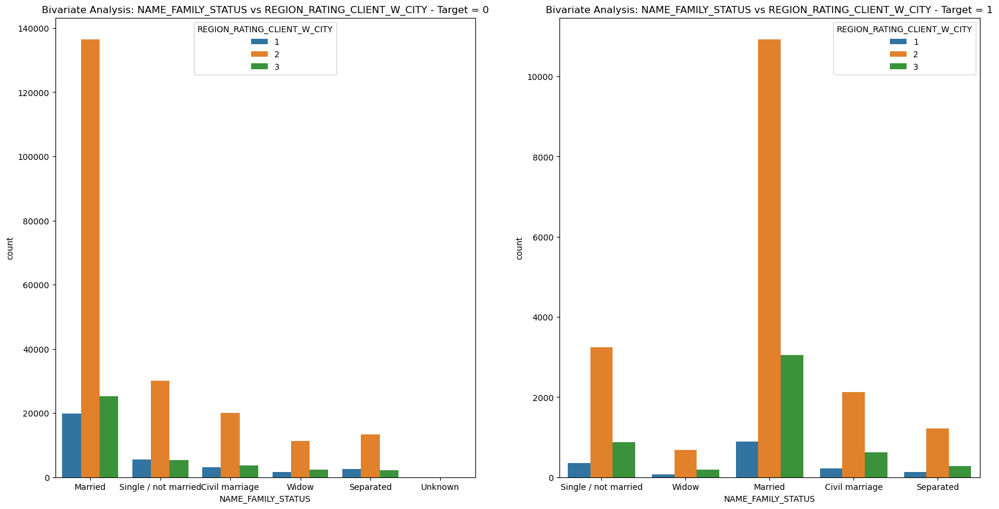

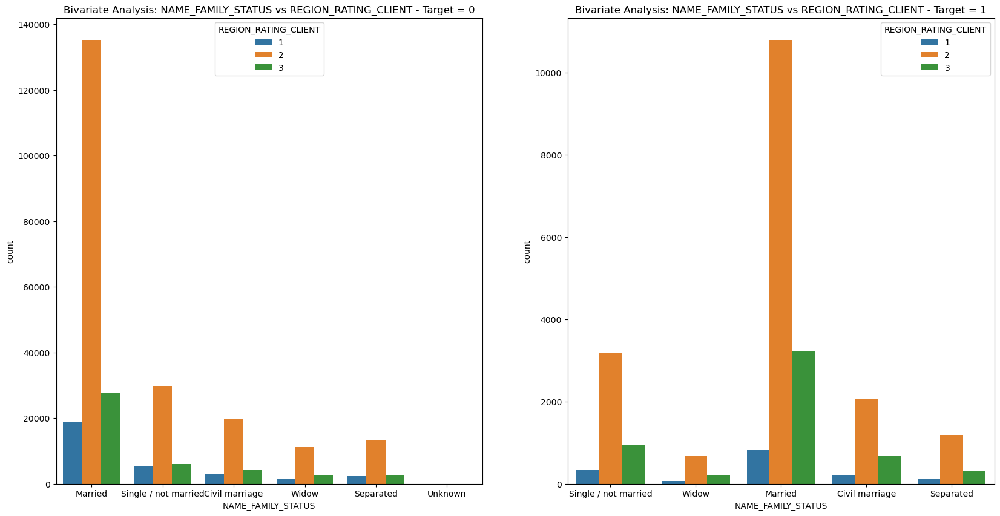

Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


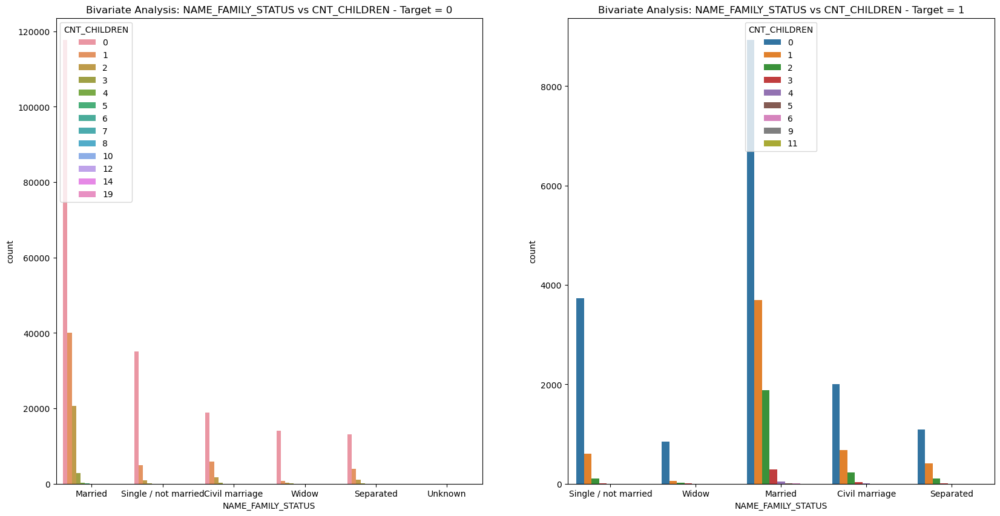

Skipping plot for NAME_FAMILY_STATUS vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_FAMILY_STATUS vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


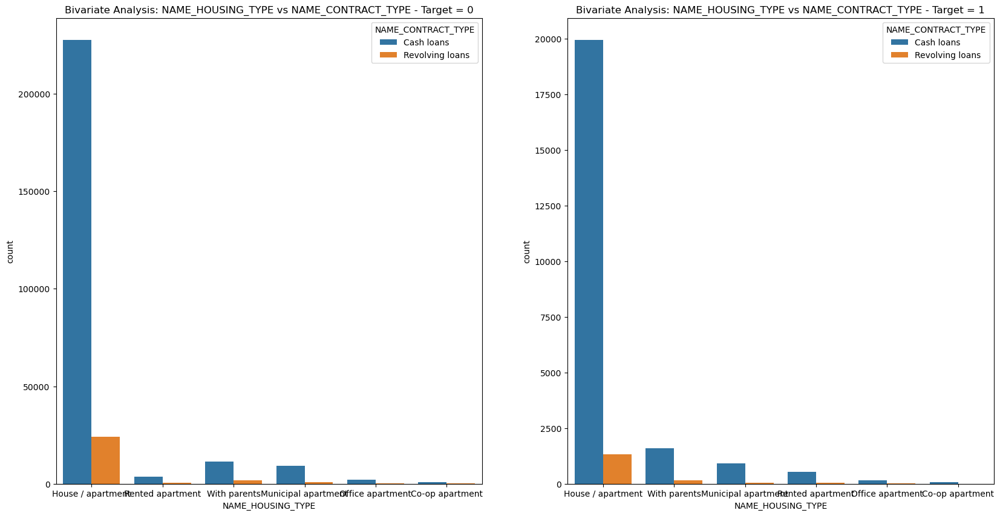

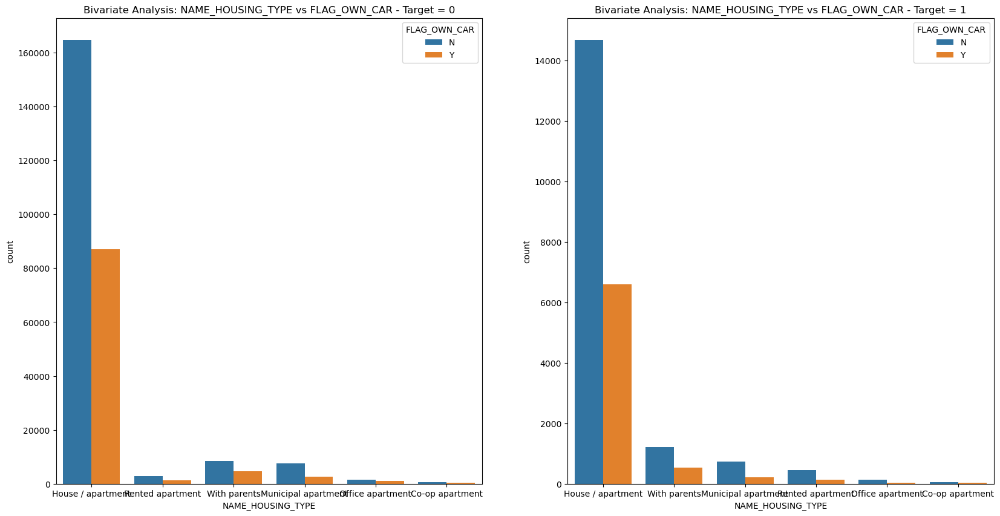

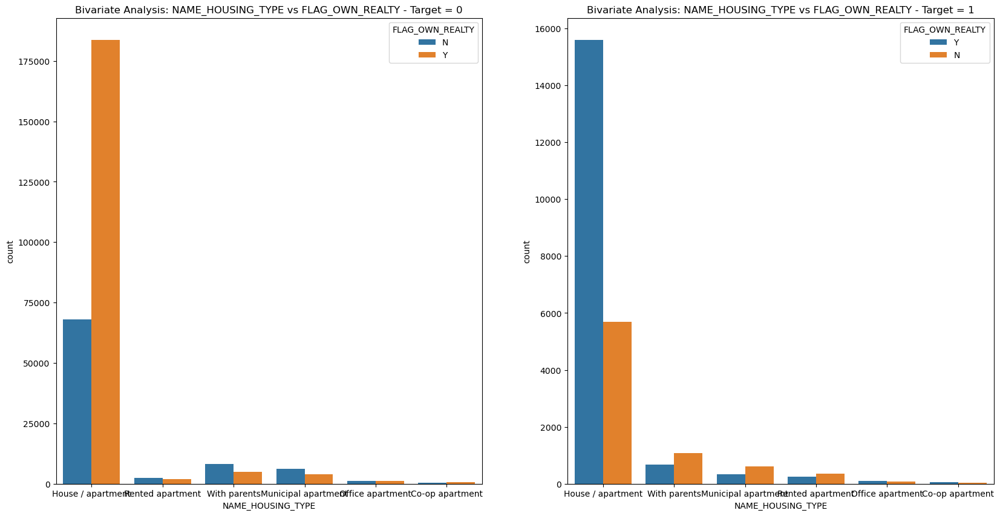

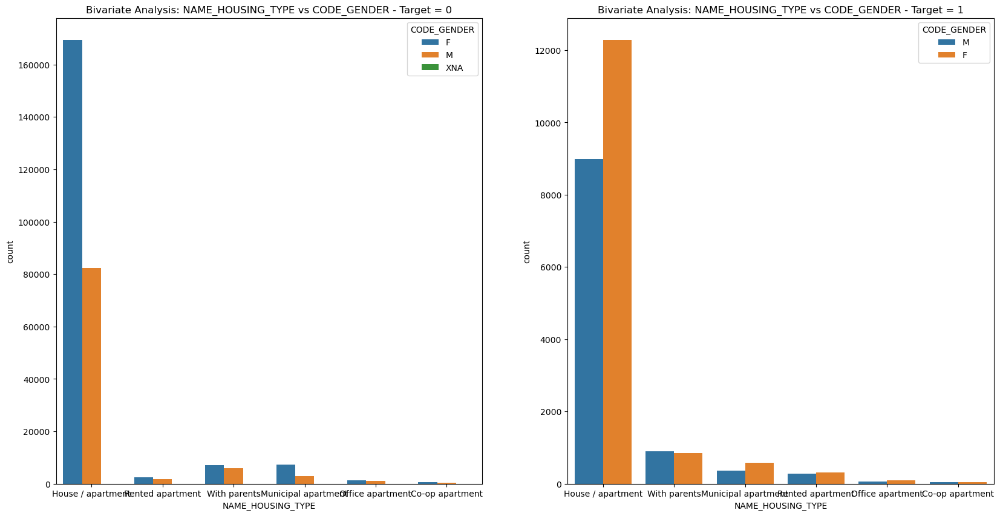

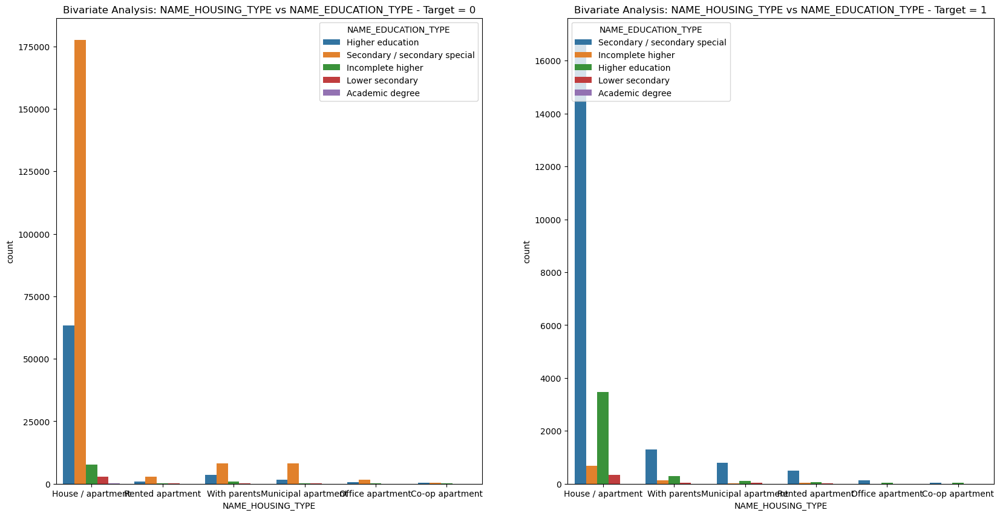

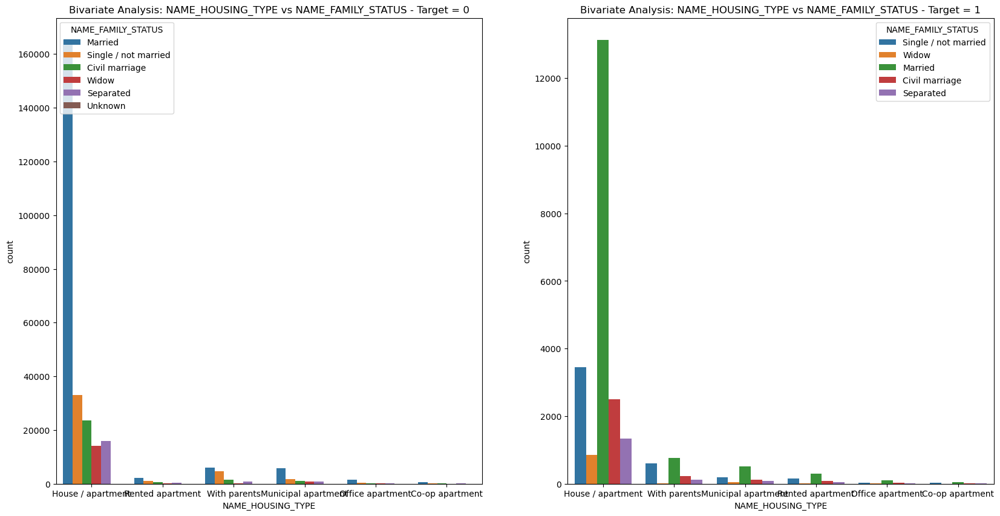

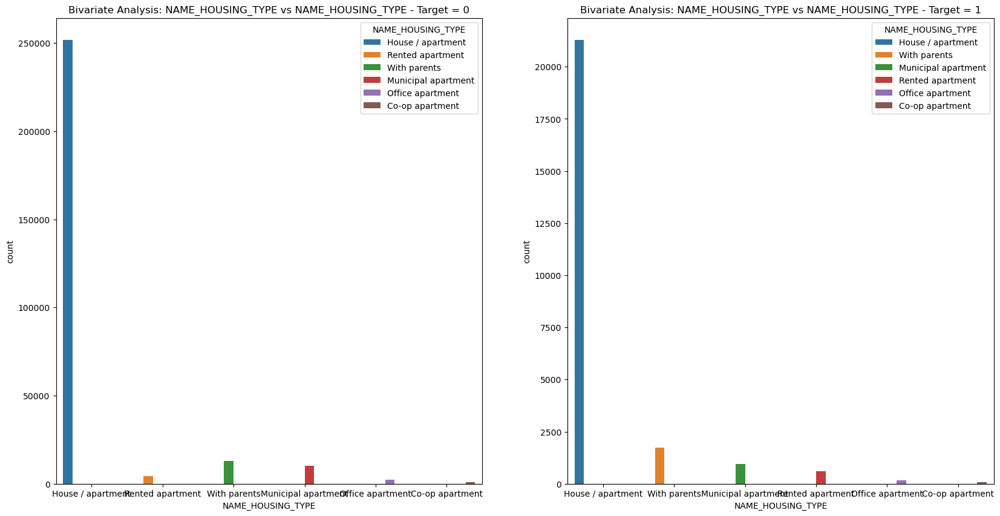

Skipping plot for NAME_HOUSING_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


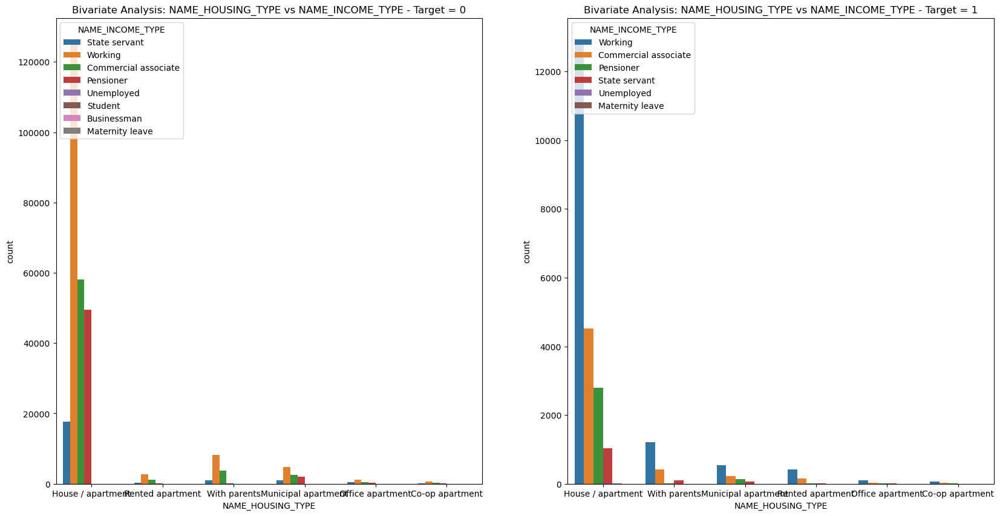

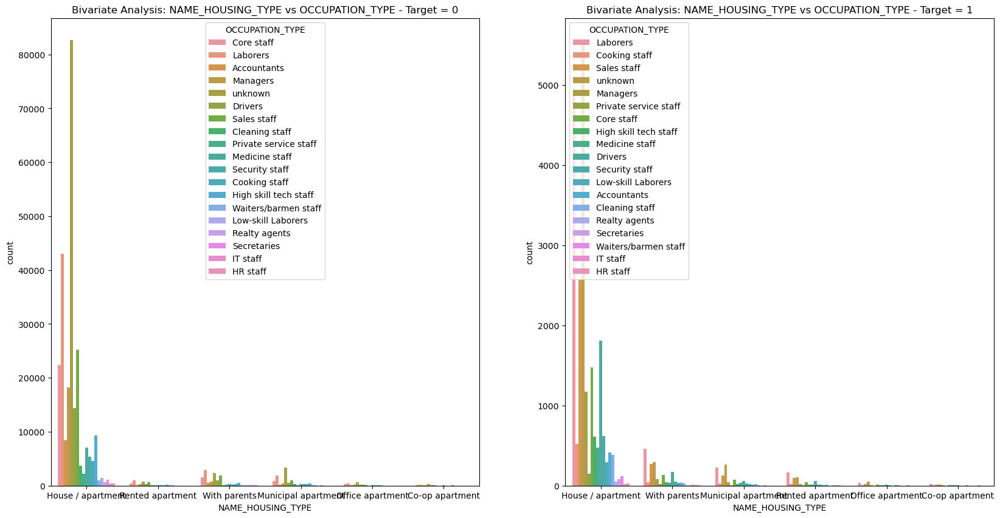

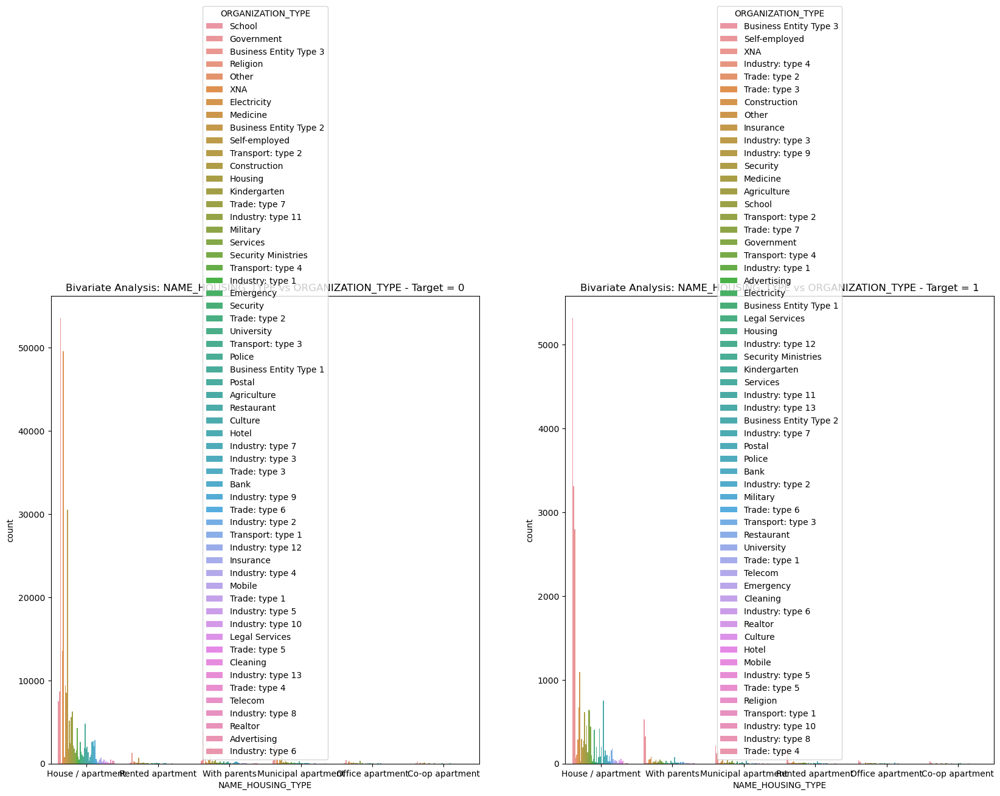

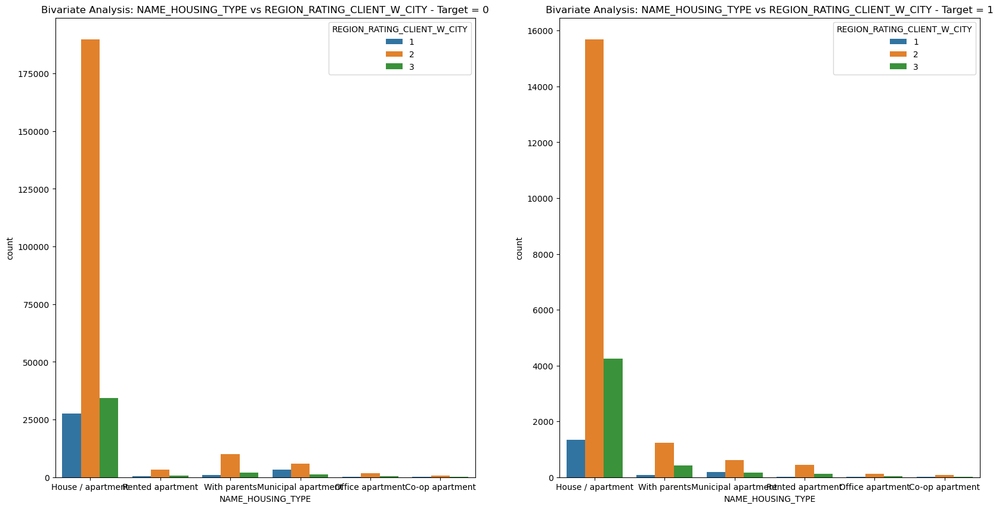

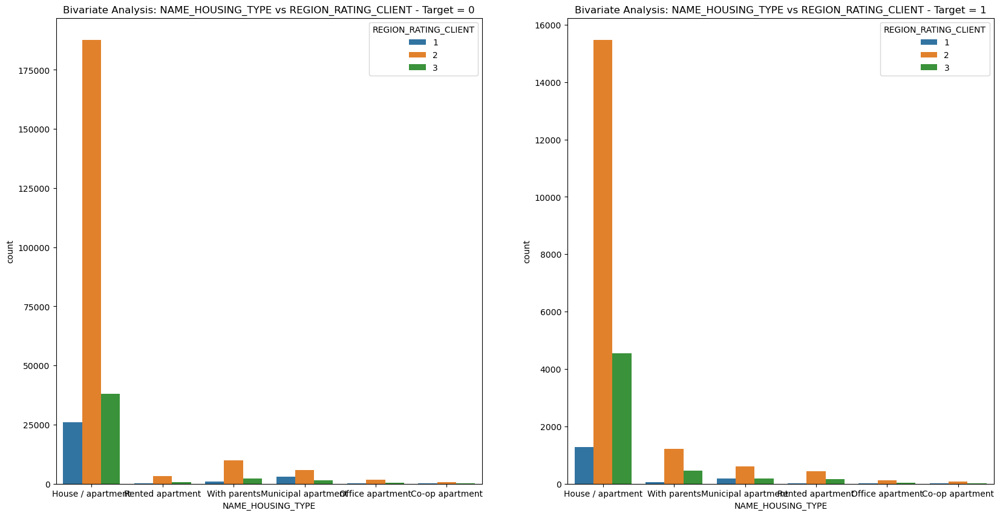

Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


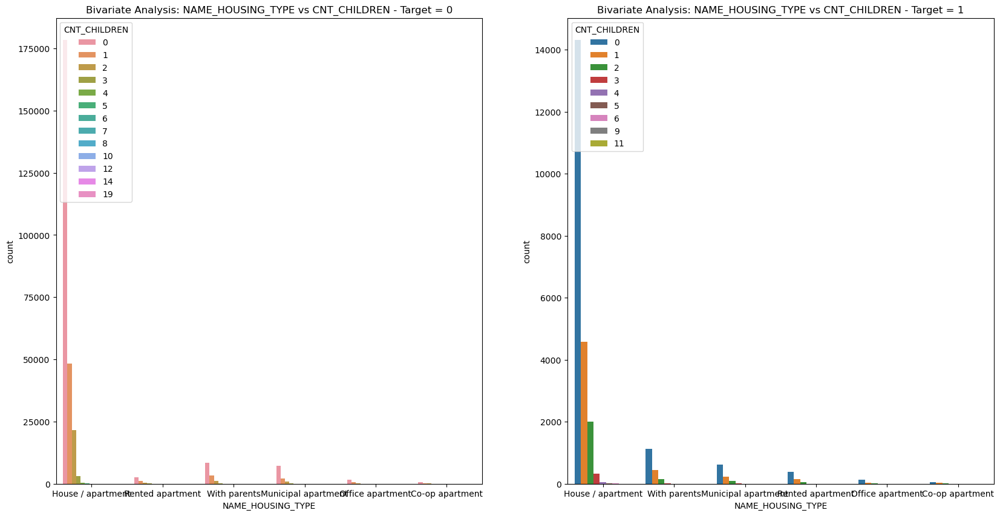

Skipping plot for NAME_HOUSING_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_HOUSING_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs NAME_CONTRACT_TYPE due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs FLAG_OWN_CAR due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs FLAG_OWN_REALTY due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs CODE_GENDER due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs NAME_EDUCATION_TYPE due to presence of methods in data.
Skipping plot for NAME_TYPE_SUITE vs NAME_FAMILY_STATUS due t

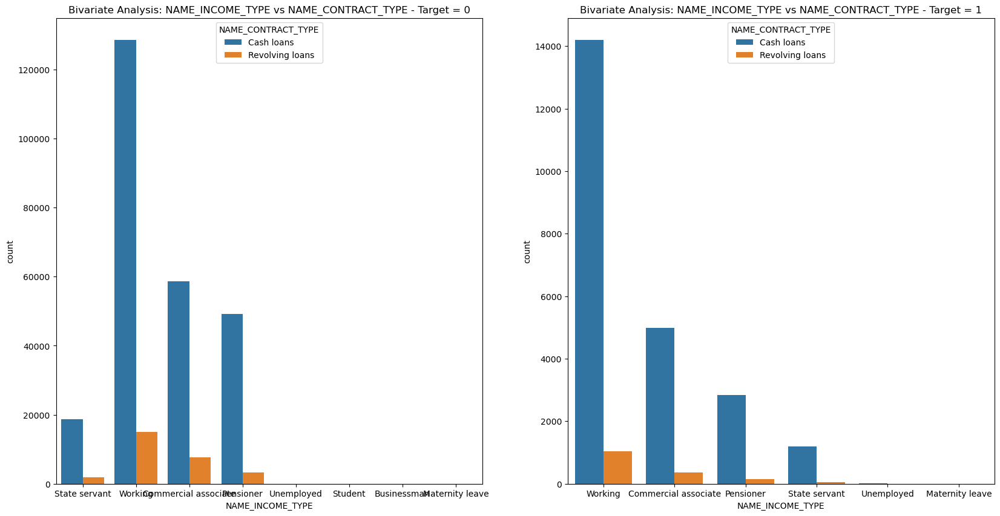

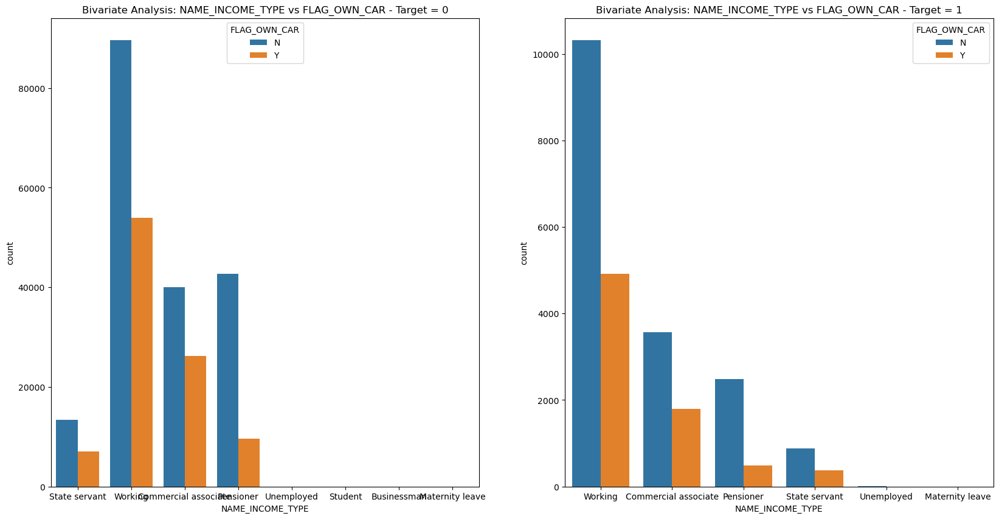

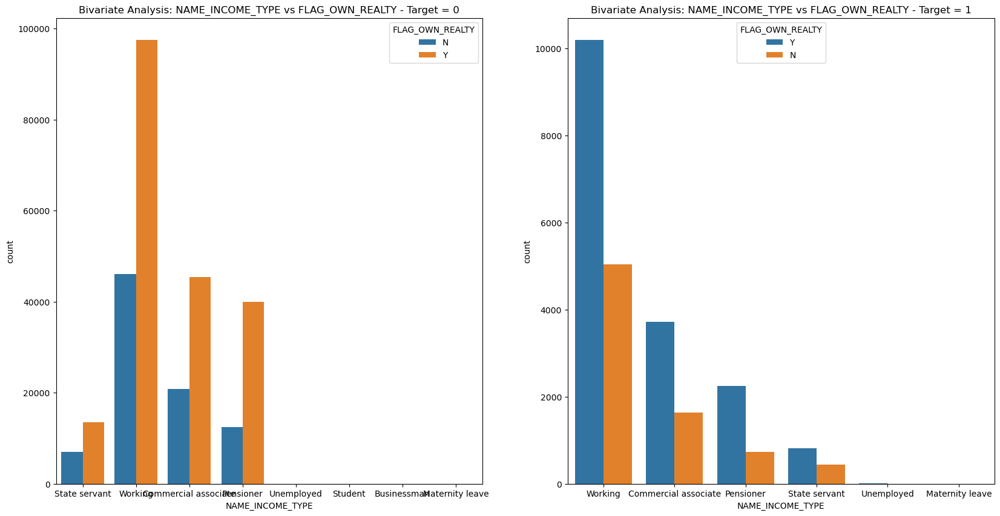

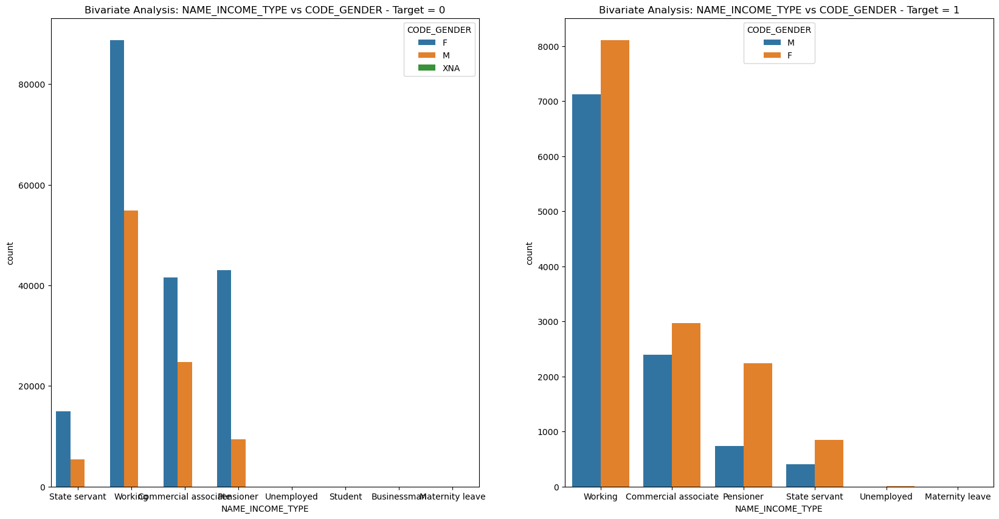

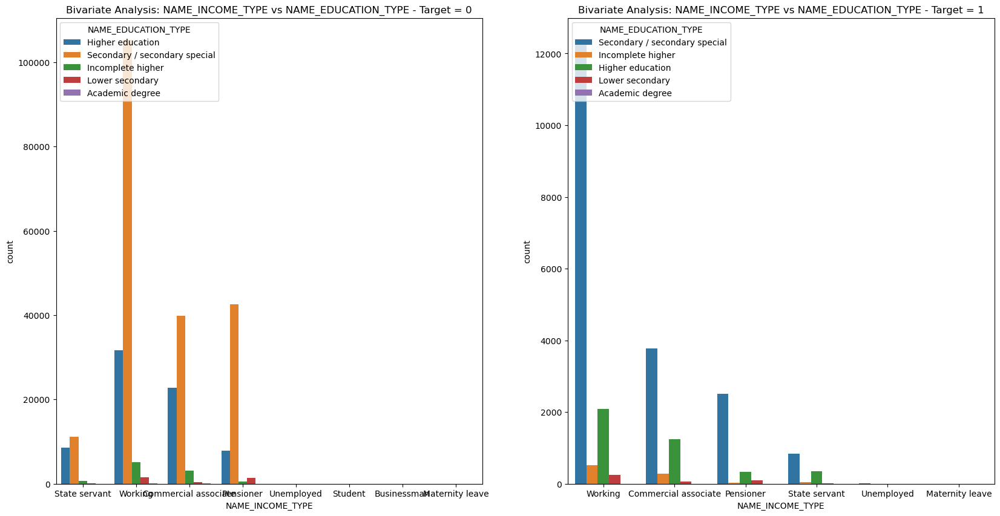

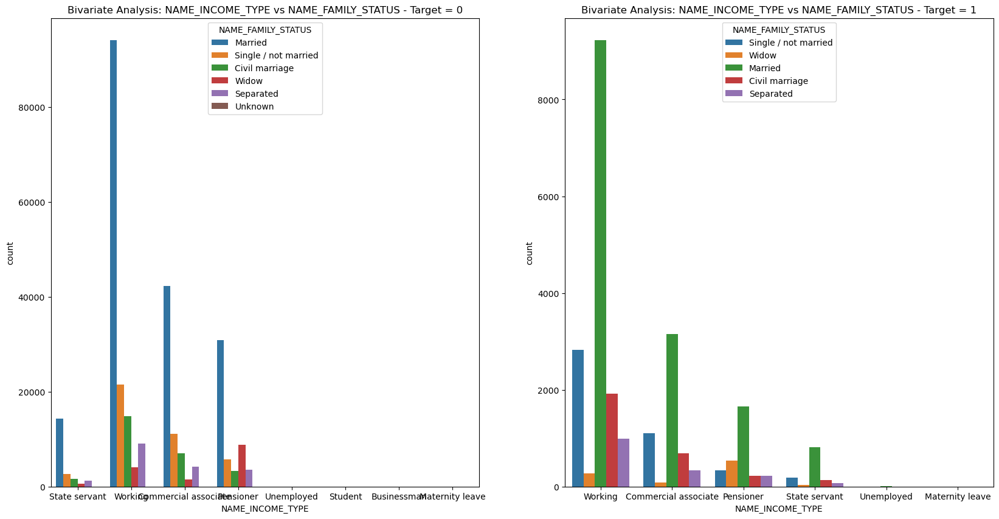

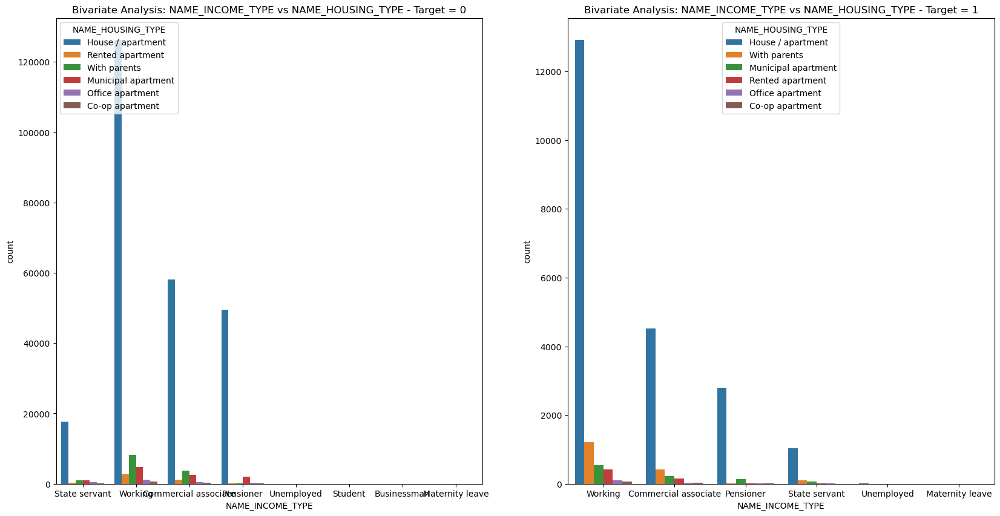

Skipping plot for NAME_INCOME_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


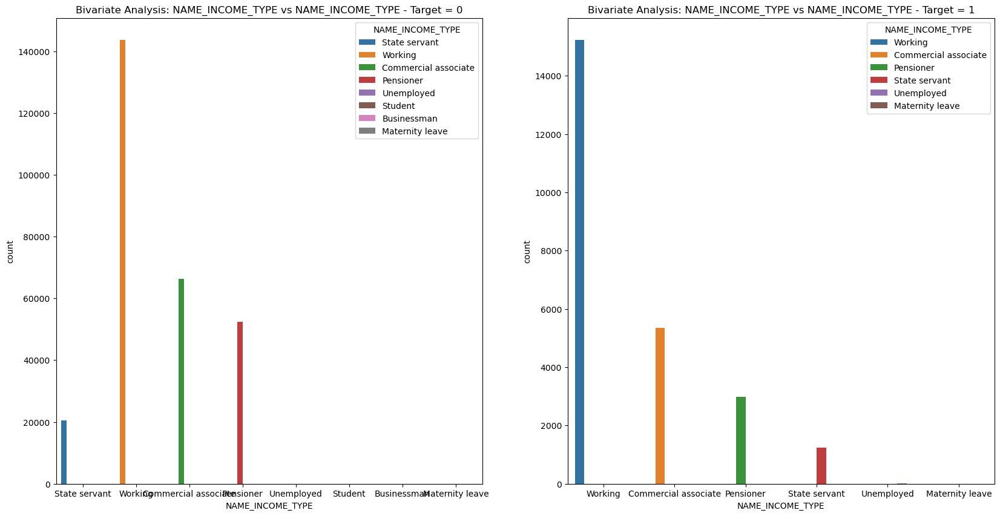

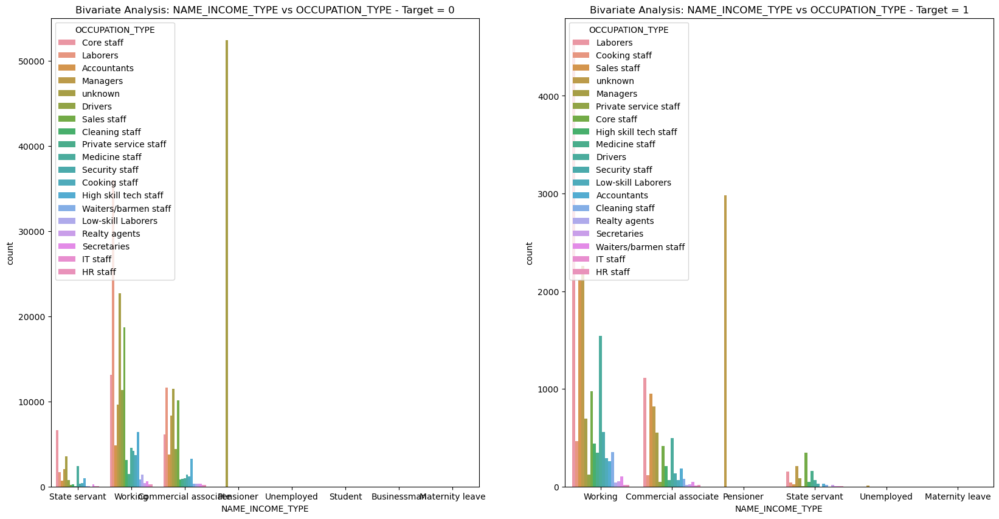

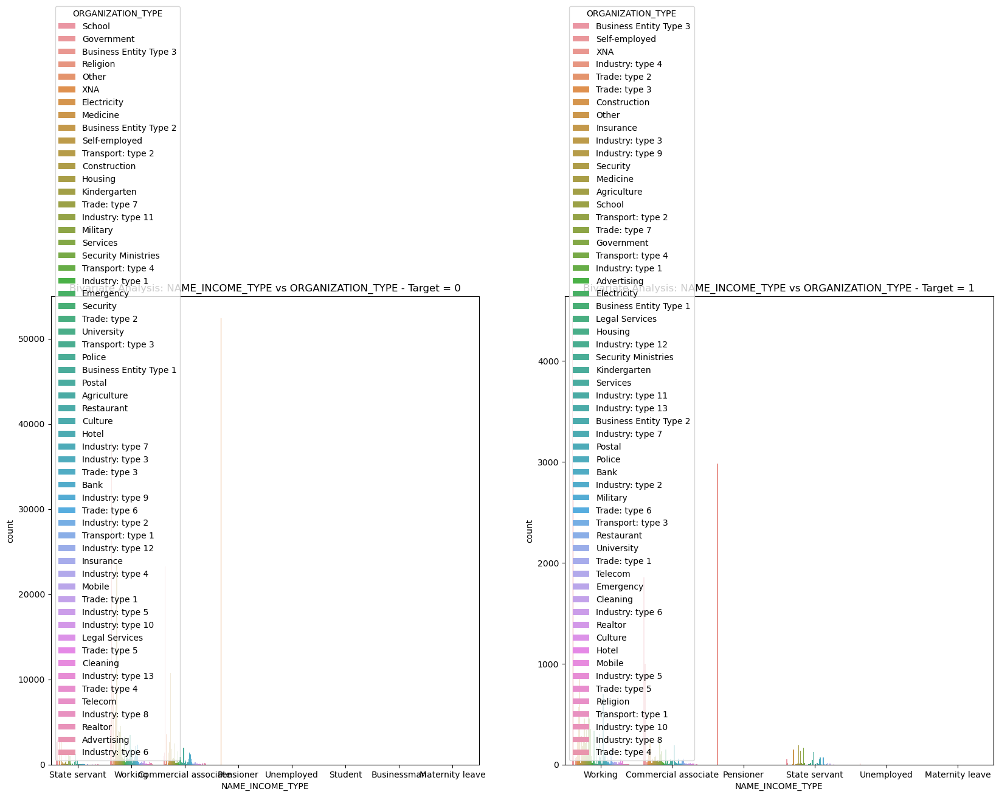

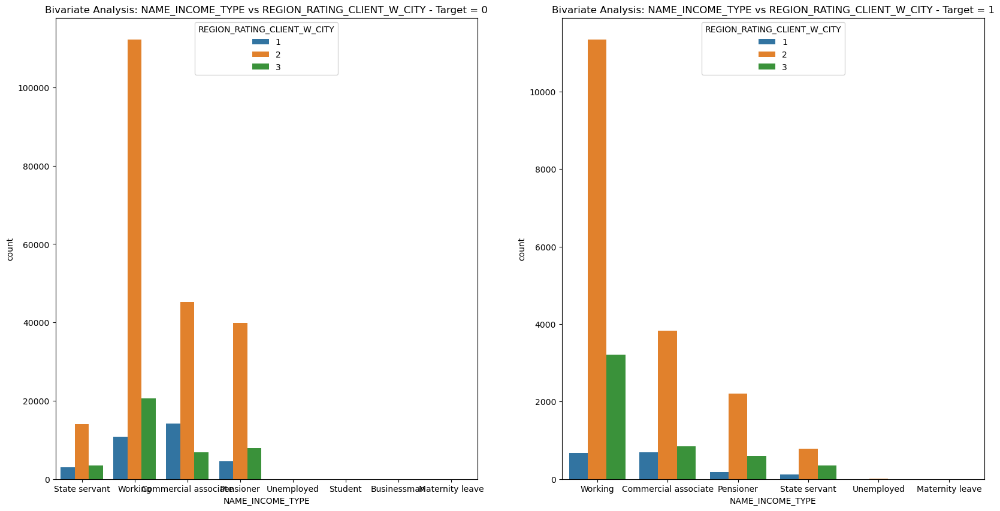

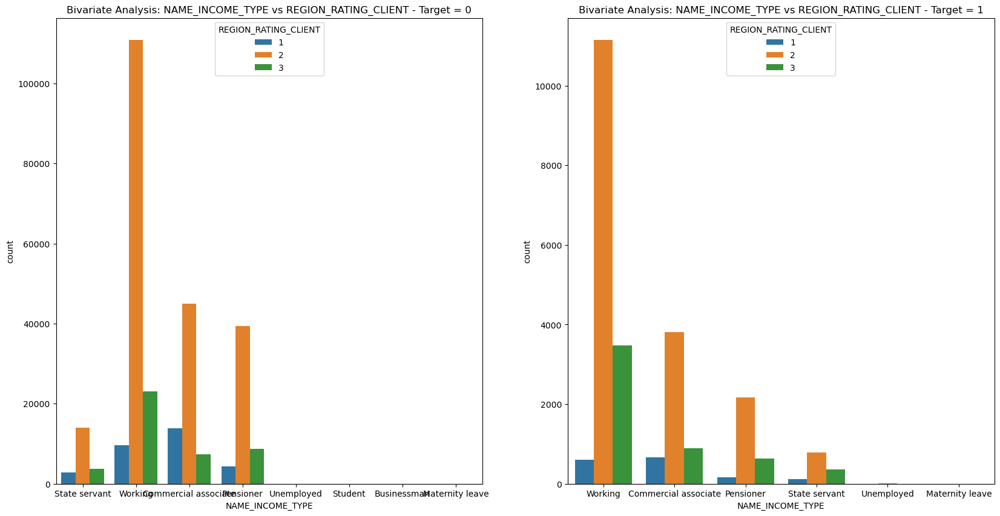

Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


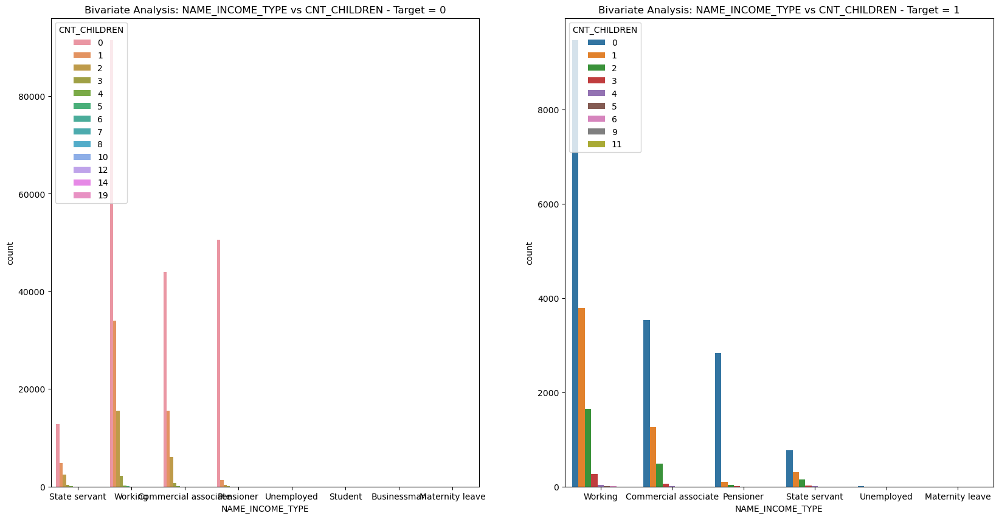

Skipping plot for NAME_INCOME_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for NAME_INCOME_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


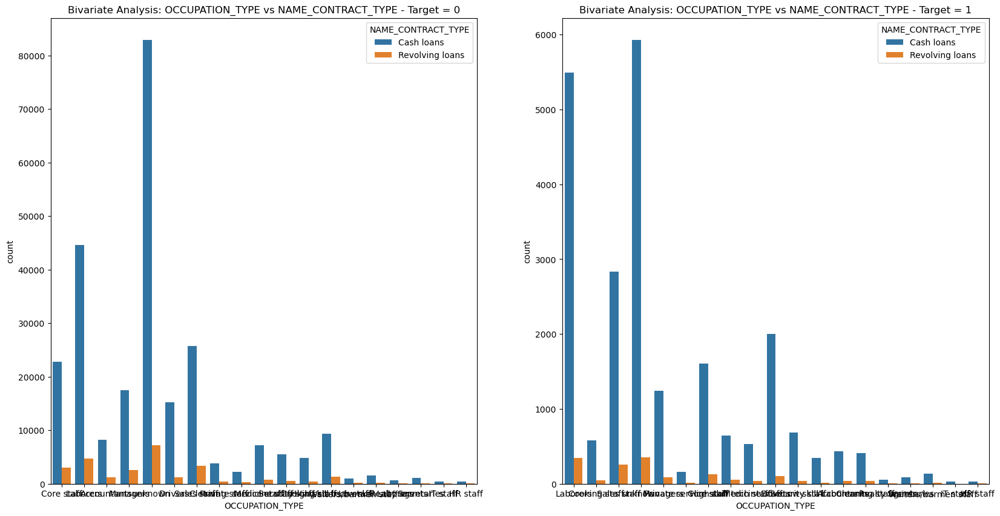

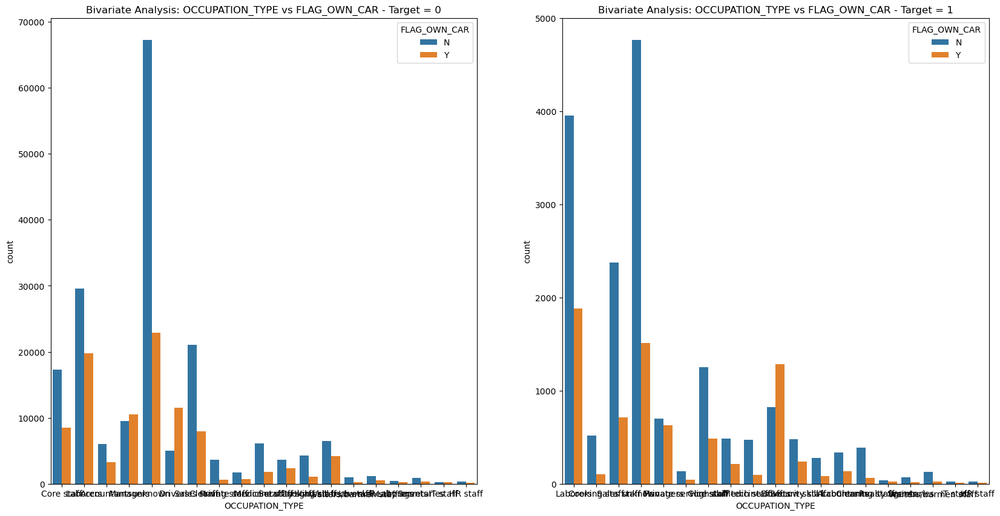

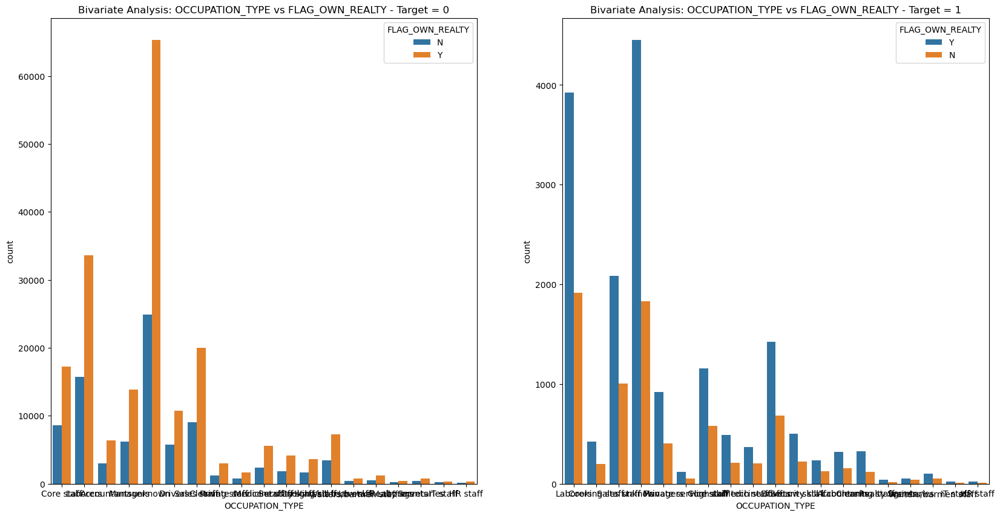

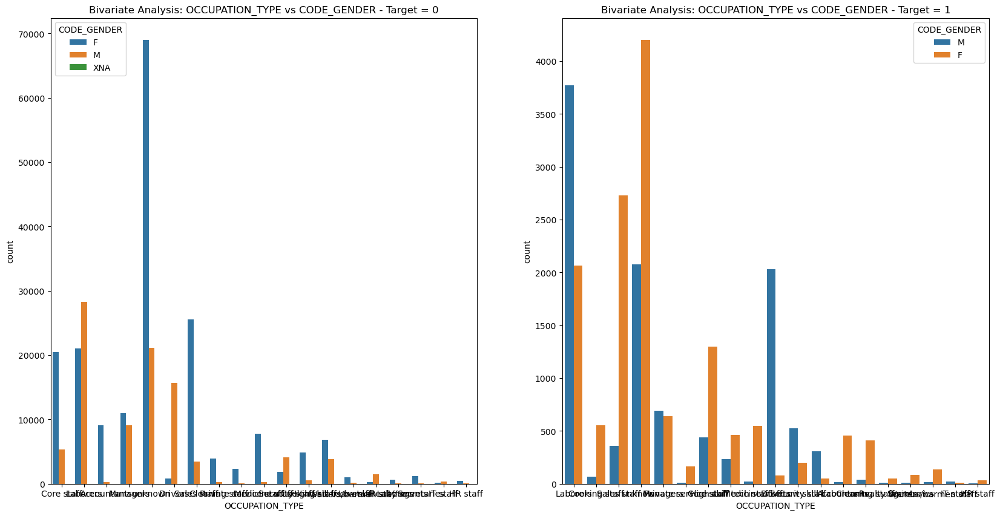

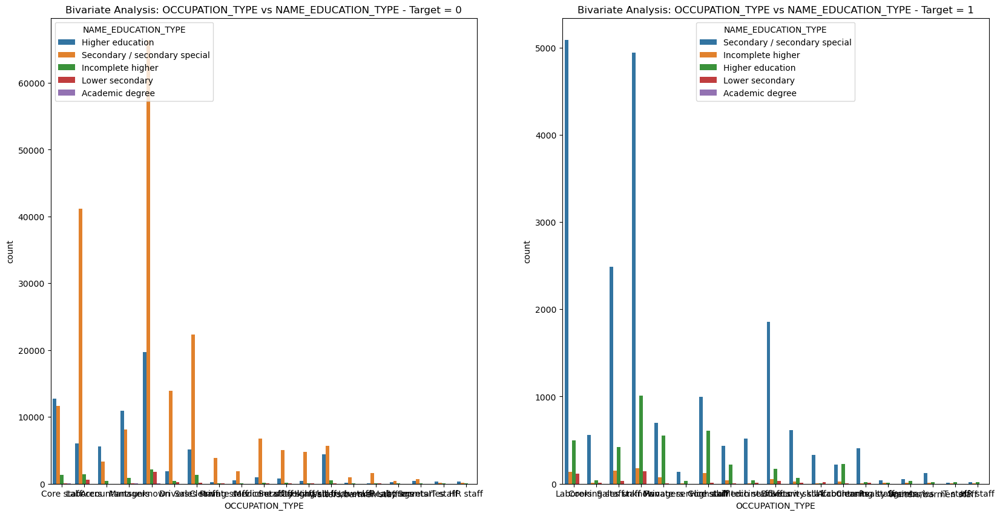

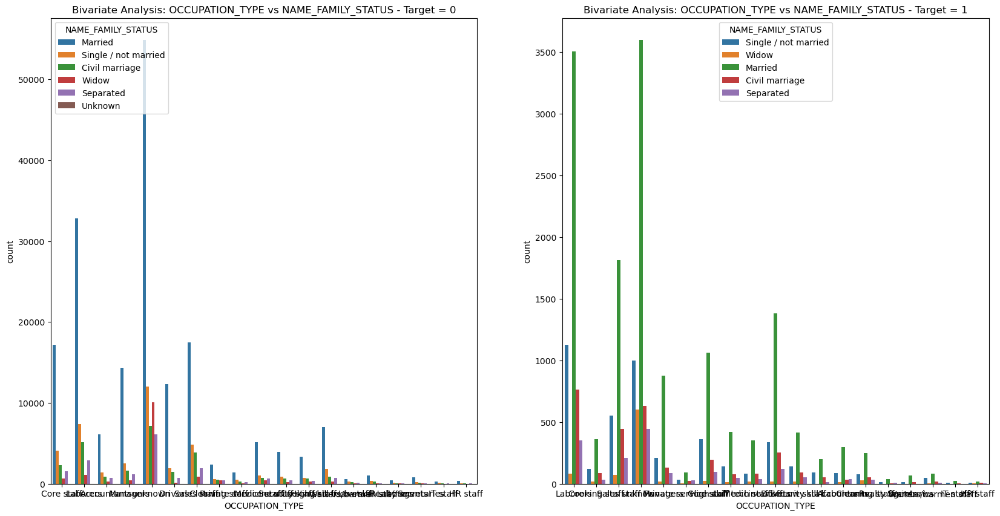

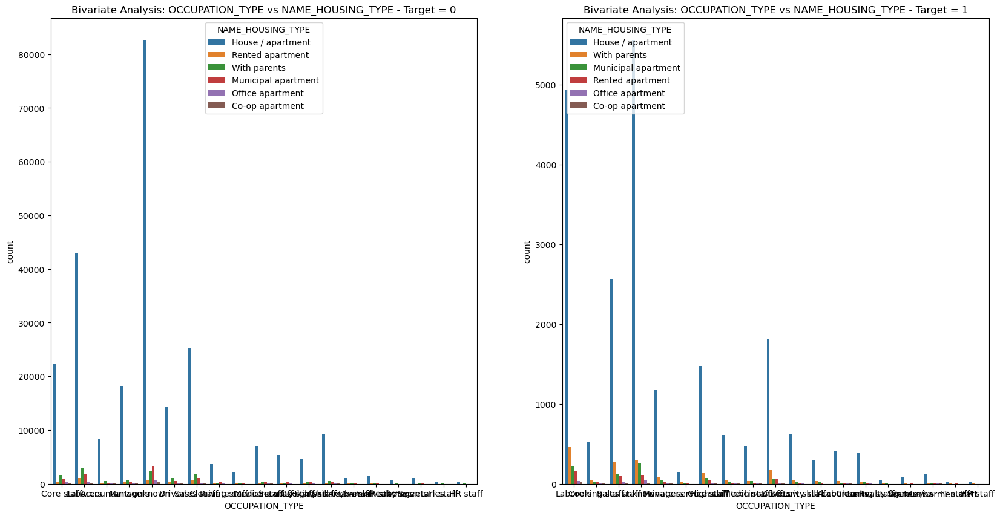

Skipping plot for OCCUPATION_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


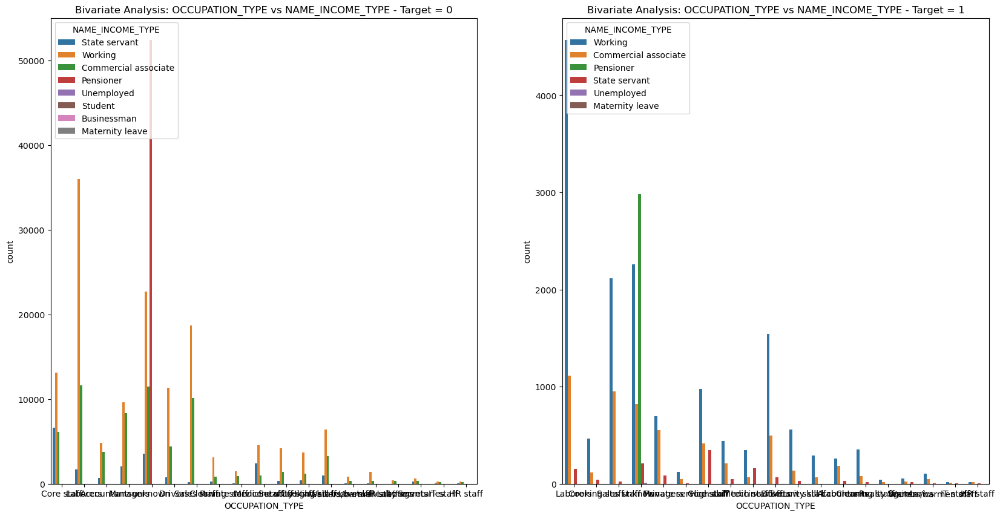

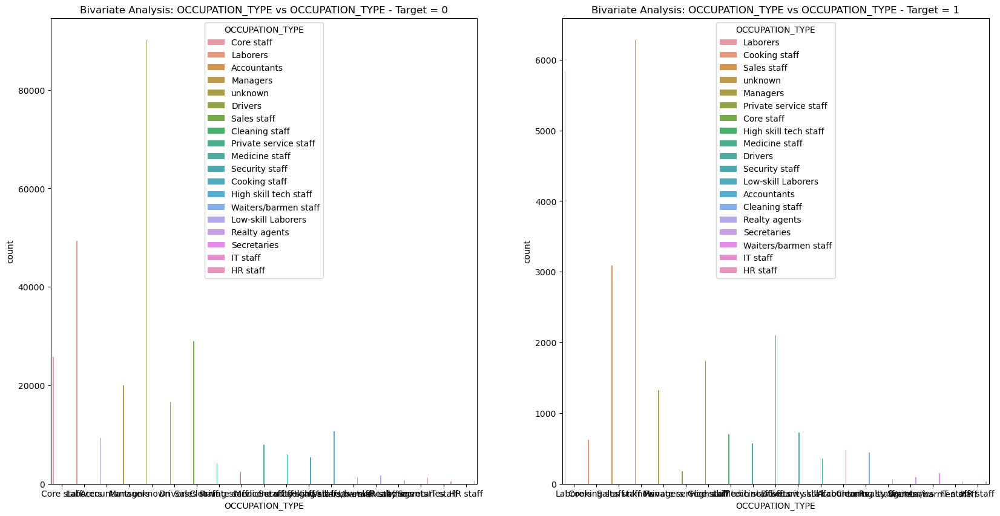

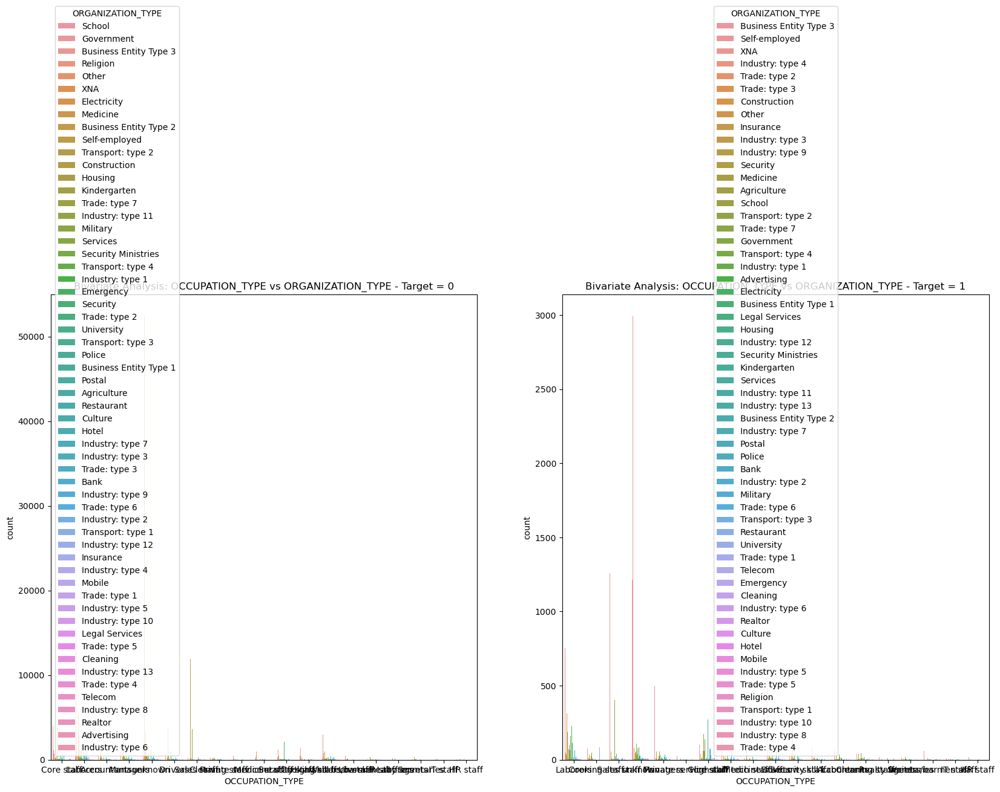

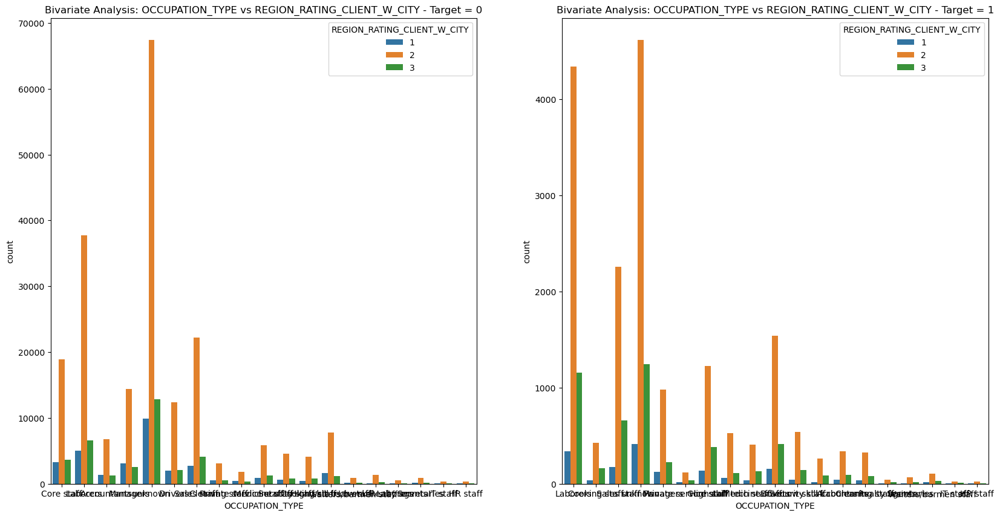

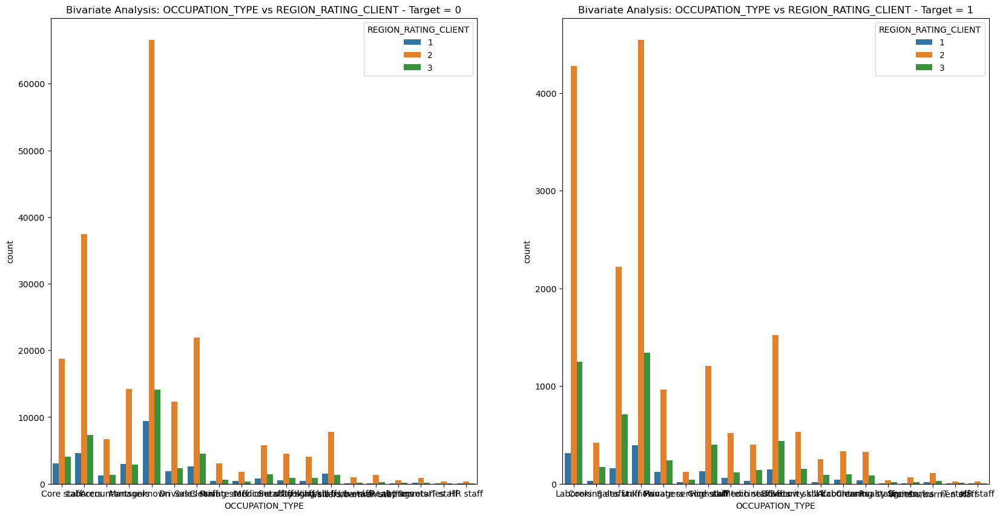

Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


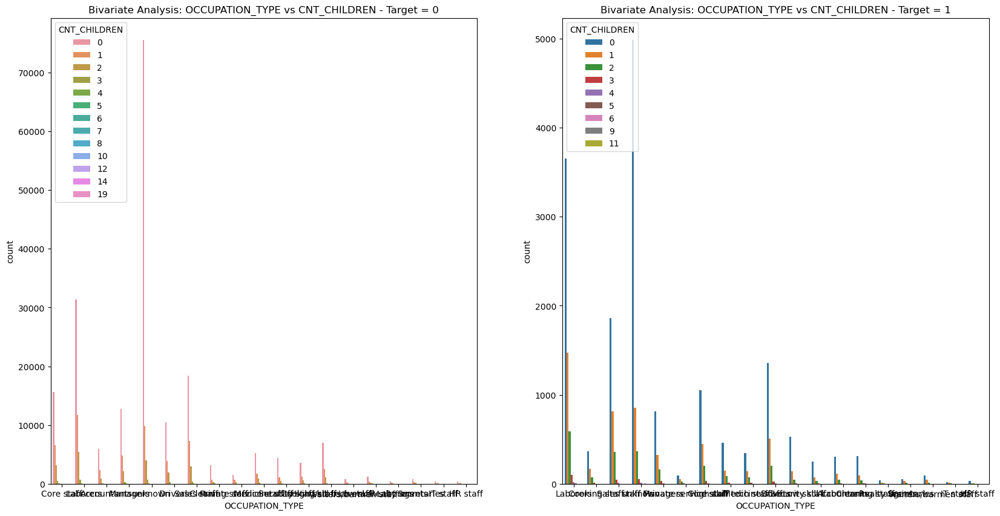

Skipping plot for OCCUPATION_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for OCCUPATION_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


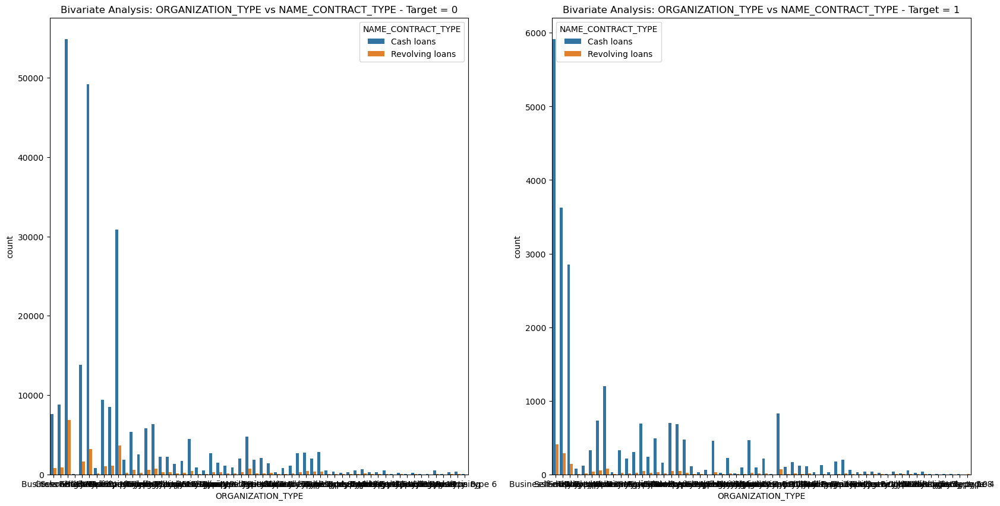

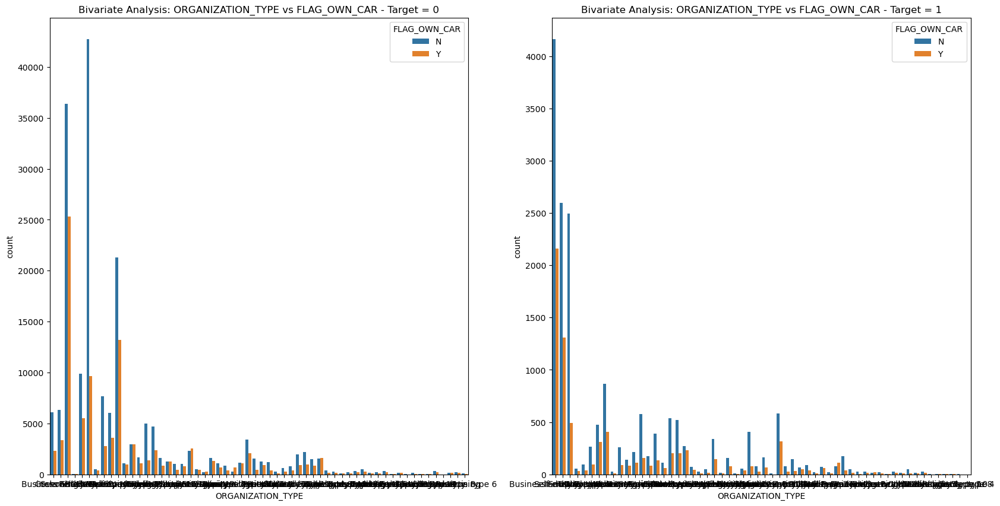

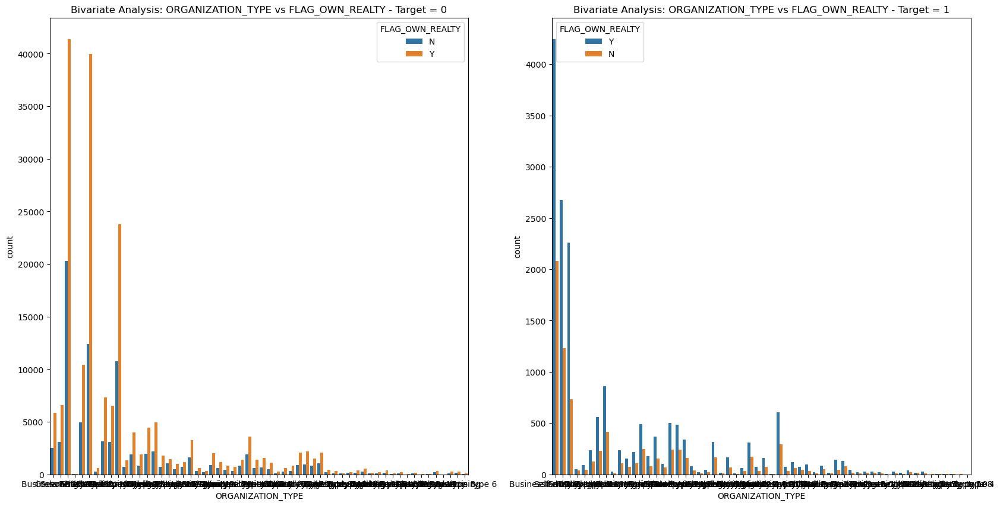

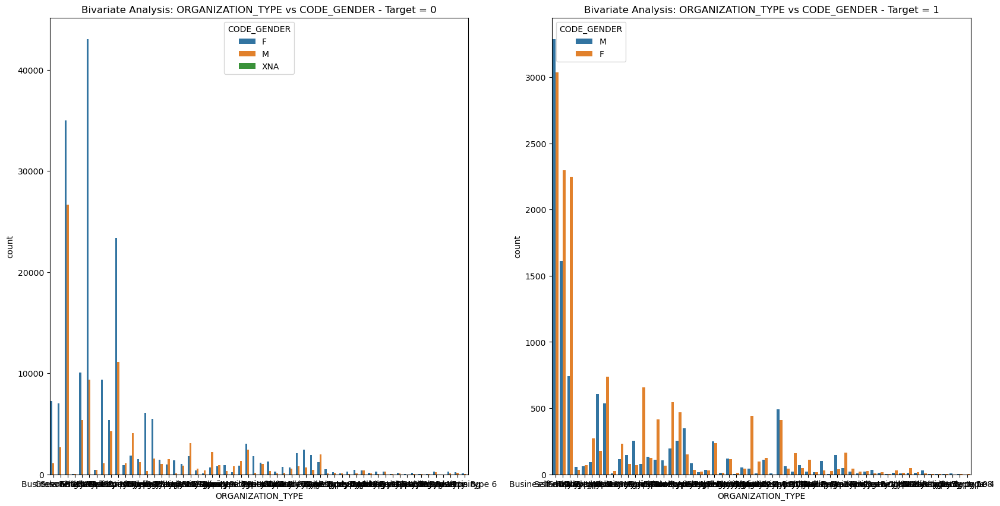

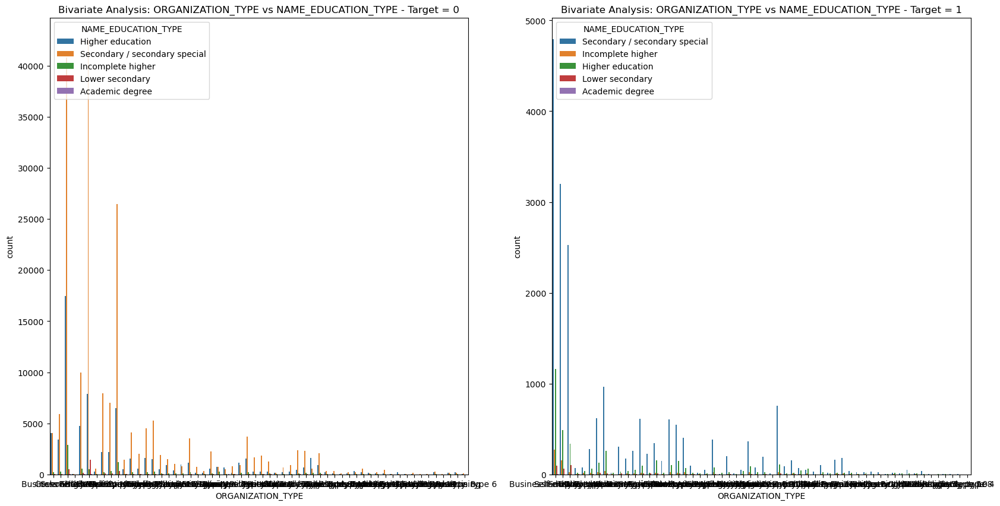

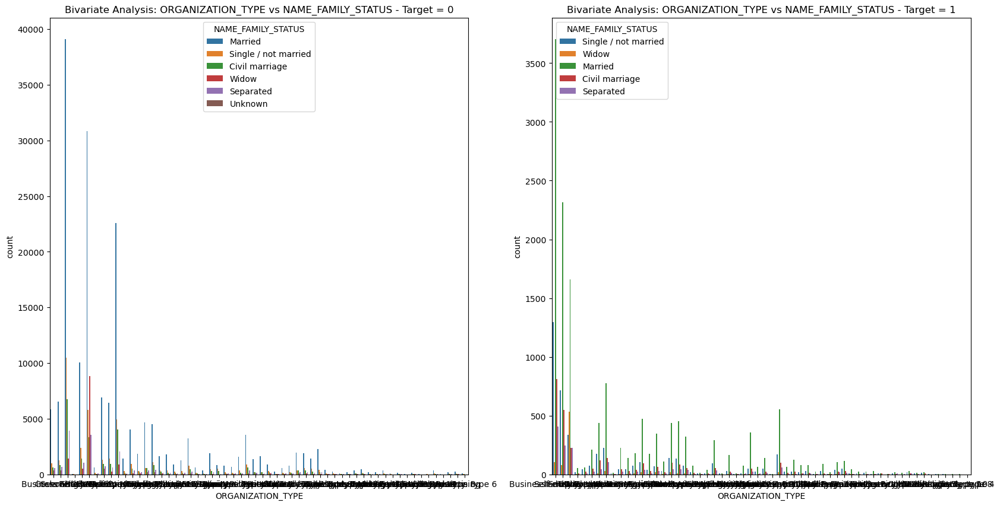

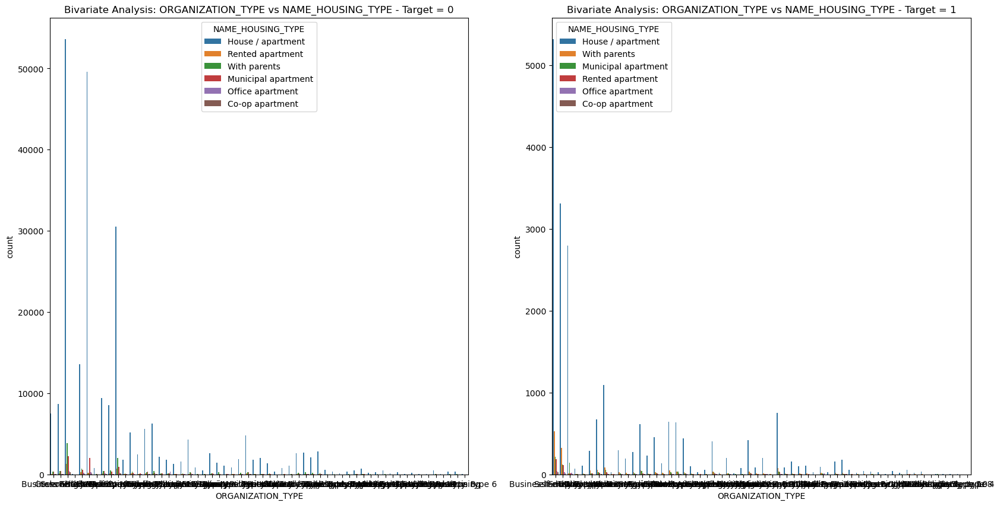

Skipping plot for ORGANIZATION_TYPE vs NAME_TYPE_SUITE due to presence of methods in data.


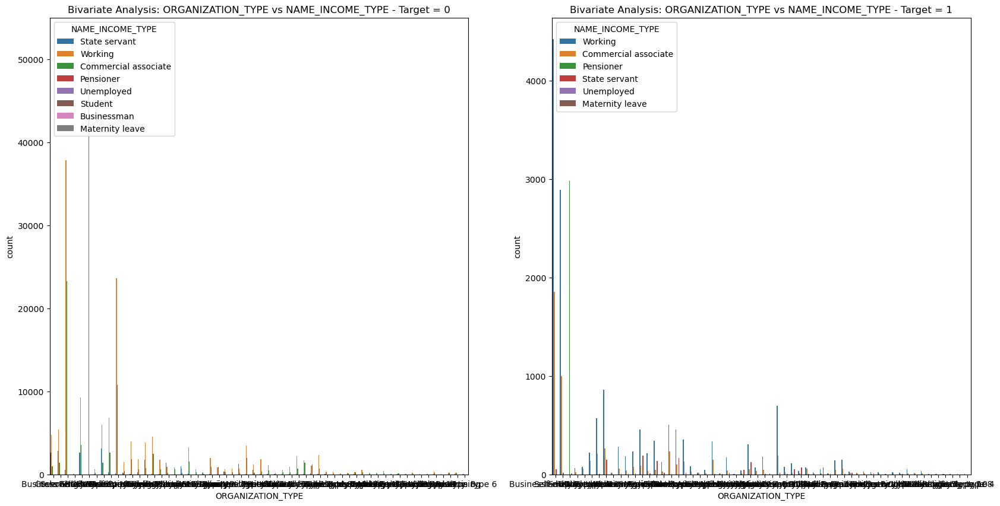

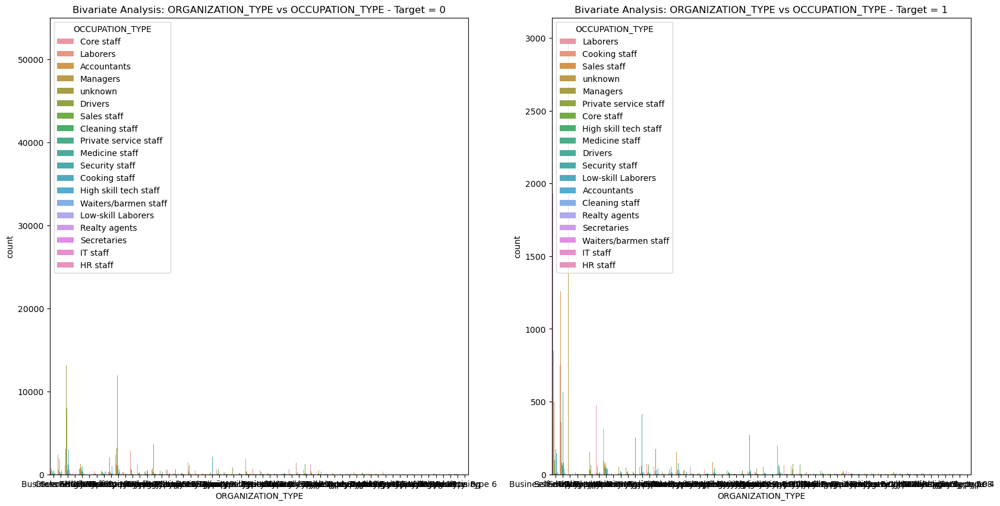

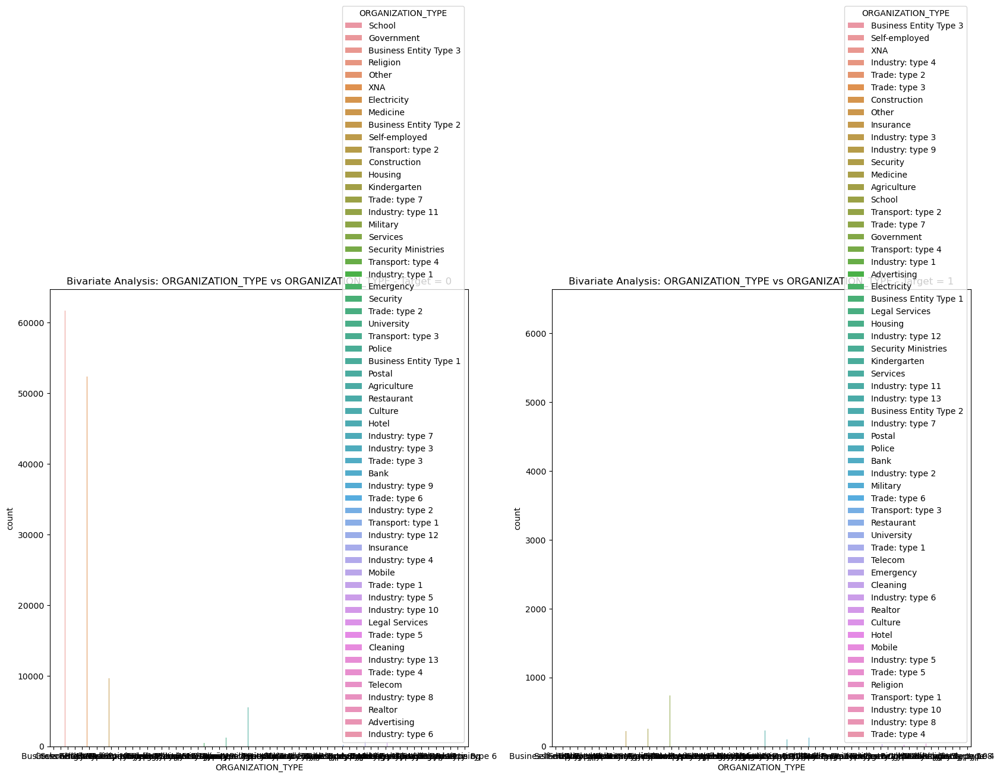

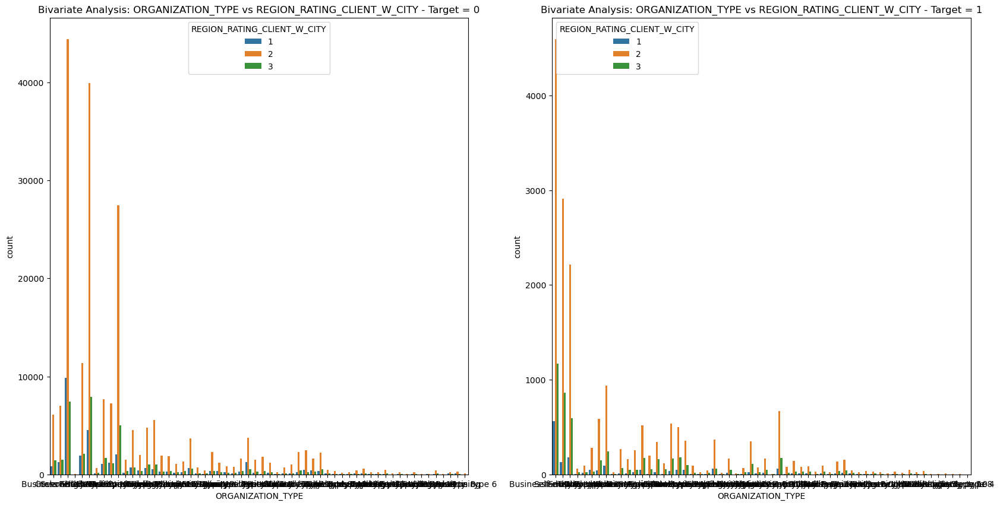

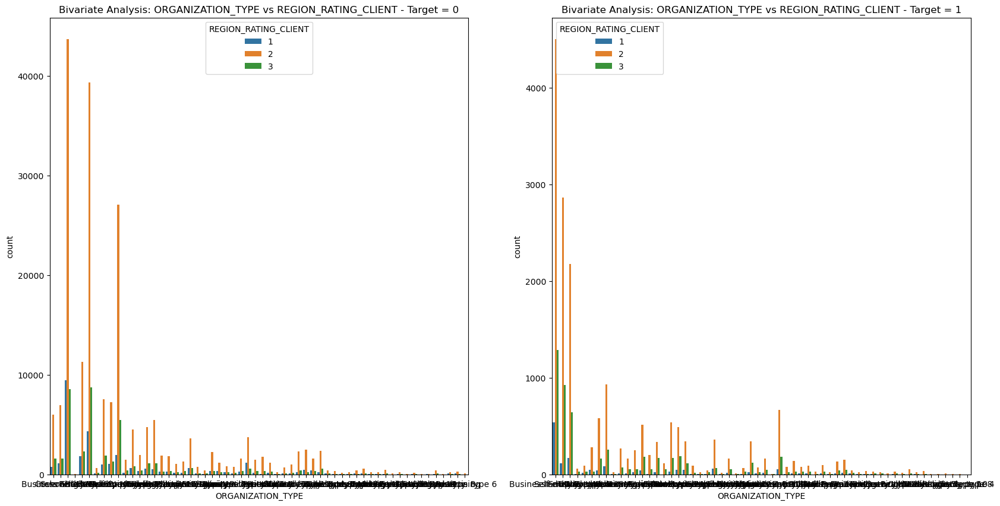

Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


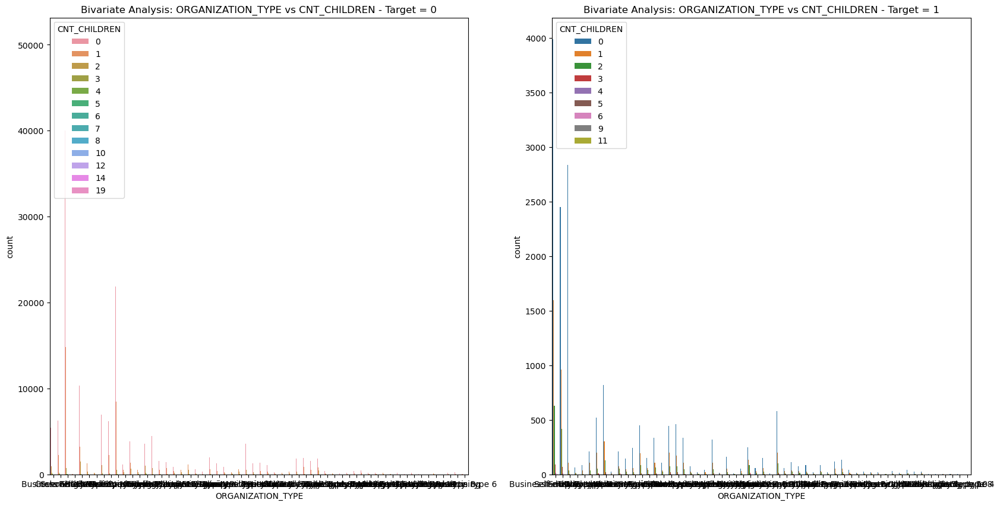

Skipping plot for ORGANIZATION_TYPE vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for ORGANIZATION_TYPE vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


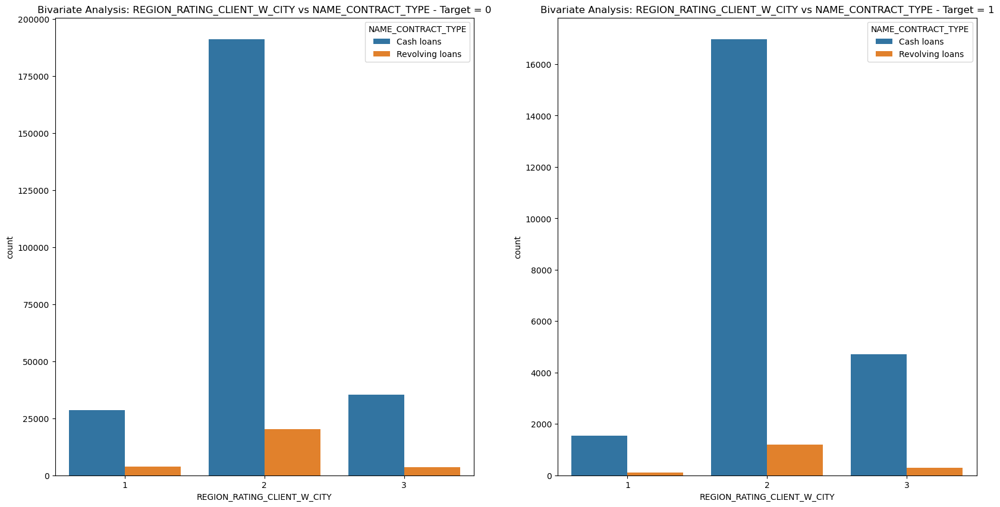

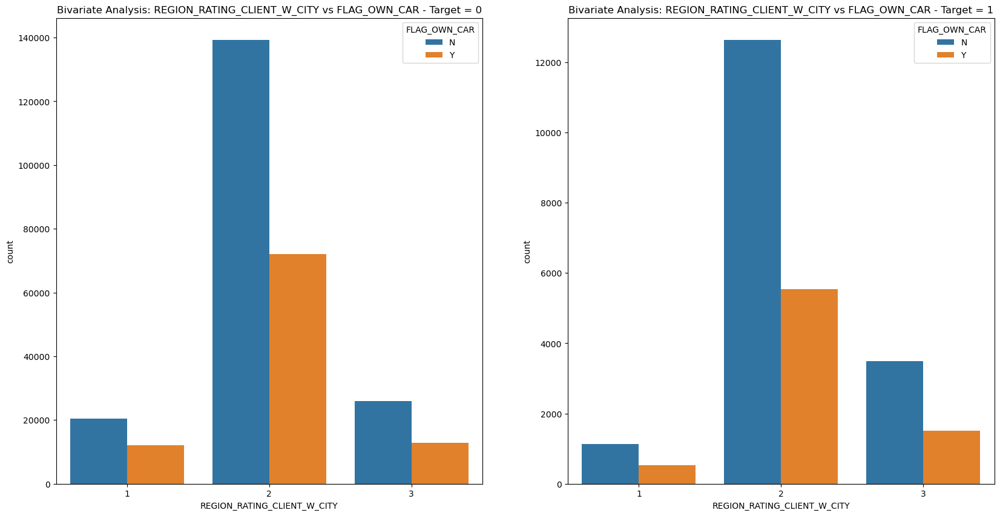

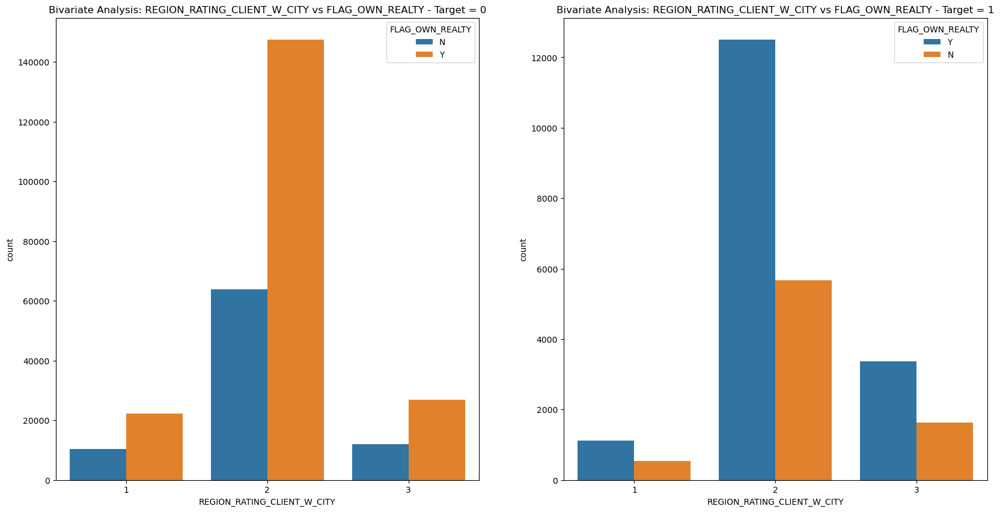

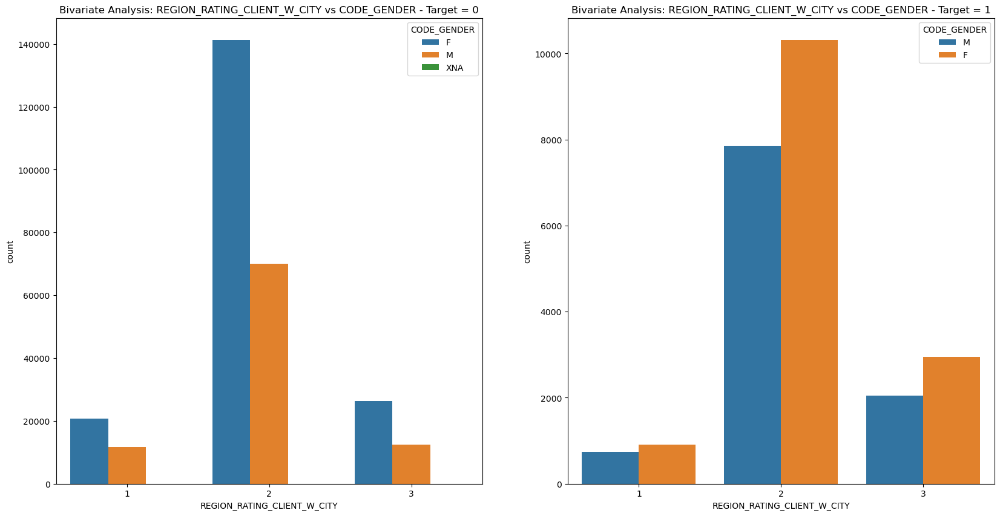

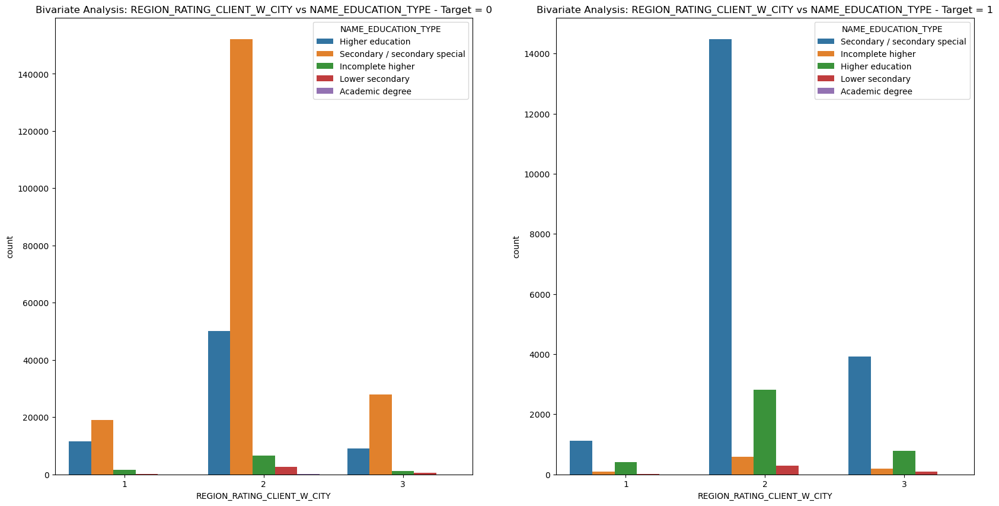

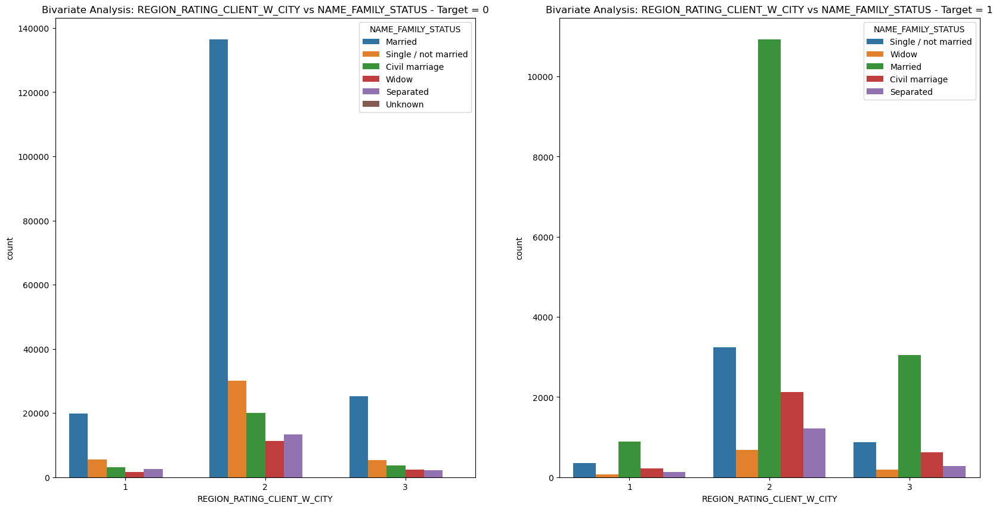

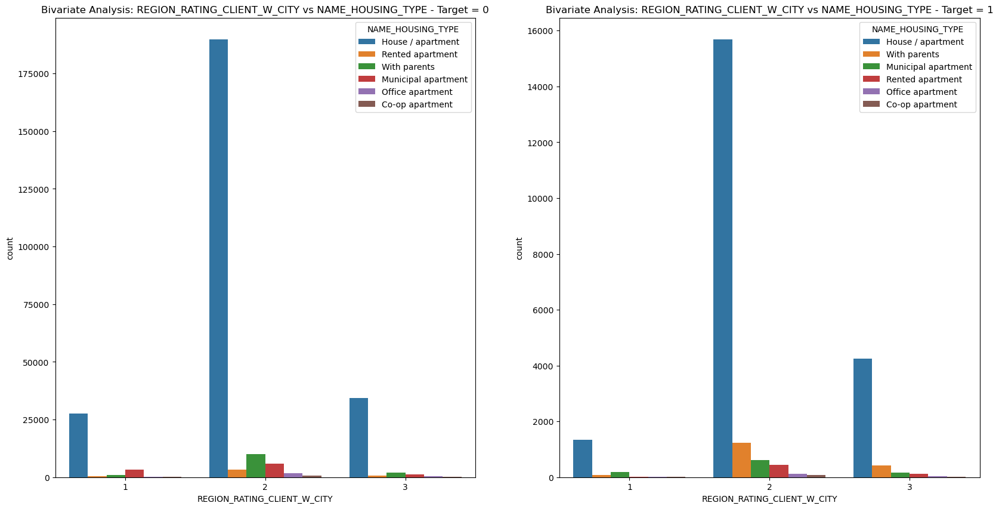

Skipping plot for REGION_RATING_CLIENT_W_CITY vs NAME_TYPE_SUITE due to presence of methods in data.


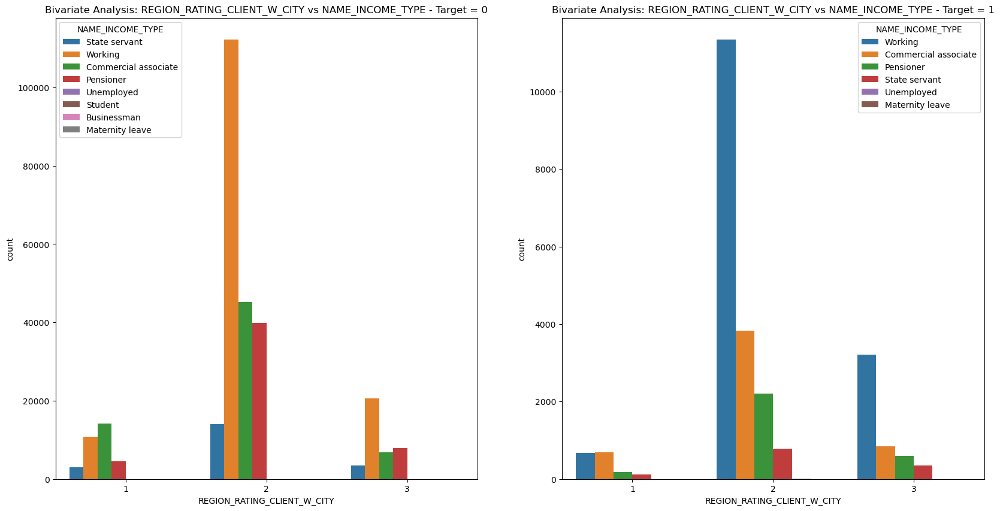

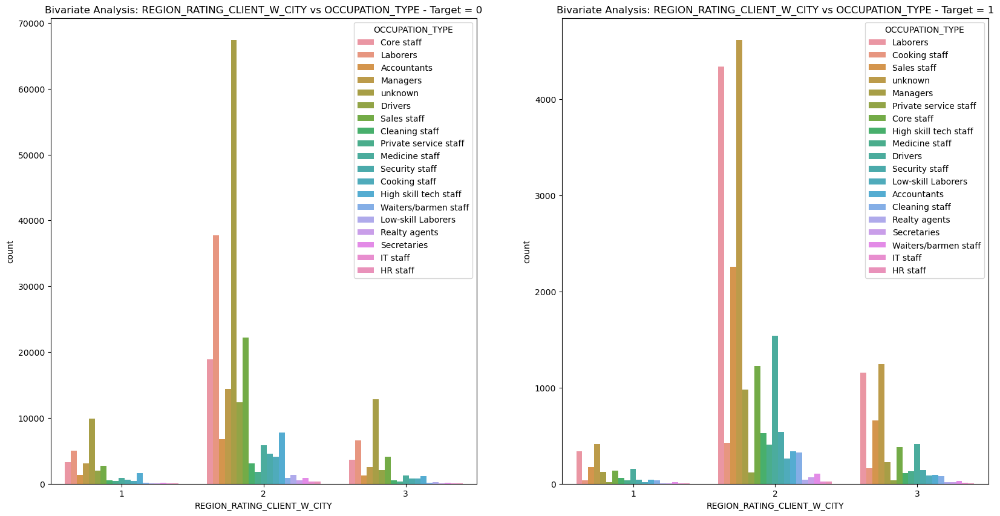

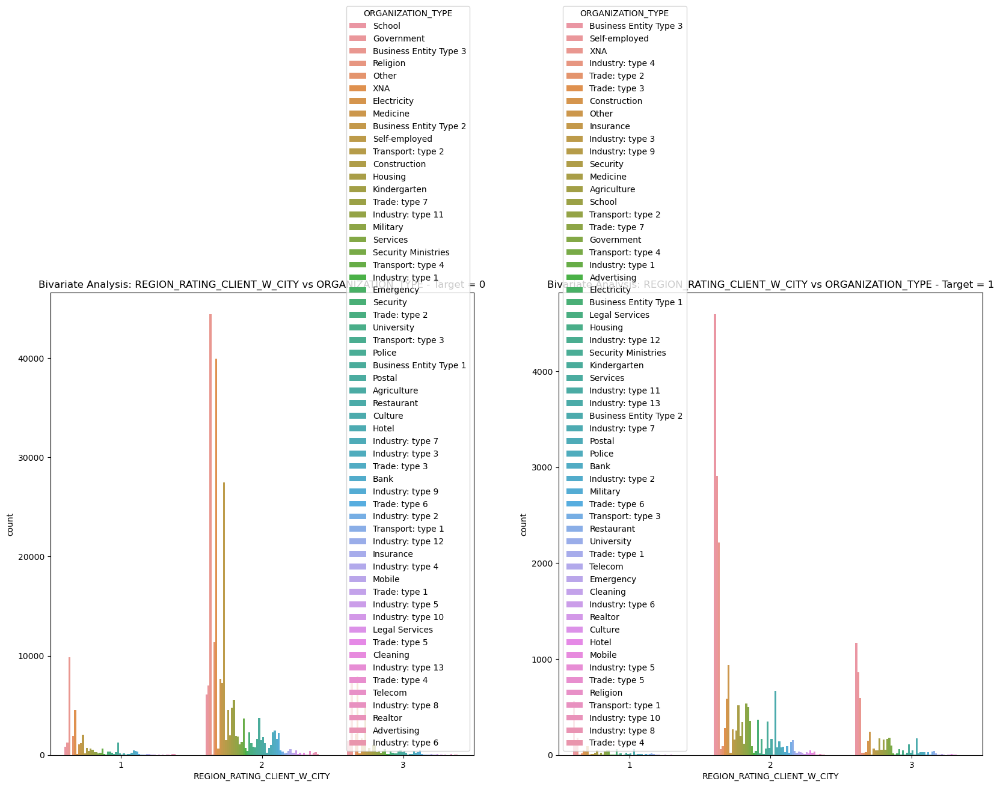

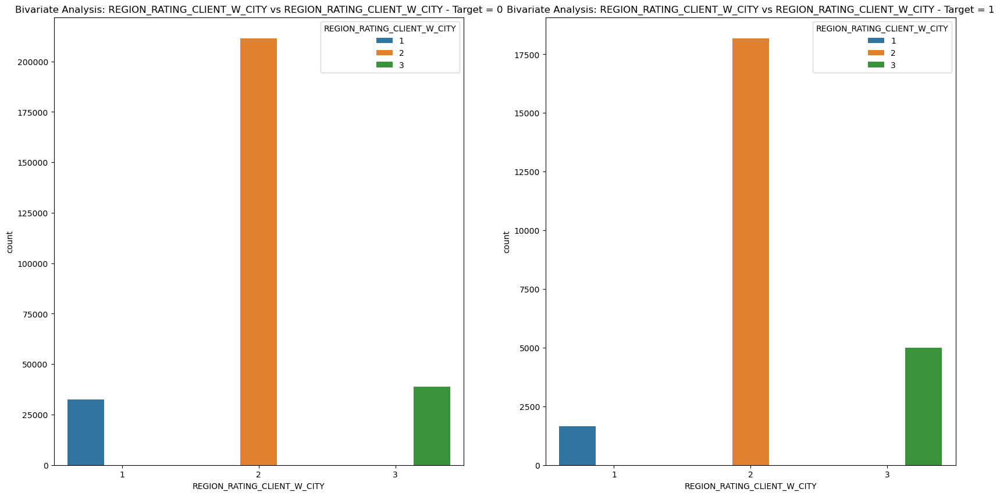

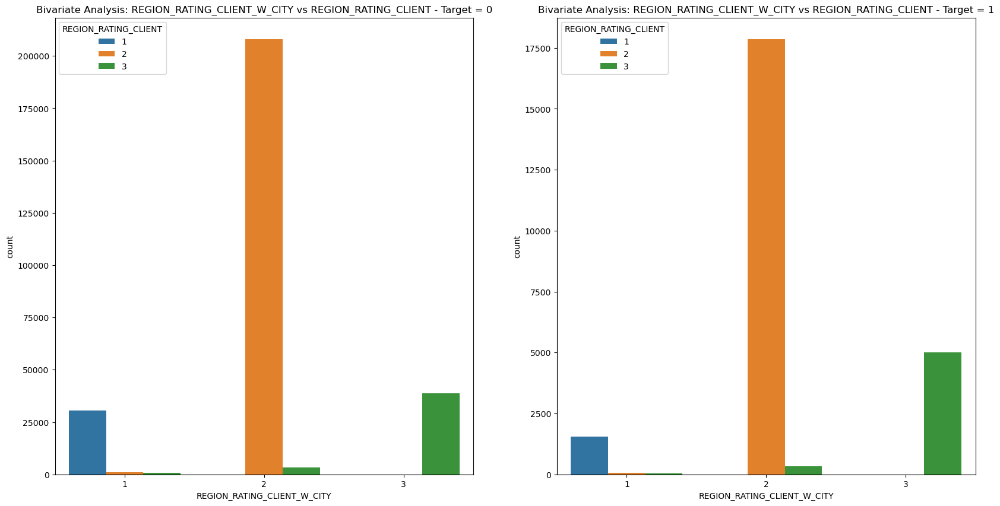

Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


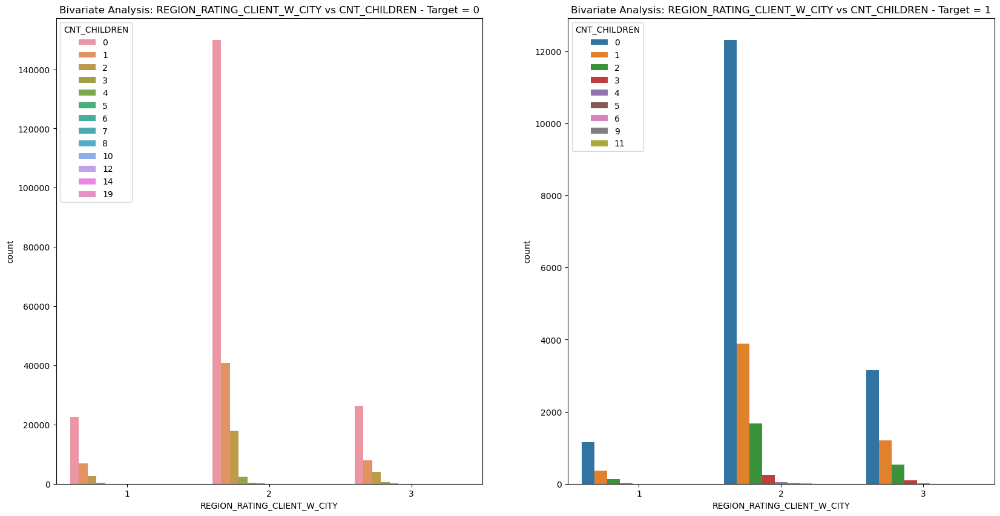

Skipping plot for REGION_RATING_CLIENT_W_CITY vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT_W_CITY vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.


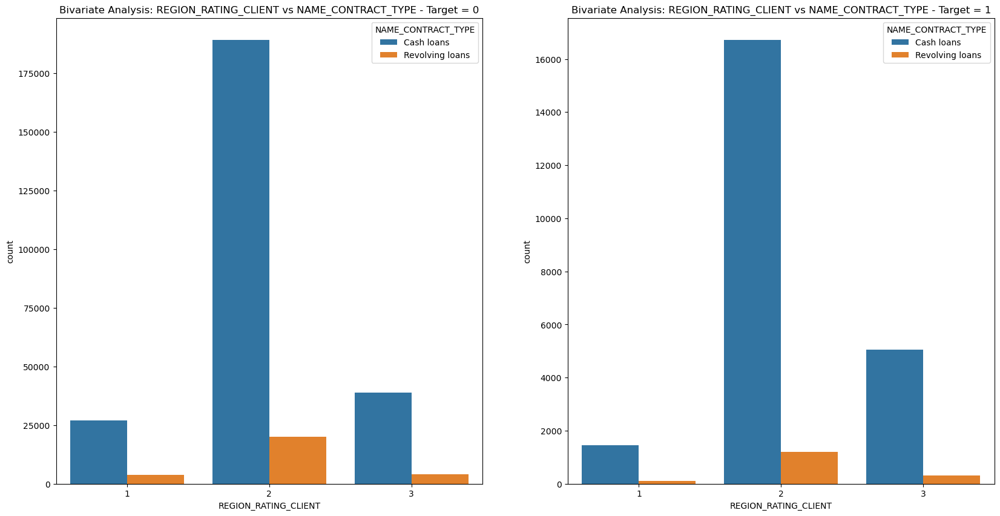

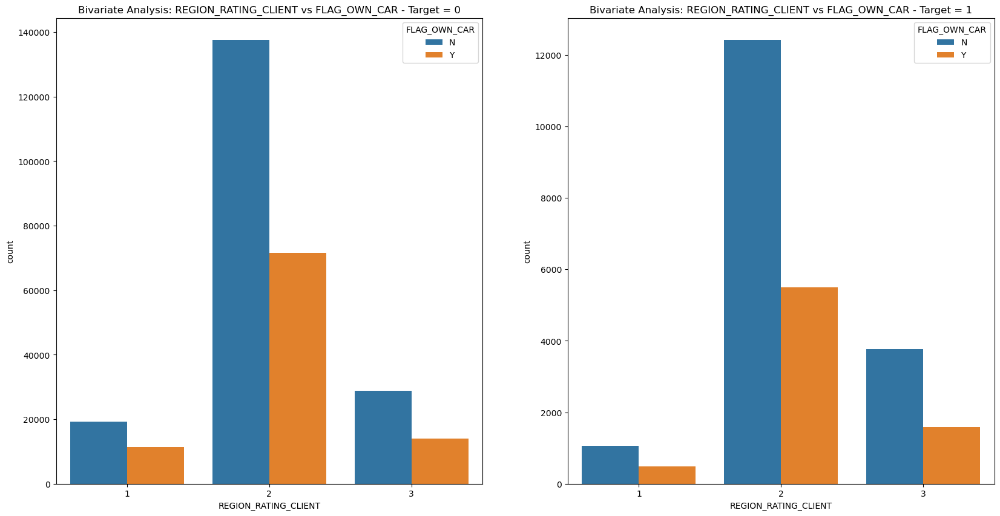

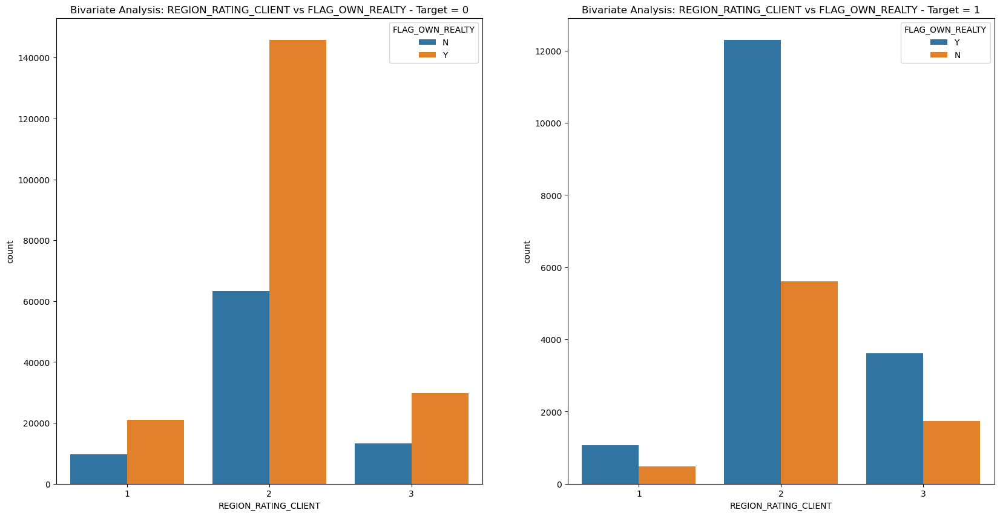

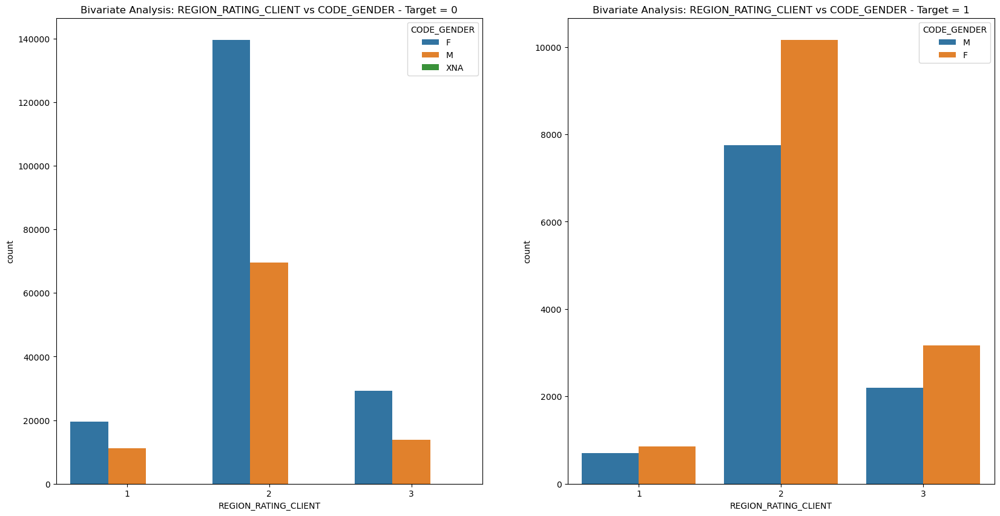

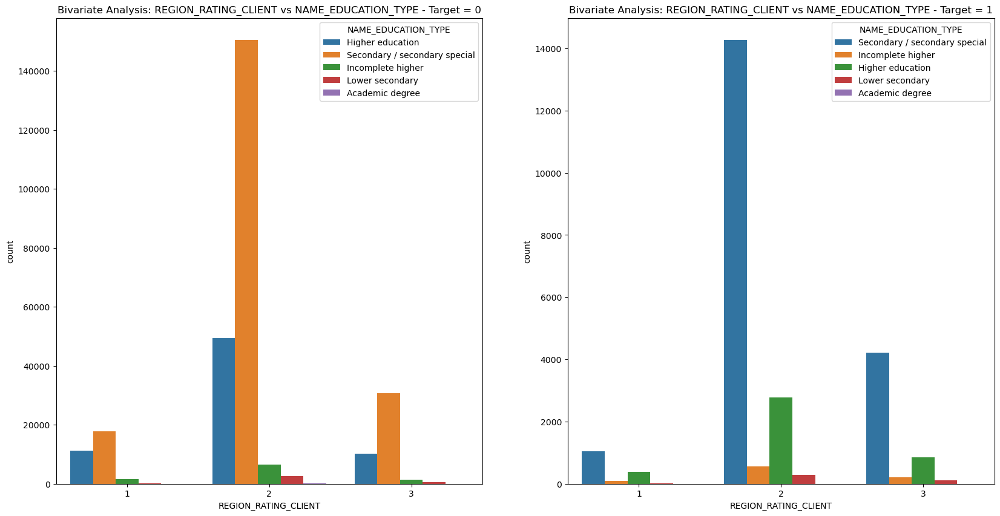

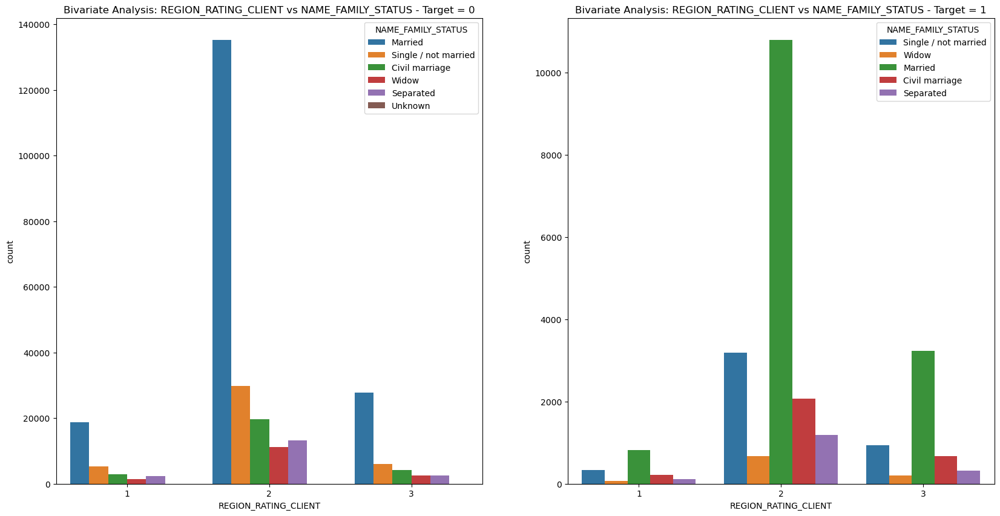

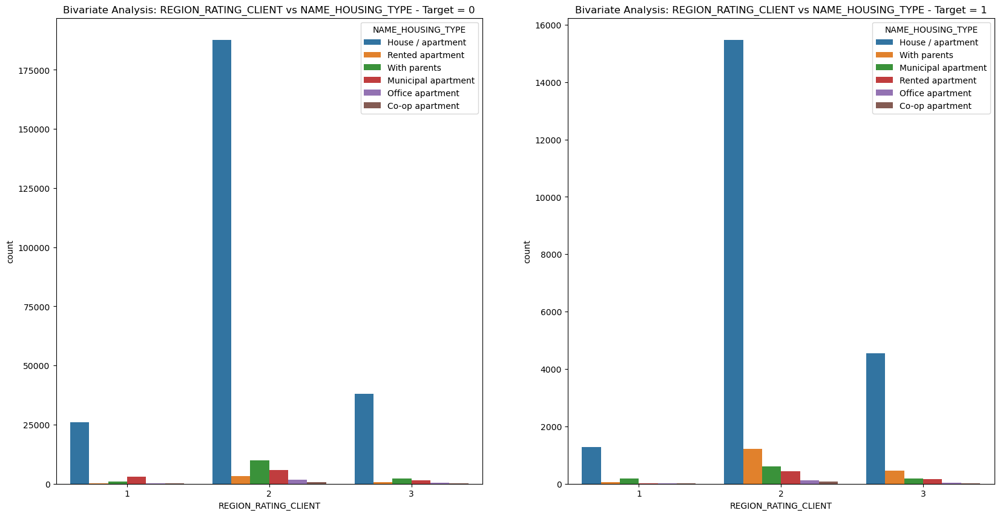

Skipping plot for REGION_RATING_CLIENT vs NAME_TYPE_SUITE due to presence of methods in data.


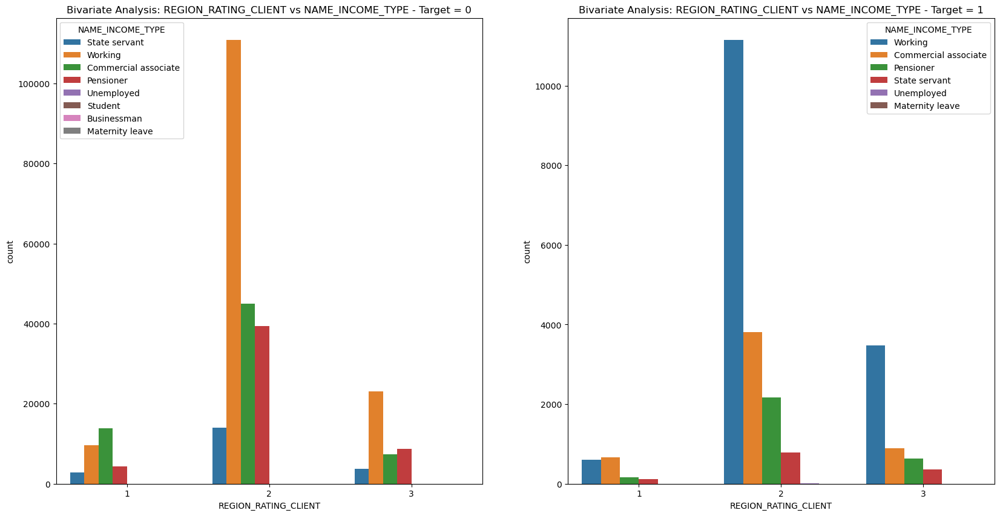

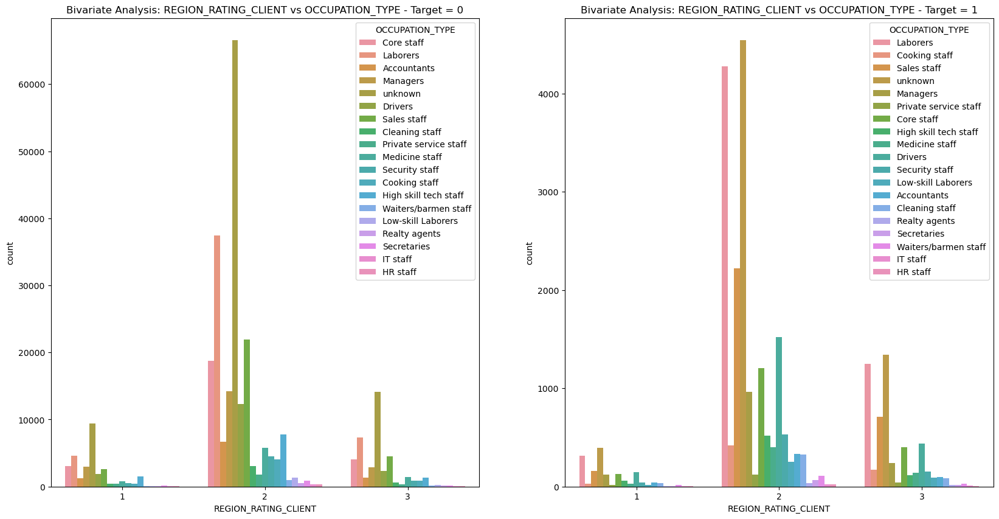

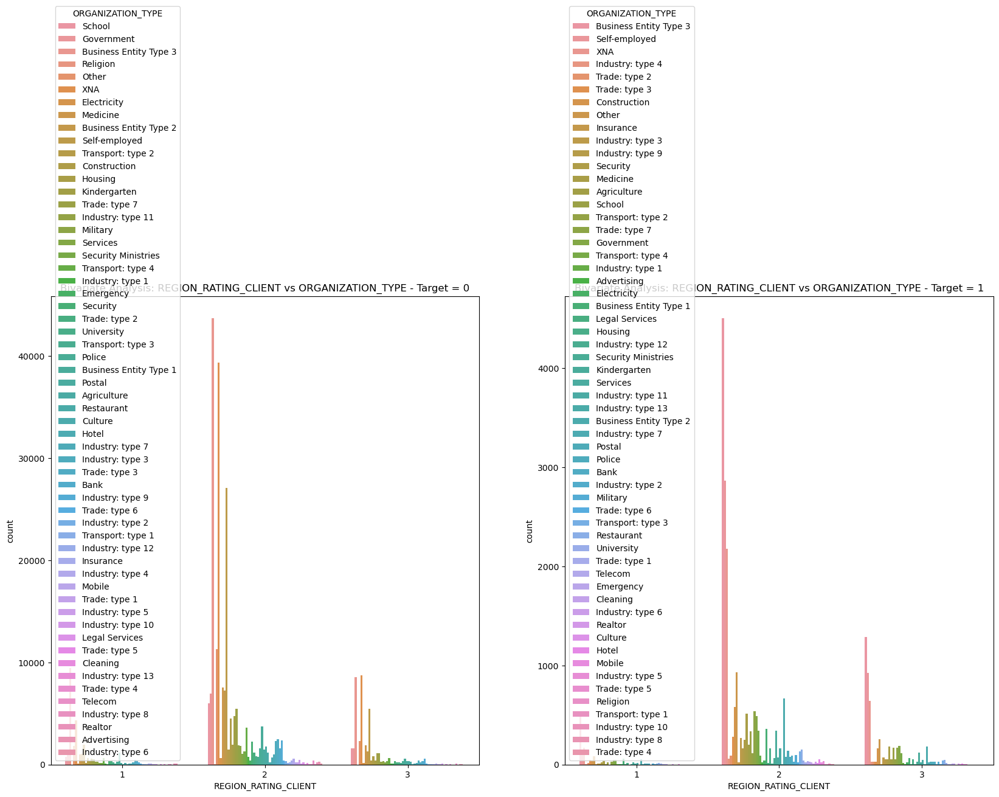

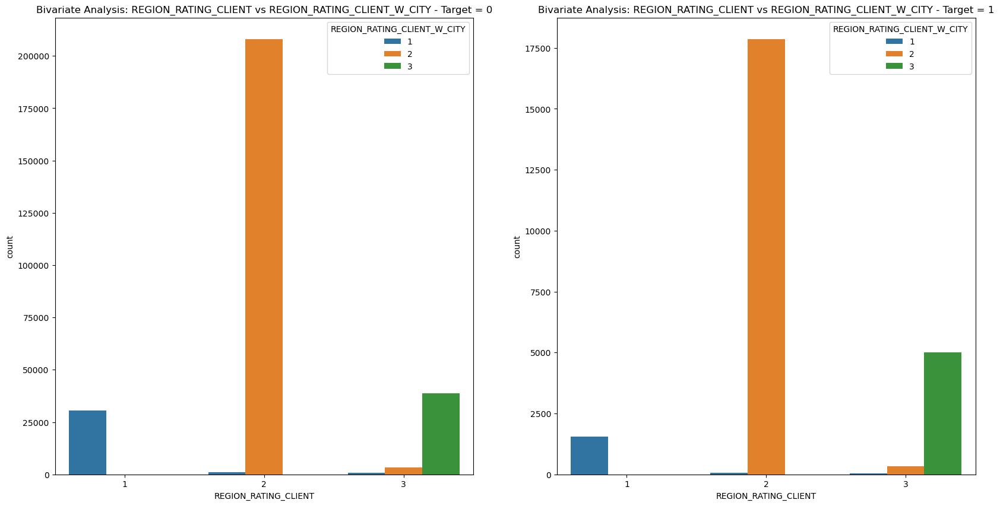

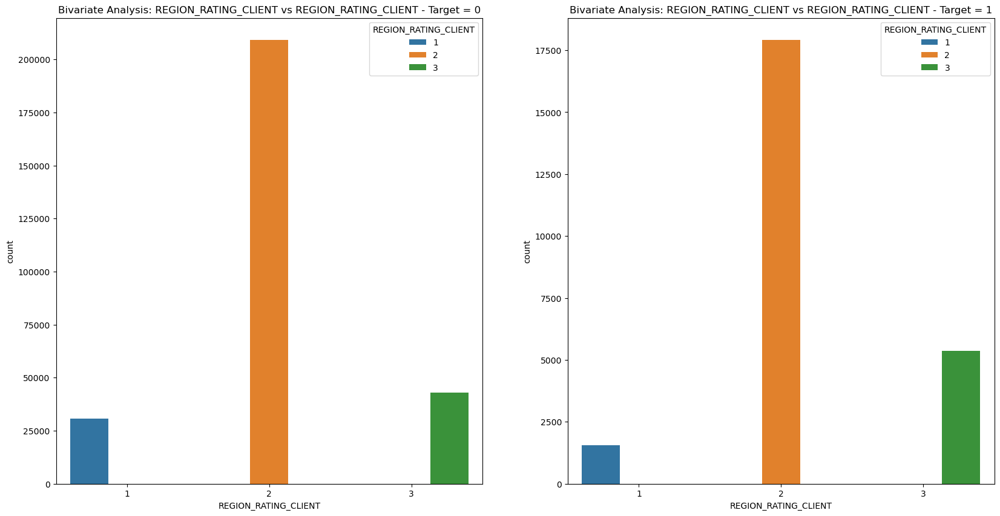

Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


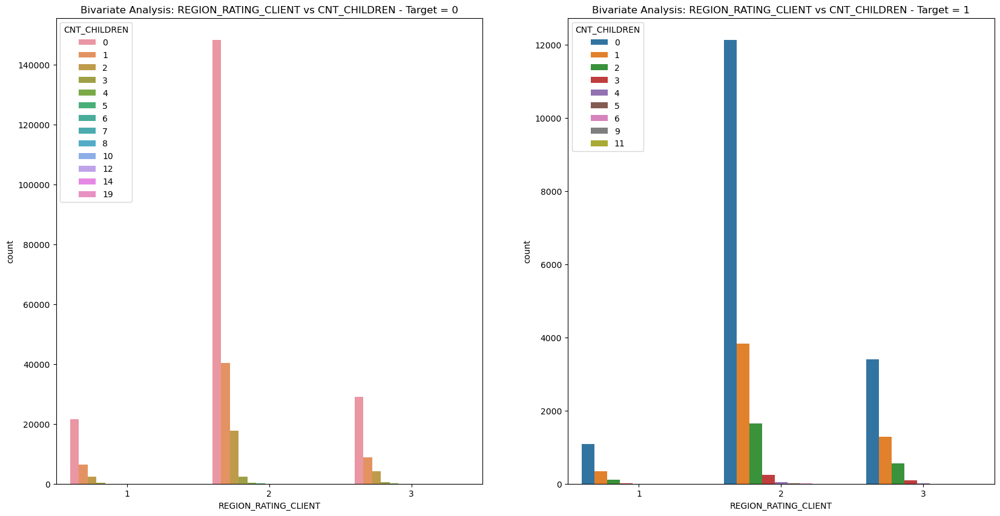

Skipping plot for REGION_RATING_CLIENT vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for REGION_RATING_CLIENT vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for AMT_REQ_CREDIT_BUREAU_HOUR vs NAME_CONTRACT_TYPE due to presence of methods in data.
Skipping plot for AMT_REQ_CREDIT_BUREAU_HOUR vs FLAG_OWN_CAR due to presence of methods in data.
Skipping plot for AMT_REQ_CREDIT_BUREAU_HOUR vs FLAG_OWN_REALTY due to presence of methods in data.
Skipping plot for AMT_REQ_CREDIT_BUREAU_HOUR vs CODE_GENDER due to presence of methods in data.
Skipping plot for AMT_REQ_CREDIT_BUREAU_HOUR vs NAME_EDUCATION_TYPE due to presence of methods 

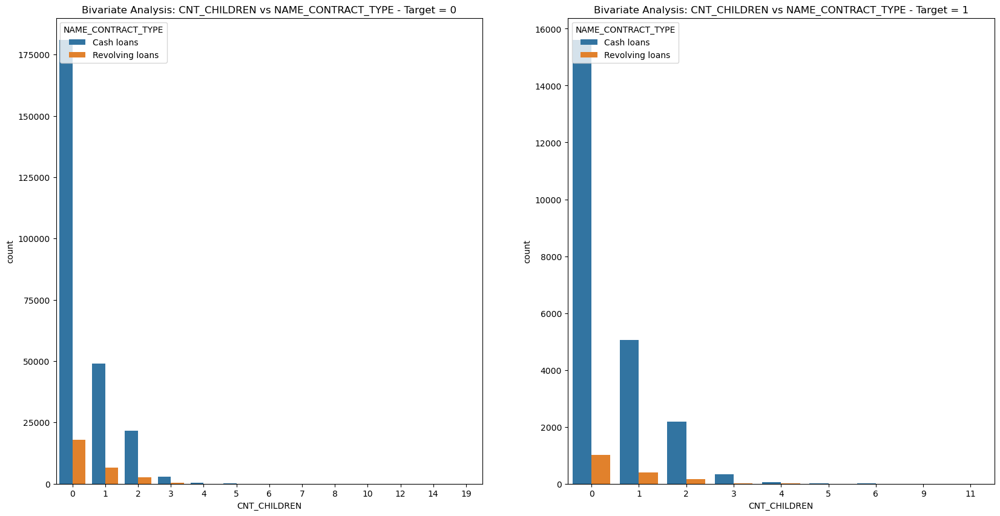

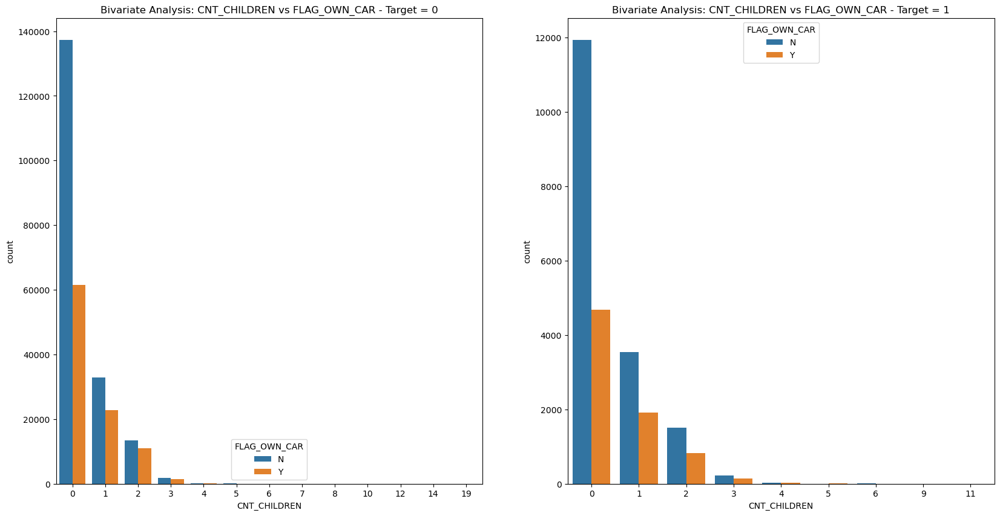

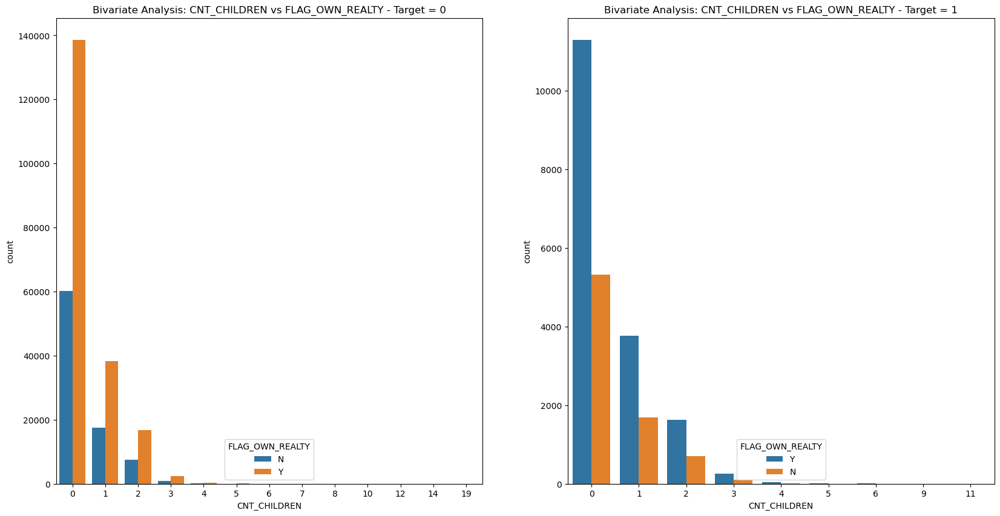

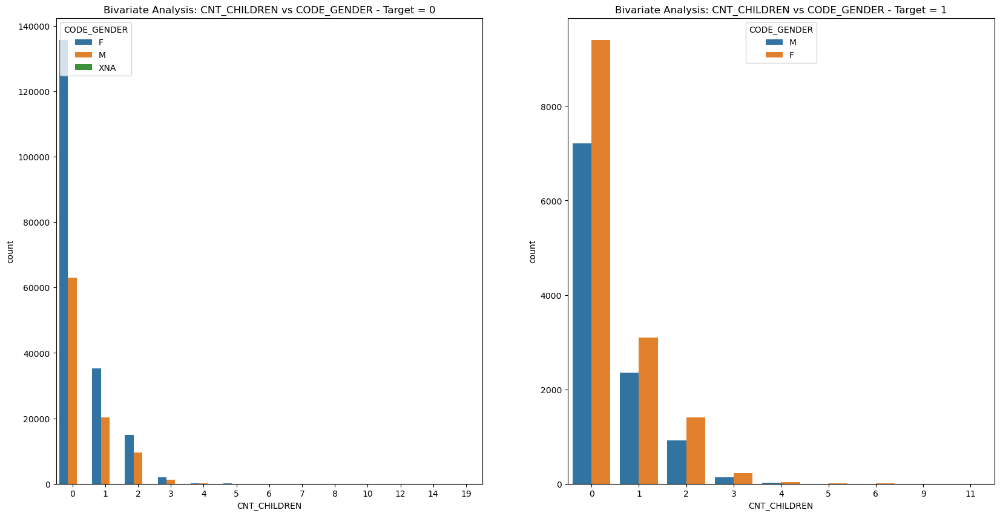

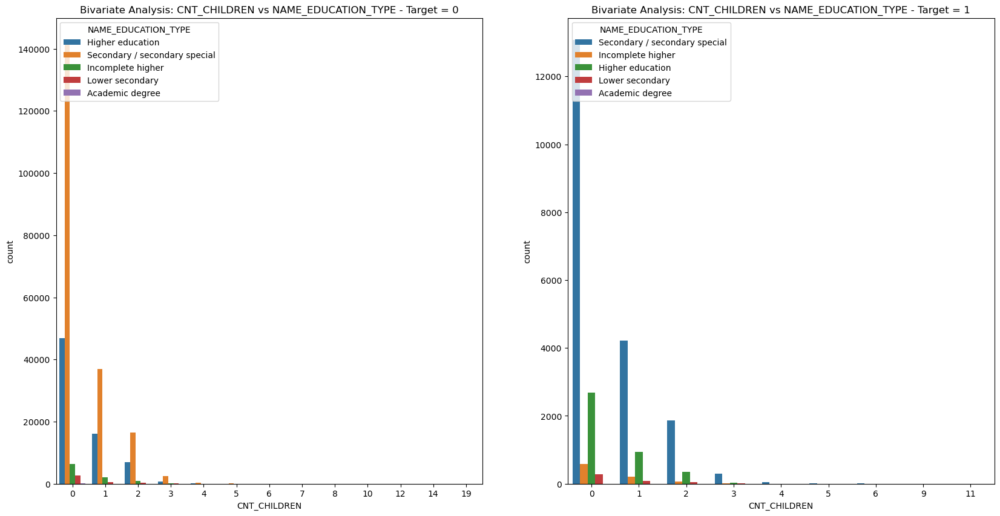

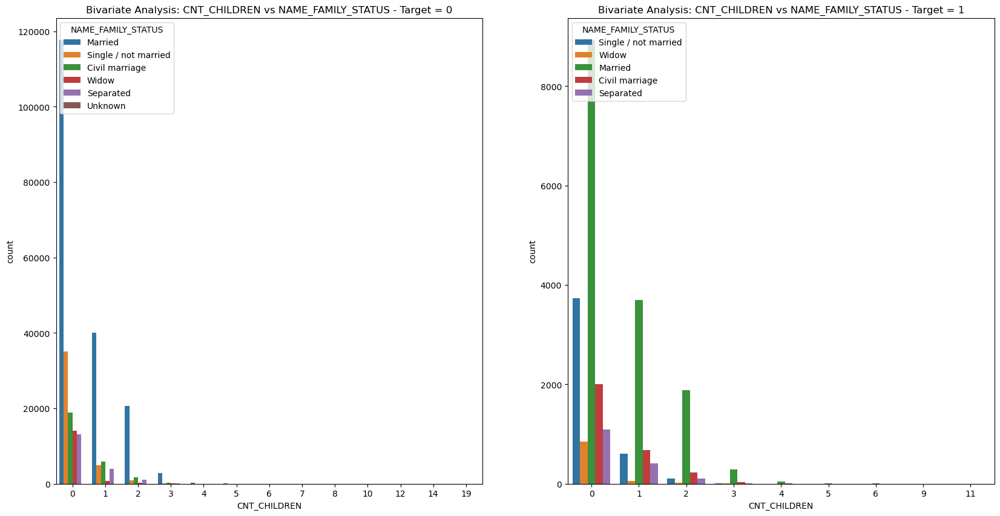

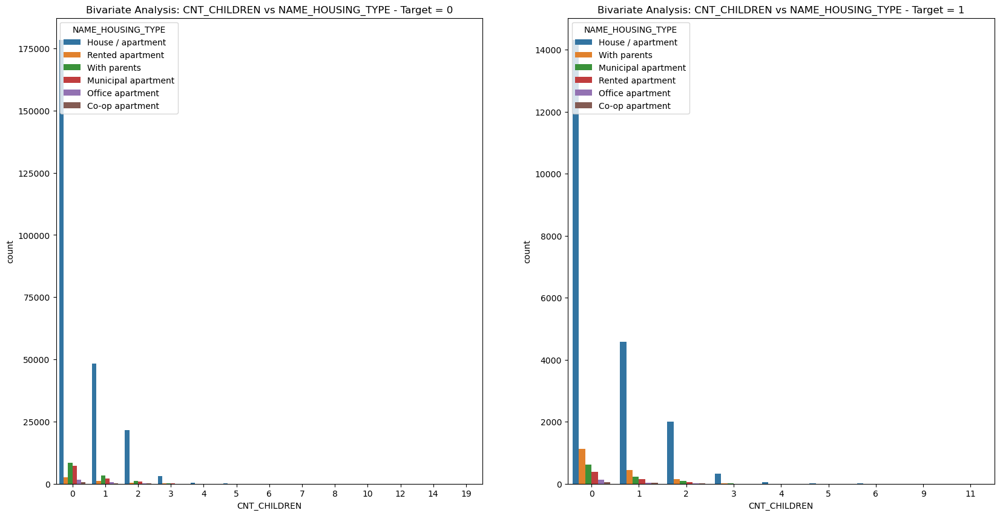

Skipping plot for CNT_CHILDREN vs NAME_TYPE_SUITE due to presence of methods in data.


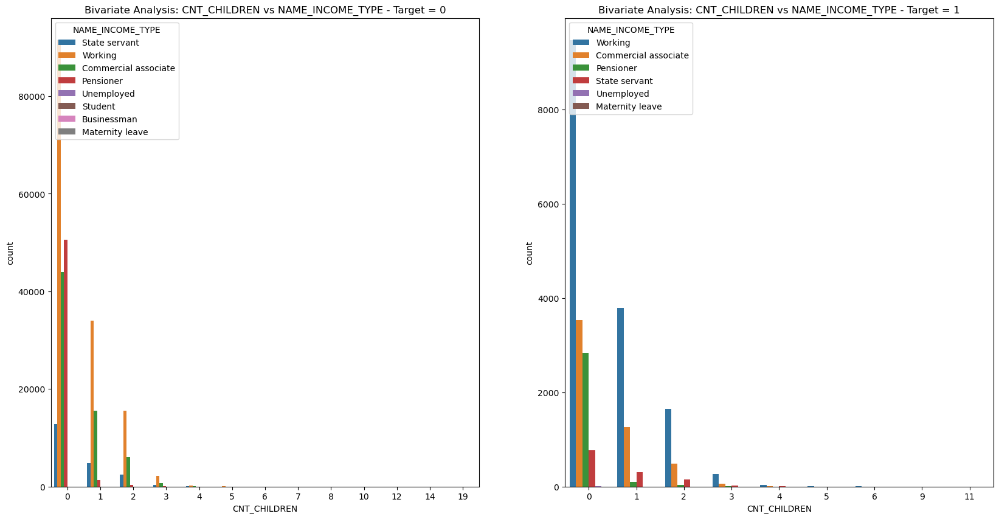

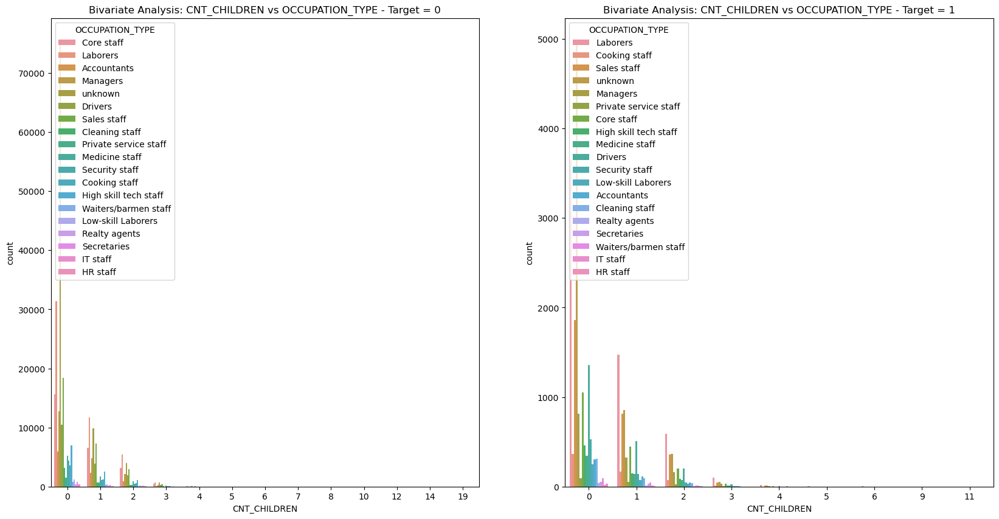

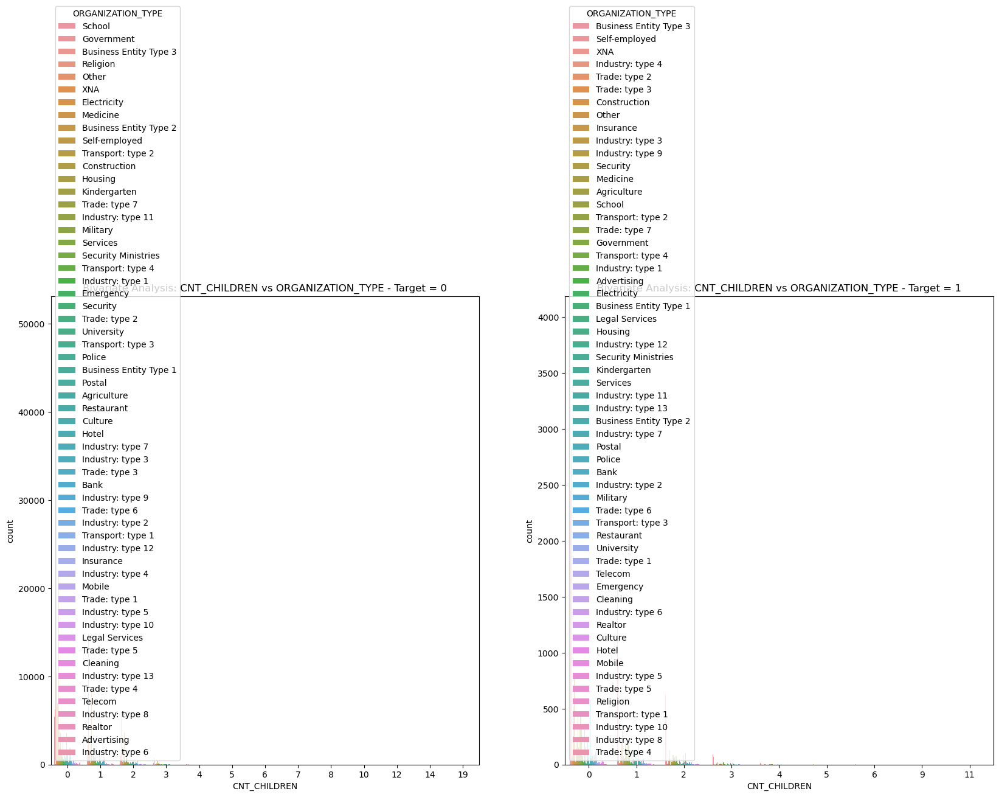

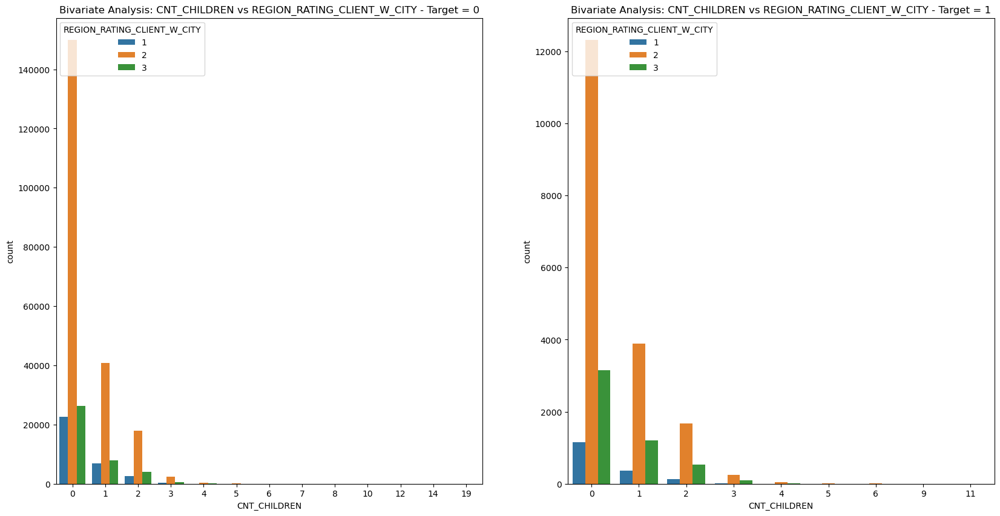

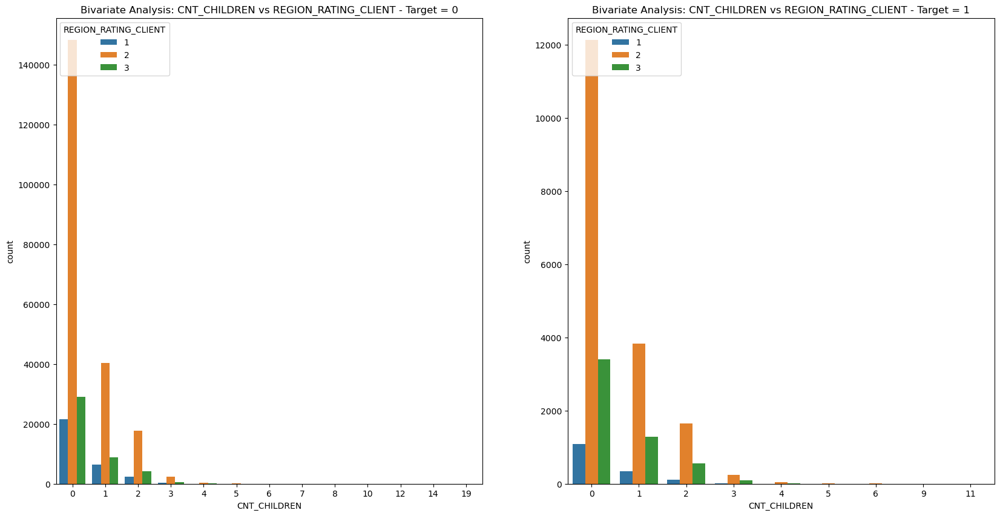

Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_HOUR due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs DEF_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_WEEK due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_DAY due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs DEF_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_QRT due to presence of methods in data.


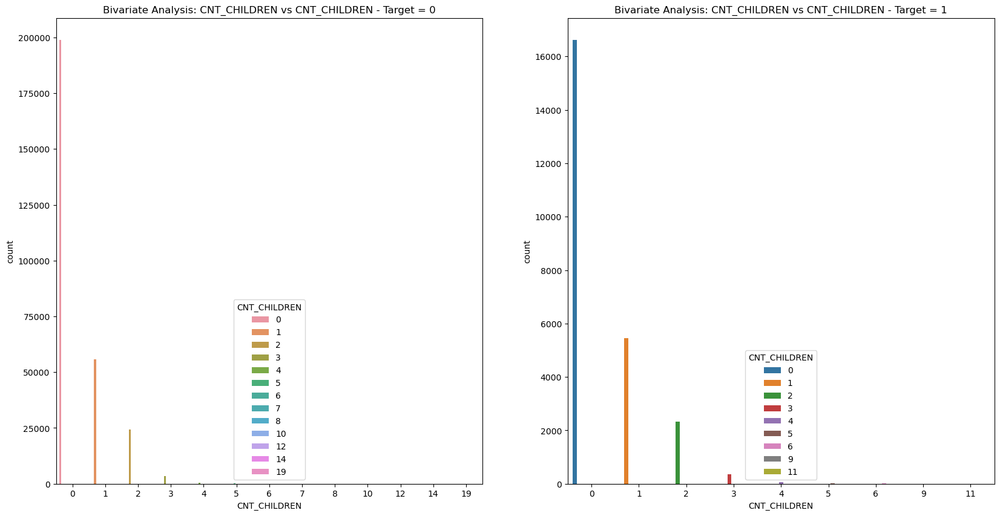

Skipping plot for CNT_CHILDREN vs CNT_FAM_MEMBERS due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_MON due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs AMT_REQ_CREDIT_BUREAU_YEAR due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs OBS_30_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CNT_CHILDREN vs OBS_60_CNT_SOCIAL_CIRCLE due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs NAME_CONTRACT_TYPE due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs FLAG_OWN_CAR due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs FLAG_OWN_REALTY due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs CODE_GENDER due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs NAME_EDUCATION_TYPE due to presence of methods in data.
Skipping plot for CNT_FAM_MEMBERS vs NAME_FAMILY_STATUS due to presence of methods in 

In [425]:
for i in categorical_columns:
    for j in categorical_columns:
        # Check data types of columns before plotting
        if not (isinstance(target_0[i].dtype, object) and isinstance(target_0[j].dtype, object)):
            print(f"Skipping plot for {i} vs {j} due to incompatible data types.")
            continue

        # Check for and handle methods in columns
        if any(callable(x) for x in target_0[i]) or any(callable(x) for x in target_0[j]):
            print(f"Skipping plot for {i} vs {j} due to presence of methods in data.")
            continue

        plt.figure(figsize=(20,10))
        plt.subplot(1,2,1)
        sns.countplot(x=i, hue=j, data=target_0)
        plt.title(f'Bivariate Analysis: {i} vs {j} - Target = 0')
        plt.subplot(1,2,2)
        sns.countplot(x=i, hue=j, data=target_1)
        plt.title(f'Bivariate Analysis: {i} vs {j} - Target = 1')
        plt.show()

## *5.2 Bivariate on numerical vs numerical columns*

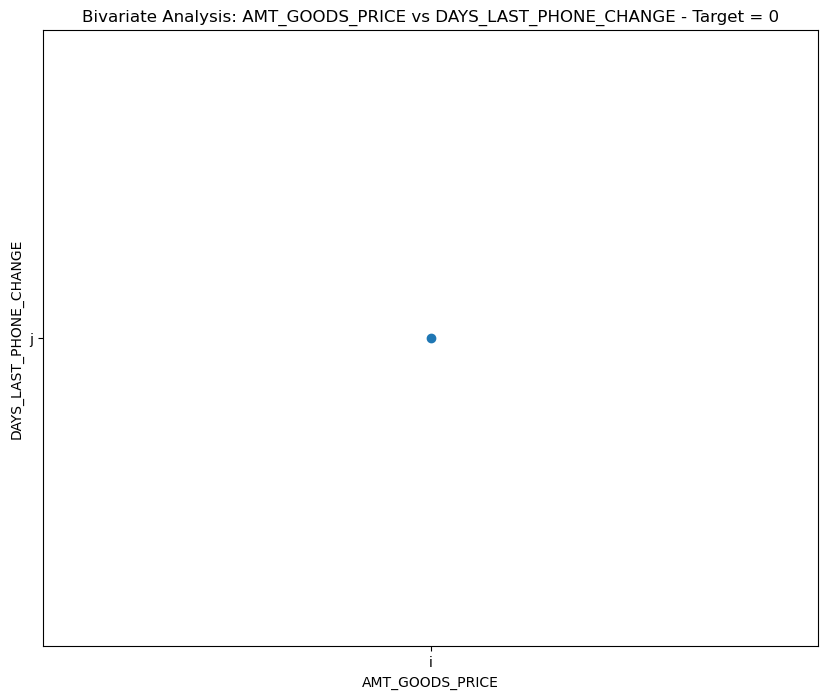

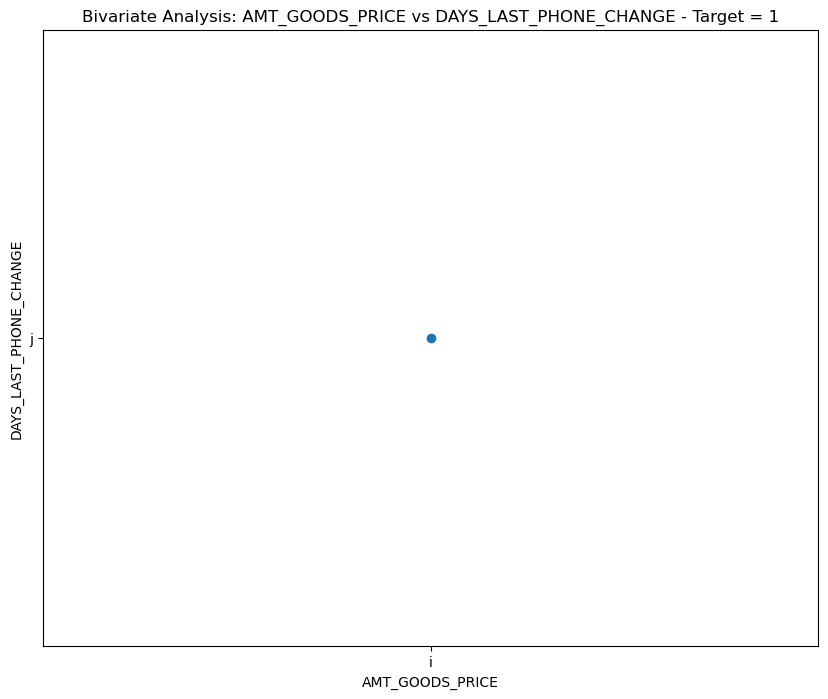

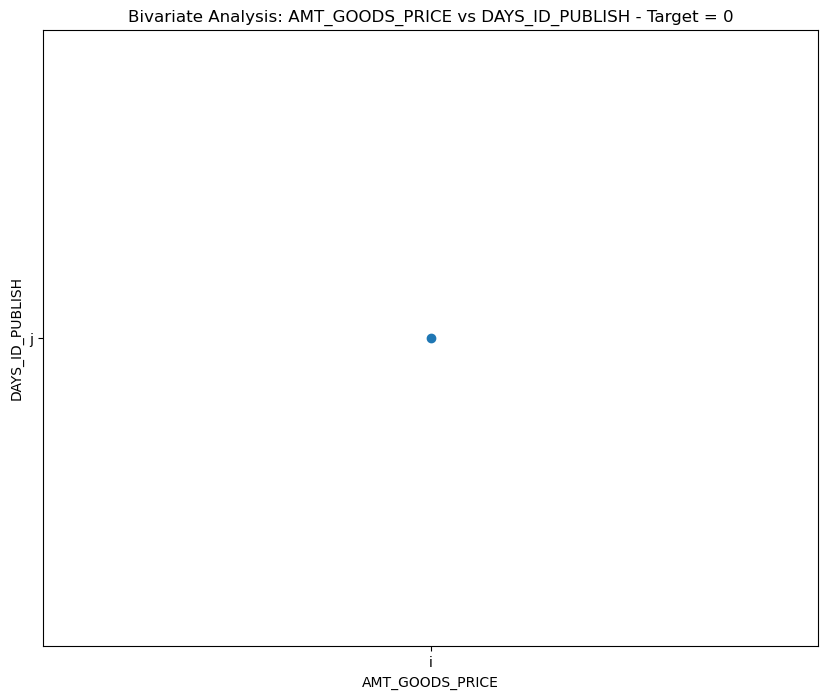

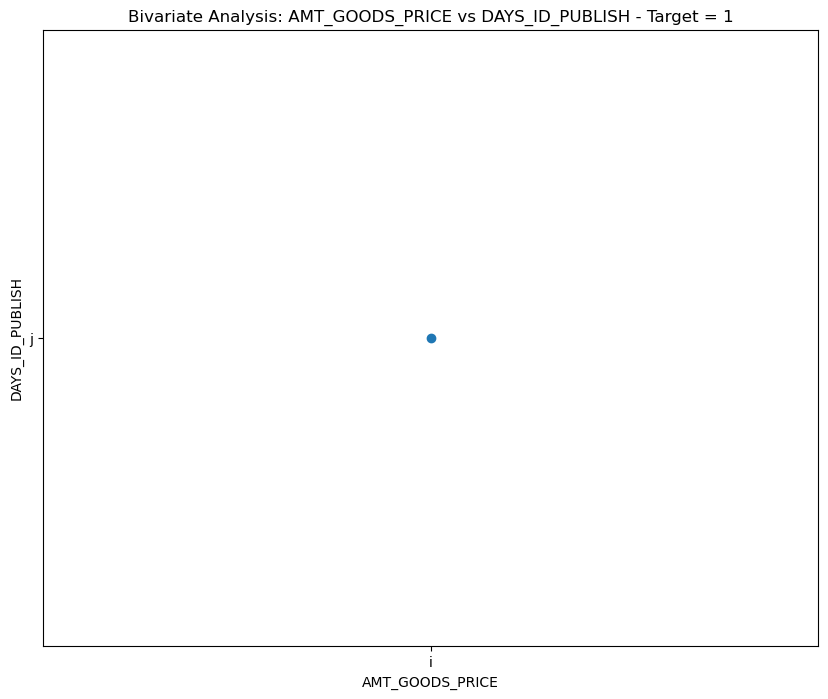

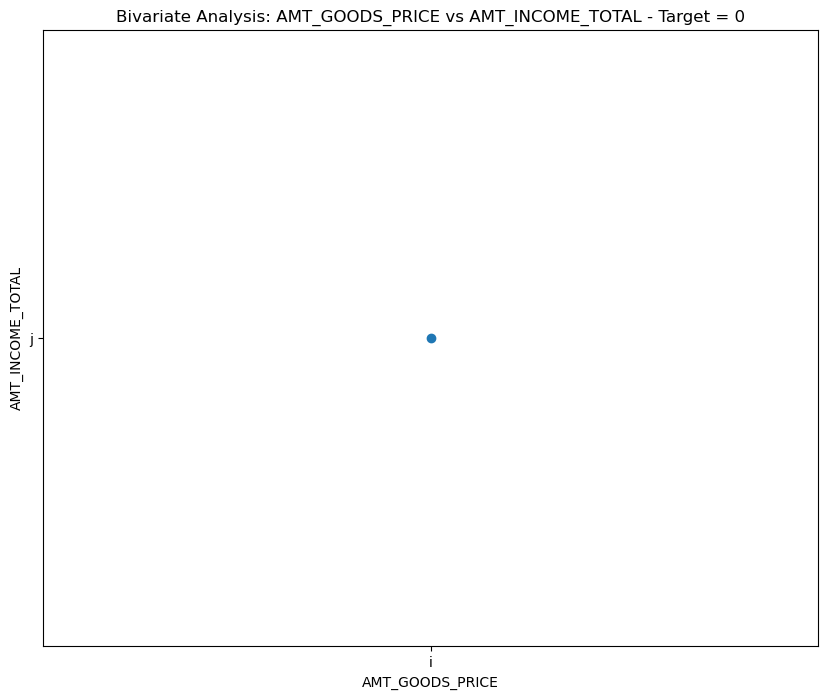

...

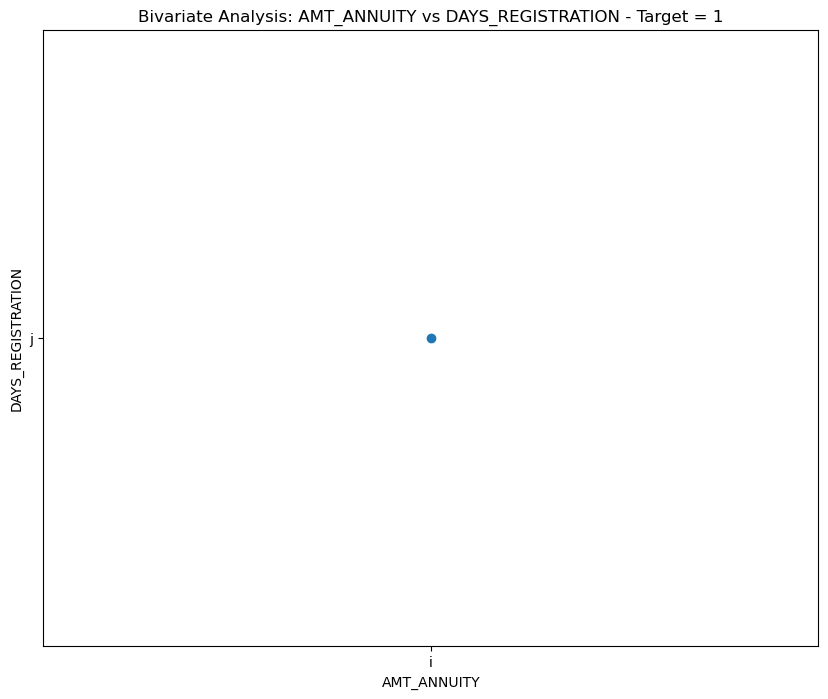

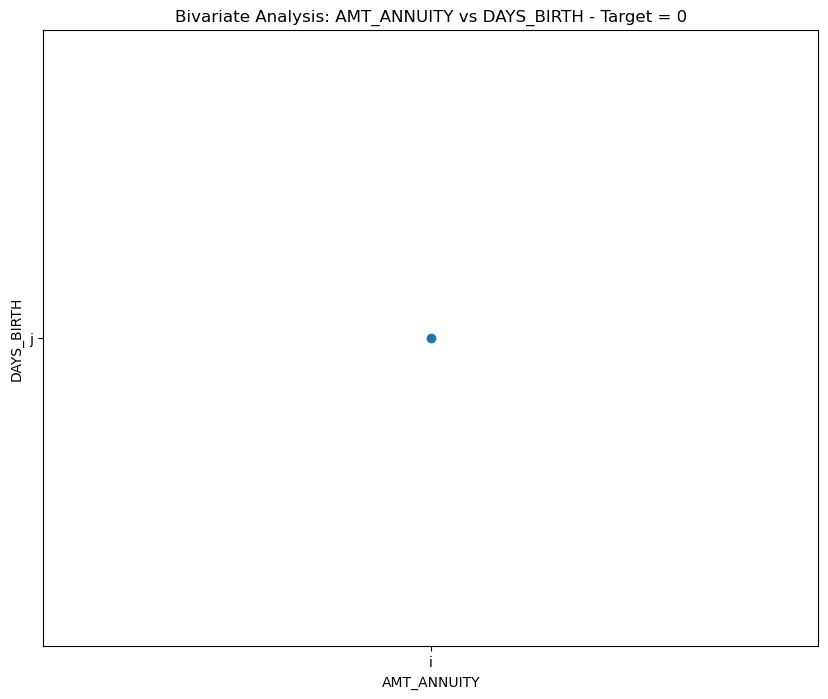

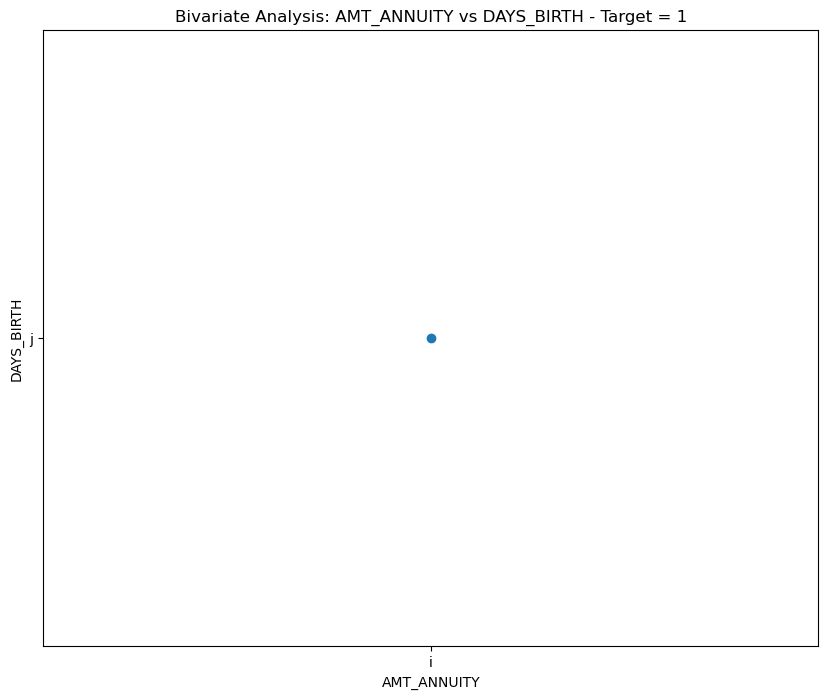

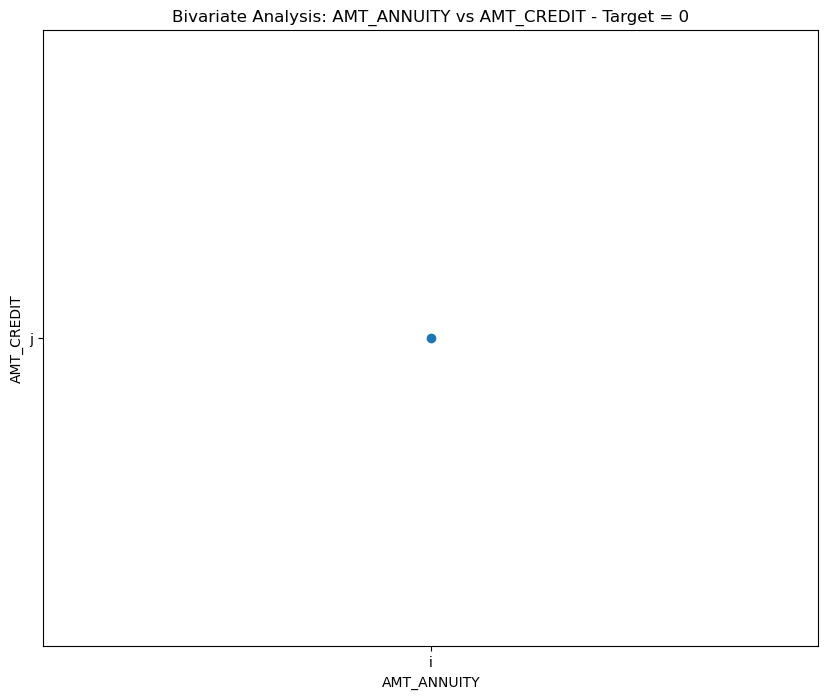

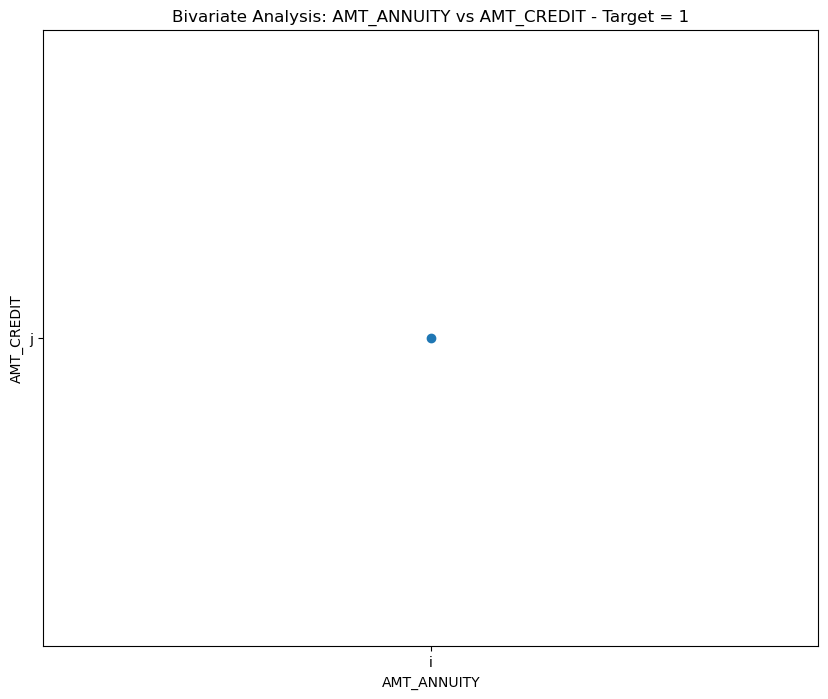

In [423]:
for i in numerical_columns:
    for j in numerical_columns:
        if i != j:  # to avoid plotting a variable against itself
            plt.figure(figsize=(10,8))
            plt.scatter(x='i', y='j', data=target_0)
            plt.title(f'Bivariate Analysis: {i} vs {j} - Target = 0')
            plt.xlabel(i)
            plt.ylabel(j)
            plt.show()

            plt.figure(figsize=(10,8))
            plt.scatter(x='i', y='j', data=target_1)
            plt.title(f'Bivariate Analysis: {i} vs {j} - Target = 1')
            plt.xlabel(i)
            plt.ylabel(j)
            plt.show()

# **6.Correlation analysis**

## *6.1 correlation analysis for the entire Target data*

#correlation analysis for the entire Target data
plt.figure(figsize=(20,10))
#Check the data types of numerical_columns
print(application_data[numerical_columns].dtypes)

#Convert columns to numeric type if necessary
for col in numerical_columns:
  if application_data[col].dtype == 'object':
    try:
      application_data[col] = pd.to_numeric(application_data[col], errors='coerce')
    except ValueError:
      print(f"Could not convert column '{col}' to numeric type.")

sns.heatmap(application_data[numerical_columns].corr(),annot=True)
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values
plt.yticks(rotation = 0)
plt.show()

## *6.2 Correlation of non-defaulters with numerical columns*

#correlation analysis for Target = 0
plt.figure(figsize=(20,10))
#Check the data types of numerical_columns in target_0
print(target_0[numerical_columns].dtypes)

#Convert columns to numeric type if necessary
for col in numerical_columns:
  if target_0[col].dtype == 'object':
    try:
      target_0[col] = pd.to_numeric(target_0[col], errors='coerce')
    except ValueError:
      print(f"Could not convert column '{col}' to numeric type.")

sns.heatmap(target_0[numerical_columns].corr(),annot=True)
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values
plt.yticks(rotation = 0)
plt.show()

## *6.3 Correlation of clients with payment difficulties*

#correlation analysis for target =1
plt.figure(figsize=(20,10))
print(target_1[numerical_columns].dtypes)

#Convert columns to numeric type if necessary
for col in numerical_columns:
  if target_1[col].dtype == 'object':
    try:
      target_1[col] = pd.to_numeric(target_1[col], errors='coerce')
    except ValueError:
      print(f"Could not convert column '{col}' to numeric type.")

sns.heatmap(target_1[numerical_columns].corr(),annot=True)
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values
plt.yticks(rotation = 0)
plt.show()

This analysis is conducted to understand if top 10 high correlation variables are common across for both data - target =0 and target =1

In [426]:
# Correlation for numerical columns for Target = 1
corr = target_1.select_dtypes(include=np.number).corr() # Select only numerical columns for correlation calculation

corr = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool)) # Use bool instead of np.bool
corrdf0 = corr.unstack().reset_index()
corrdf0.columns = ['Dimension1', 'Dimension2', 'Correlation']
corrdf0.dropna(subset = ['Correlation'], inplace = True)
corrdf0['Correlation'] = round(corrdf0['Correlation'], 2)
# Since we see correlation as an absolute value, we are converting it into absolute value
corrdf0['Correlation_abs'] = corrdf0['Correlation'].abs()
corrdf0.sort_values(by = 'Correlation_abs', ascending = False).head(10)

,Dimension1,Dimension2,Correlation,Correlation_abs
88,AMT_GOODS_PRICE,AMT_CREDIT,0.98,0.98
179,REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,0.96,0.96
74,AMT_ANNUITY,AMT_CREDIT,0.75,0.75
89,AMT_GOODS_PRICE,AMT_ANNUITY,0.75,0.75
119,DAYS_EMPLOYED,DAYS_BIRTH,-0.58,0.58
133,DAYS_REGISTRATION,DAYS_BIRTH,0.29,0.29
100,DAYS_BIRTH,CNT_CHILDREN,0.26,0.26
147,DAYS_ID_PUBLISH,DAYS_BIRTH,0.25,0.25
148,DAYS_ID_PUBLISH,DAYS_EMPLOYED,-0.23,0.23
134,DAYS_REGISTRATION,DAYS_EMPLOYED,-0.19,0.19


In [427]:
corr = target_0.select_dtypes(include=np.number).corr() # Select only numerical columns for correlation calculation
corr = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool)) # Use bool instead of np.bool
corrdf0 = corr.unstack().reset_index()
corrdf0.columns = ['Dimension1', 'Dimension2', 'Correlation']
corrdf0.dropna(subset = ['Correlation'], inplace = True)
corrdf0['Correlation'] = round(corrdf0['Correlation'], 2)
# Since we see correlation as an absolute value, we are converting it into absolute value
corrdf0['Correlation_abs'] = corrdf0['Correlation'].abs()
corrdf0.sort_values(by = 'Correlation_abs', ascending = False).head(10)

,Dimension1,Dimension2,Correlation,Correlation_abs
88,AMT_GOODS_PRICE,AMT_CREDIT,0.99,0.99
179,REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,0.95,0.95
89,AMT_GOODS_PRICE,AMT_ANNUITY,0.78,0.78
74,AMT_ANNUITY,AMT_CREDIT,0.77,0.77
119,DAYS_EMPLOYED,DAYS_BIRTH,-0.62,0.62
73,AMT_ANNUITY,AMT_INCOME_TOTAL,0.42,0.42
87,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,0.35,0.35
59,AMT_CREDIT,AMT_INCOME_TOTAL,0.34,0.34
100,DAYS_BIRTH,CNT_CHILDREN,0.34,0.34
133,DAYS_REGISTRATION,DAYS_BIRTH,0.33,0.33
